# Long Notebook
**Group members 35 *(Barbie)*: Lucy HARRAR (105836), Marijan SORIC (104941)**

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import seaborn as sns

%matplotlib inline

pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 200)

# Table of content

1.   How we handled the data :
     *   How we import the data
     *   EDA
     *   Preprocessing of the data
     *   How to choose the training set
     *   Post processing the predictions

2.   What models we tried :
     *   One regression model
     *   Deep learning models
     *   AutoML models
     *   Manual stack of multiple regression models


# Data Import

In [ ]:
# We import the data : the training set, the testing set and the target variable
X_train_estimated_a = pd.read_parquet('A/X_train_estimated.parquet')
X_train_observed_a = pd.read_parquet('A/X_train_observed.parquet')
X_test_estimated_a = pd.read_parquet('A/X_test_estimated.parquet')
train_a = pd.read_parquet('A/train_targets.parquet')

X_train_estimated_b = pd.read_parquet('B/X_train_estimated.parquet')
X_train_observed_b = pd.read_parquet('B/X_train_observed.parquet')
X_test_estimated_b = pd.read_parquet('B/X_test_estimated.parquet')
train_b = pd.read_parquet('B/train_targets.parquet')

X_train_estimated_c = pd.read_parquet('C/X_train_estimated.parquet')
X_train_observed_c = pd.read_parquet('C/X_train_observed.parquet')
X_test_estimated_c = pd.read_parquet('C/X_test_estimated.parquet')
train_c = pd.read_parquet('C/train_targets.parquet')

In [ ]:
# We set the dates as the indexes to facilitate the understanding of the data
X_train_estimated_a.set_index('date_forecast', inplace = True)
X_train_observed_a.set_index('date_forecast', inplace = True)
X_test_estimated_a.set_index('date_forecast', inplace = True)

X_train_estimated_b.set_index('date_forecast', inplace = True)
X_train_observed_b.set_index('date_forecast', inplace = True)
X_test_estimated_b.set_index('date_forecast', inplace = True)

X_train_estimated_c.set_index('date_forecast', inplace = True)
X_train_observed_c.set_index('date_forecast', inplace = True)
X_test_estimated_c.set_index('date_forecast', inplace = True)

# We get rid of the date_calc feature that is not relevant
X_train_estimated_a.drop('date_calc', axis=1, inplace=True)
X_test_estimated_a.drop('date_calc', axis=1, inplace=True)

X_train_estimated_b.drop('date_calc', axis=1, inplace=True)
X_test_estimated_b.drop('date_calc', axis=1, inplace=True)

X_train_estimated_c.drop('date_calc', axis=1, inplace=True)
X_test_estimated_c.drop('date_calc', axis=1, inplace=True)


train_a.set_index('time', inplace = True)
train_b.set_index('time', inplace = True)
train_c.set_index('time', inplace = True)

train_a.dropna(inplace = True)
train_b.dropna(inplace = True)
train_c.dropna(inplace = True)

# EDA

## The target variable

The first important thing to notice in the dataset is that the target variable pv_measurement contains a lot of zeros, which is completely normal considering that there is no solar production at night. The range of value of $y$ depends on the station. In the station A, $y$ reaches 6 000W, whereas for B and C it is around 1 000W. Since the score metric is MAE $\frac{1}{n}\sum_{i=1}^n \vert y_i - \hat{y}_i \vert$, the station A will be more important in the score.

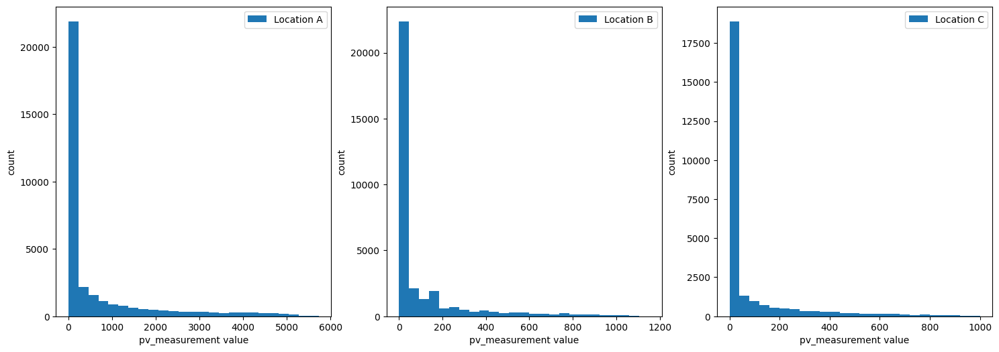

In [ ]:
# Check the distribution of pv_measurement
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))
ax1.hist(train_a, bins = 25, label = 'Location A')
ax1.set_xlabel("pv_measurement value")
ax1.set_ylabel("count")
ax1.legend()

ax2.hist(train_b, bins = 25, label = 'Location B')
ax2.set_xlabel("pv_measurement value")
ax2.set_ylabel("count")
ax2.legend()

ax3.hist(train_c, bins = 25, label = 'Location C')
ax3.set_xlabel("pv_measurement value")
ax3.set_ylabel("count")
ax3.legend()
plt.show()

## The other features distribution

### Location A

We notice that a lot of features also have imbalanced distributions, with many low values. This could be an indication that these particular features are very correlated to the target variable.

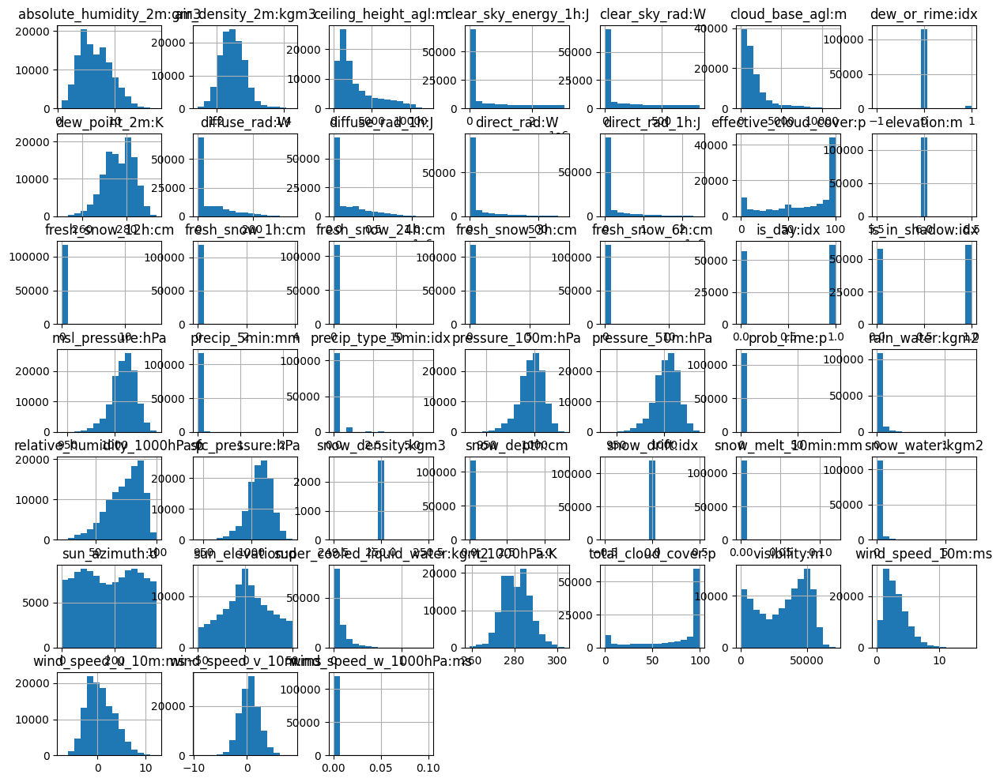

In [ ]:
# Check the distribution of all the features
X_train_observed_a.hist(figsize=(15,12),bins = 15)
plt.title("Features Distribution")
plt.show()

We also don't notice a huge difference between the distribution of the observed and estimated dataset

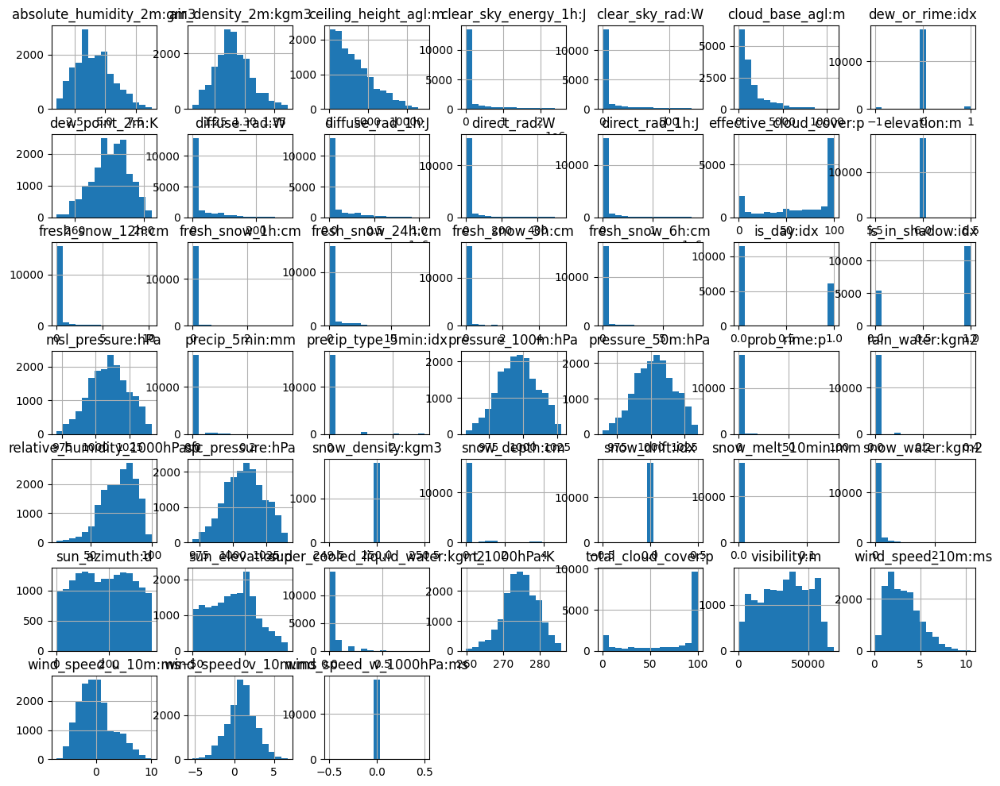

In [ ]:
# Check the distribution of all the features
X_train_estimated_a.hist(figsize=(15,12),bins = 15)
plt.title("Features Distribution")
plt.show()

Same observations for locations A, B and C

### Location B

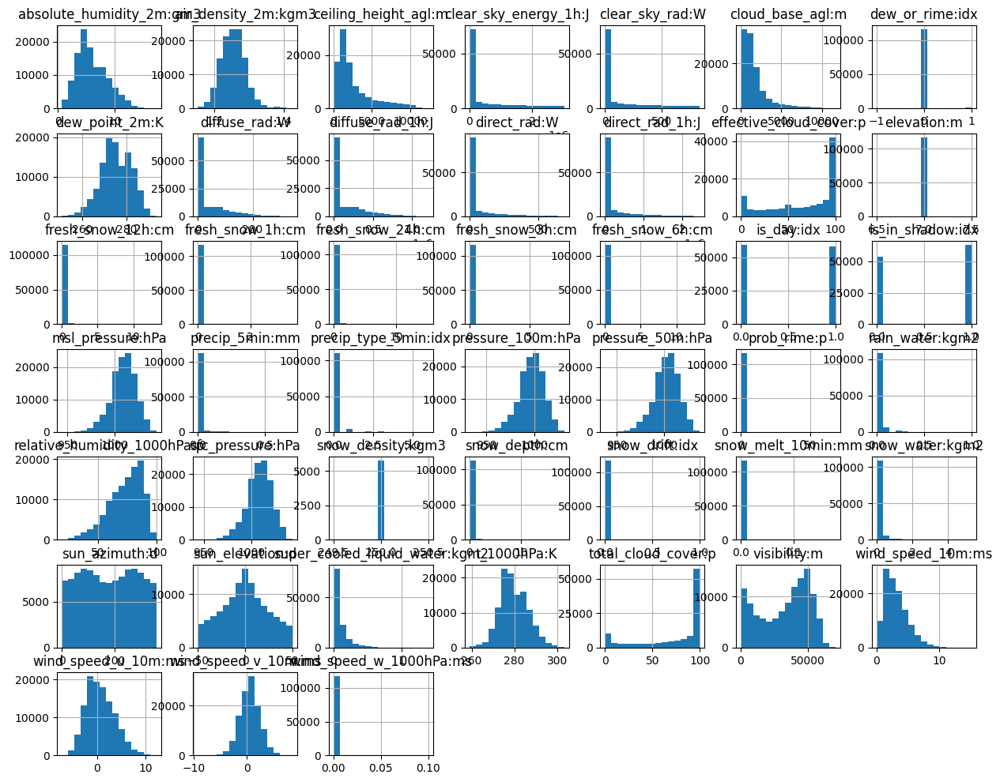

In [ ]:
# Check the distribution of all the features
X_train_observed_b.hist(figsize=(15,12),bins = 15)
plt.title("Features Distribution")
plt.show()

### Location C

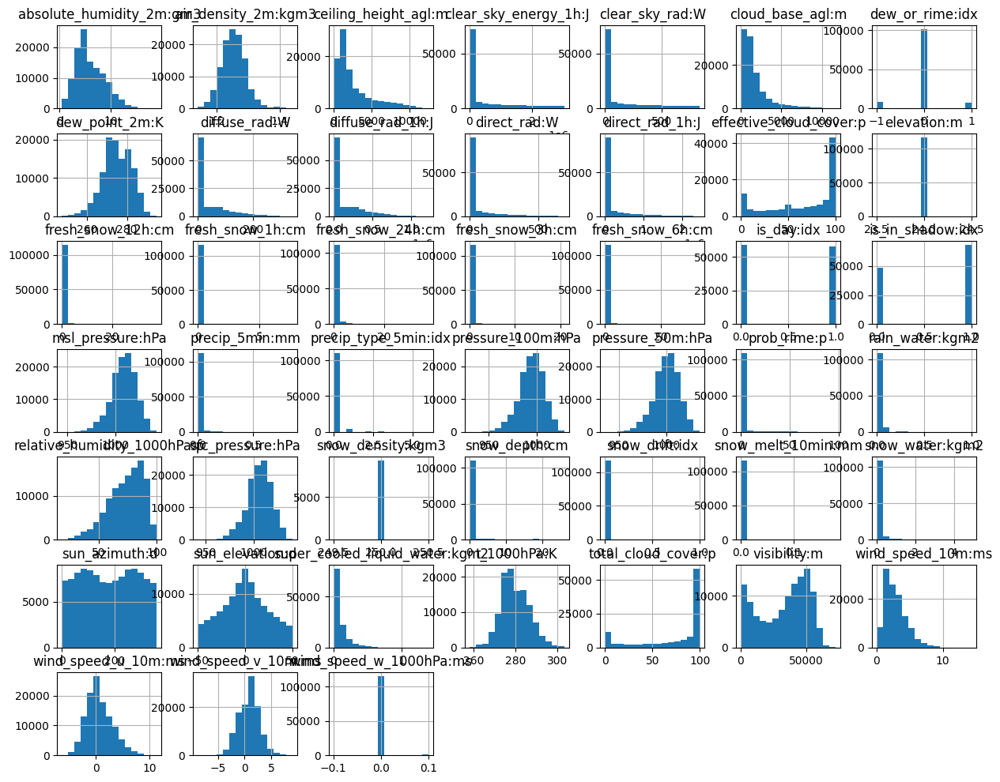

In [ ]:
# Check the distribution of all the features
X_train_observed_c.hist(figsize=(15,12),bins = 15)
plt.title("Features Distribution")
plt.show()

## Pairs of features

We notice that some features that have similar names, have a very clear correlation between them. Here, we can see the important correlation between `clear_sky_rad:W` and `clear_sky_energy_1h:J`.

<Figure size 300x700 with 0 Axes>

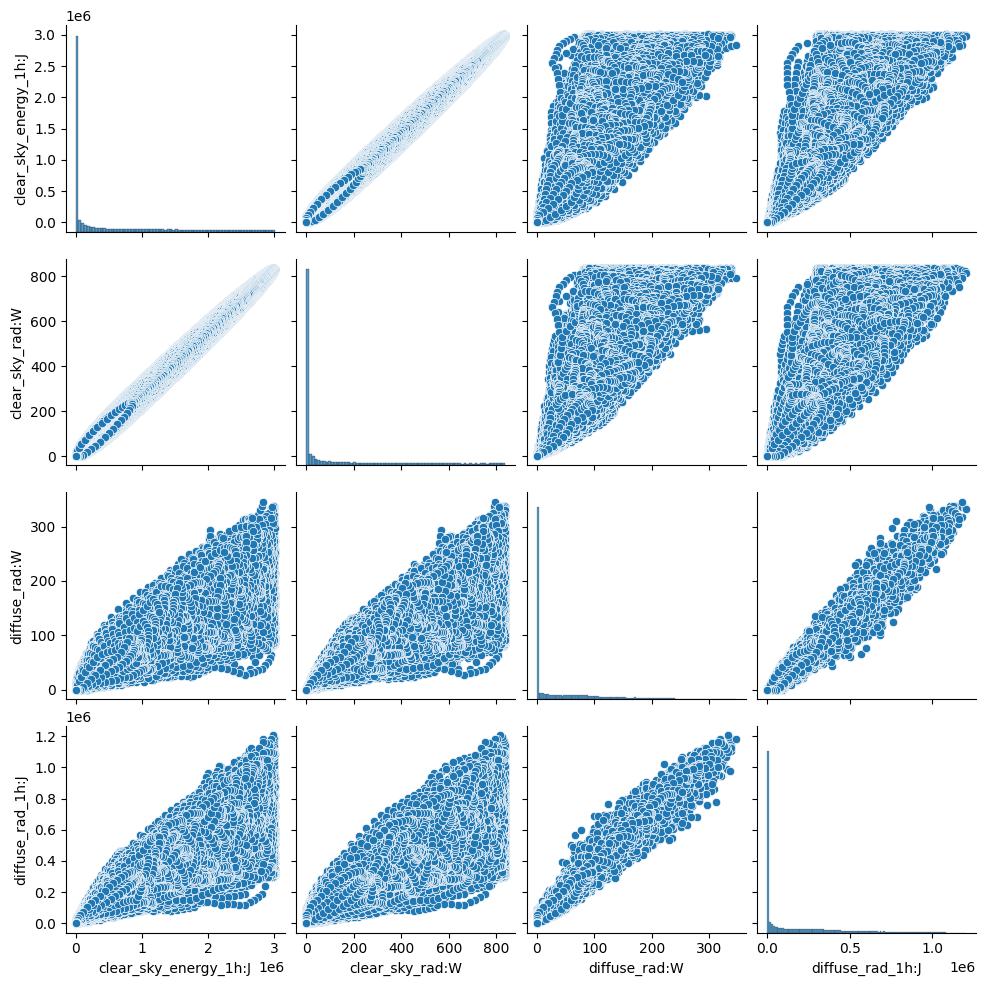

In [ ]:
columns = ['clear_sky_energy_1h:J', 'clear_sky_rad:W', 'diffuse_rad:W', 'diffuse_rad_1h:J']
plt.figure(figsize = (3, 7))
sns.pairplot(data = X_train_observed_a[columns])
plt.show()

That is why we considered for our first models, removing  for each pair of very correlated values, the ones with a very high correlation between them.
More particularly, we used the correlation matrix:

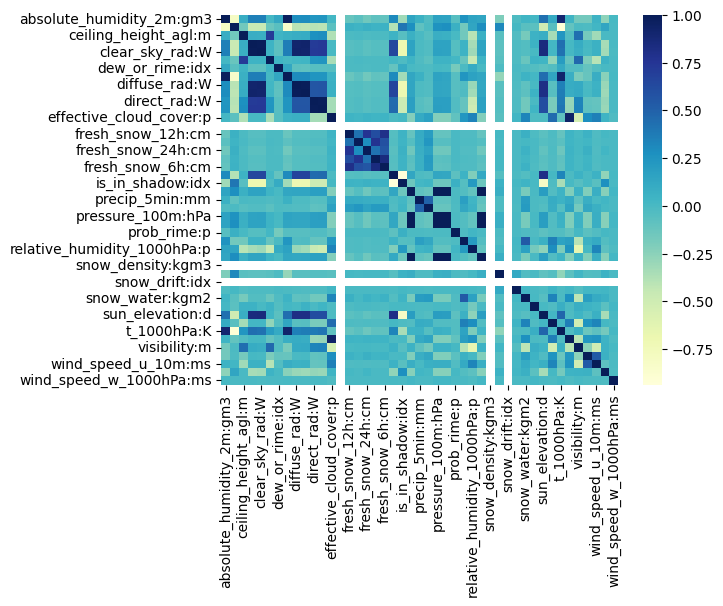

In [ ]:
dataplot = sns.heatmap(X_train_observed_a.corr(), cmap="YlGnBu")

Once again, we can see the important correlation between features that relate to the same thing. For instance, `direct_rad:W` and `diffuse_rad:W` are very correlated together, and the same goes for `fresh_snow_12h:cm`,  `fresh_snow_24h:cm` and  `fresh_snow_6h:cm`.

We can also see on the correlation matrix that the `sun_elevation:d` feature has a high correlation with many features. It will probably be an important feature in the future.

We can also have a more specific view of the pairs of features that have a high correlation with each other.

For observed :

In [ ]:
matrix_corr = X_train_observed_a.corr()
correlated_variables = {}
for key_1 in X_train_observed_a.keys():
    for key_2 in X_train_observed_a.keys():
        if  abs(matrix_corr[key_1][key_2]) > 0.9 and abs(matrix_corr[key_1][key_2]) != 1:
            correlated_variables[(key_1, key_2)] = matrix_corr[key_1][key_2]
print(correlated_variables)

{('absolute_humidity_2m:gm3', 'dew_point_2m:K'): 0.9748628282981654, ('absolute_humidity_2m:gm3', 't_1000hPa:K'): 0.9002974748440594, ('air_density_2m:kgm3', 't_1000hPa:K'): -0.9150702878469756, ('clear_sky_energy_1h:J', 'clear_sky_rad:W'): 0.9923317834232241, ('clear_sky_energy_1h:J', 'diffuse_rad:W'): 0.91117795571727, ('clear_sky_energy_1h:J', 'diffuse_rad_1h:J'): 0.9224118729786384, ('clear_sky_rad:W', 'clear_sky_energy_1h:J'): 0.9923317834232241, ('clear_sky_rad:W', 'diffuse_rad:W'): 0.9172217234699293, ('clear_sky_rad:W', 'diffuse_rad_1h:J'): 0.9147329793868023, ('dew_point_2m:K', 'absolute_humidity_2m:gm3'): 0.9748628282981654, ('dew_point_2m:K', 't_1000hPa:K'): 0.9168514528948866, ('diffuse_rad:W', 'clear_sky_energy_1h:J'): 0.91117795571727, ('diffuse_rad:W', 'clear_sky_rad:W'): 0.9172217234699293, ('diffuse_rad:W', 'diffuse_rad_1h:J'): 0.9869871153005173, ('diffuse_rad_1h:J', 'clear_sky_energy_1h:J'): 0.9224118729786384, ('diffuse_rad_1h:J', 'clear_sky_rad:W'): 0.9147329793868

And for estimated :

In [ ]:
matrix_corr = X_train_estimated_a.corr()
correlated_variables = {}
for key_1 in X_train_estimated_a.keys():
    for key_2 in X_train_estimated_a.keys():
        if  abs(matrix_corr[key_1][key_2]) > 0.9 and abs(matrix_corr[key_1][key_2]) != 1:
            correlated_variables[(key_1, key_2)] = matrix_corr[key_1][key_2]
print(correlated_variables)

{('absolute_humidity_2m:gm3', 'dew_point_2m:K'): 0.9825923925578672, ('clear_sky_energy_1h:J', 'clear_sky_rad:W'): 0.9905489999326903, ('clear_sky_energy_1h:J', 'diffuse_rad:W'): 0.9045849649349028, ('clear_sky_energy_1h:J', 'diffuse_rad_1h:J'): 0.9175394751229402, ('clear_sky_rad:W', 'clear_sky_energy_1h:J'): 0.9905489999326903, ('clear_sky_rad:W', 'diffuse_rad:W'): 0.9139565352014161, ('clear_sky_rad:W', 'diffuse_rad_1h:J'): 0.9096551329627153, ('dew_point_2m:K', 'absolute_humidity_2m:gm3'): 0.9825923925578672, ('dew_point_2m:K', 't_1000hPa:K'): 0.9002278702322717, ('diffuse_rad:W', 'clear_sky_energy_1h:J'): 0.9045849649349028, ('diffuse_rad:W', 'clear_sky_rad:W'): 0.9139565352014161, ('diffuse_rad:W', 'diffuse_rad_1h:J'): 0.9866227765332353, ('diffuse_rad_1h:J', 'clear_sky_energy_1h:J'): 0.9175394751229402, ('diffuse_rad_1h:J', 'clear_sky_rad:W'): 0.9096551329627153, ('diffuse_rad_1h:J', 'diffuse_rad:W'): 0.9866227765332353, ('direct_rad:W', 'direct_rad_1h:J'): 0.9875649117141303, (

We can check also the correlation between the features that we have noticed before in the correlation plot, and the pv_measurement :

In [ ]:
X_train_observed_a['sun_elevation:d'].corr(train_a.loc[X_train_observed_a.index].pv_measurement)

0.6957131963461992

In [ ]:
X_train_observed_a['direct_rad:W'].corr(train_a.loc[X_train_observed_a.index].pv_measurement)

0.8643341287385389

In [ ]:
X_train_observed_a['diffuse_rad:W'].corr(train_a.loc[X_train_observed_a.index].pv_measurement)

0.711395504536654

In [ ]:
X_train_observed_a['clear_sky_rad:W'].corr(train_a.loc[X_train_observed_a.index].pv_measurement)

0.8120473632258436

In [ ]:
X_train_observed_a['clear_sky_energy_1h:J'].corr(train_a.loc[X_train_observed_a.index].pv_measurement)

0.7994069240964949

In fact, we can compute a correlation plot, just between `X_train_observed_a` 's features and the pv_measurement :

In [ ]:
X_train_observed_a.corr()['pv_measurement'].shape

(46,)

In [ ]:
corr = pd.DataFrame(X_train_observed_a.corr()['pv_measurement'])

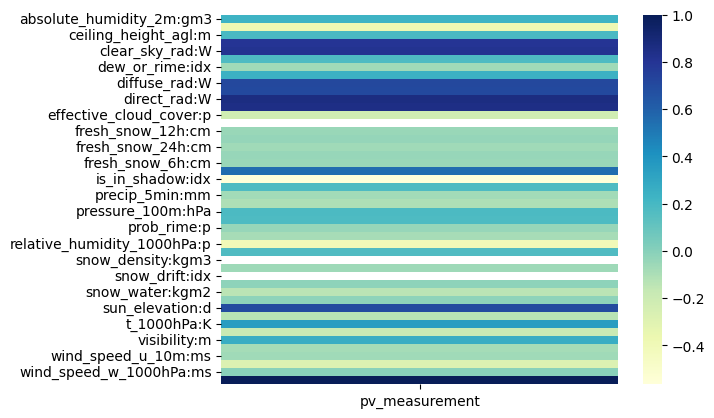

In [ ]:
dataplot = sns.heatmap(corr, cmap="YlGnBu")

As expected, they have a pretty important correlation with the pv_measurement. We will focus more on these features when preprocessing the data.




## Analysis of the target measurement


We take a closer look at the dataset to try and detect abnormal values in the pv_measurement

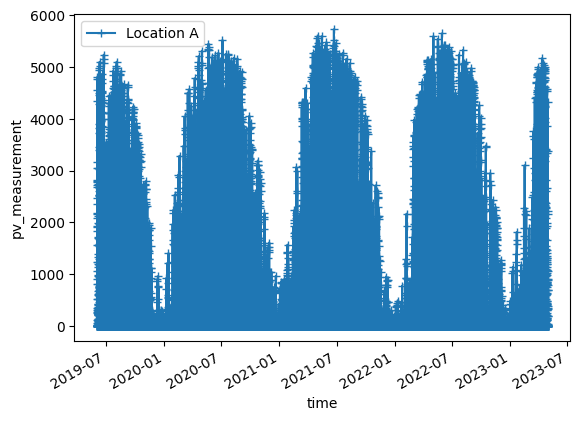

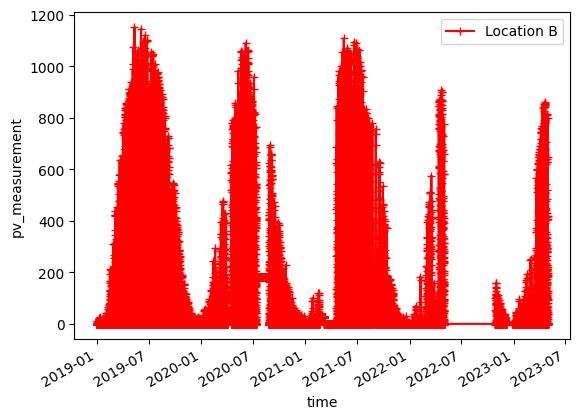

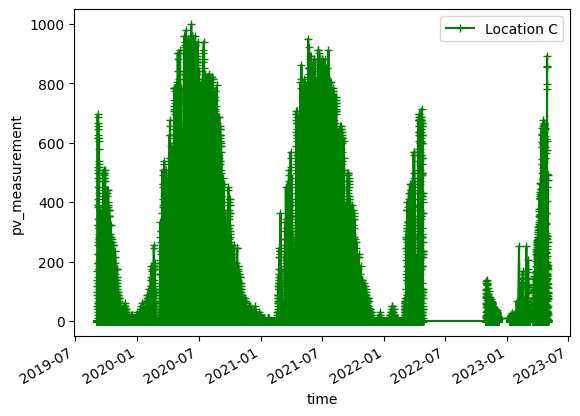

In [ ]:
plt.figure()
(train_a['pv_measurement']).plot(marker = '+', label = 'Location A')
plt.ylabel('pv_measurement')
plt.legend()

plt.figure()
train_b['pv_measurement'].plot(marker = '+', label = 'Location B', c = 'red')
plt.ylabel('pv_measurement')
plt.legend()

plt.figure()
train_c['pv_measurement'].plot(marker = '+', label = 'Location C', c = 'green')
plt.ylabel('pv_measurement')
plt.legend()

### Outliers

For location B we can visually see certain periods of time where the pv_measurement is constant.
We decided to take a closer look at the pv_measurement for each month and note down the periods of time where it remains constant:

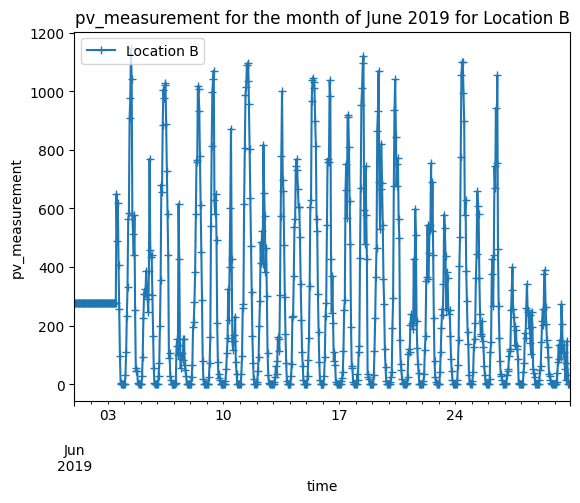

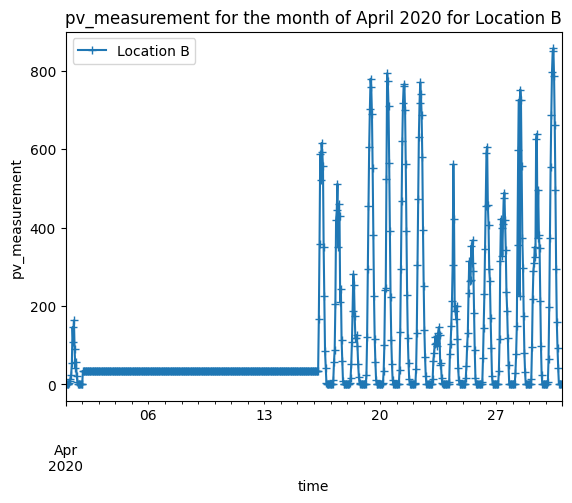

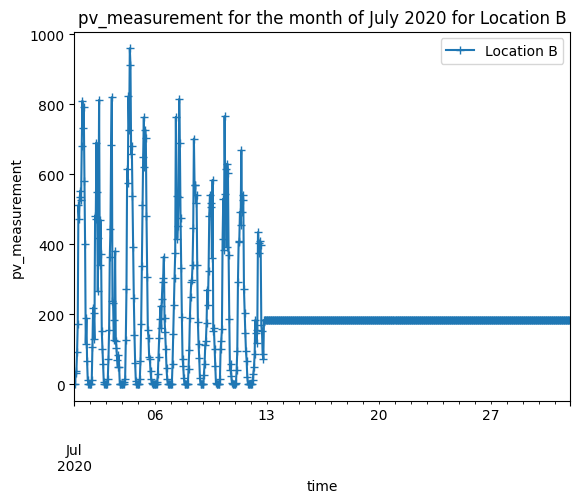

In [ ]:
plt.figure()
train_b['pv_measurement'].loc['2019-6'].plot(marker = '+', label = 'Location B')
plt.ylabel('pv_measurement')
plt.title('pv_measurement for the month of June 2019 for Location B')
plt.legend()

plt.figure()
train_b['pv_measurement'].loc['2020-4'].plot(marker = '+', label = 'Location B')
plt.ylabel('pv_measurement')
plt.title('pv_measurement for the month of April 2020 for Location B')
plt.legend()

plt.figure()
train_b['pv_measurement'].loc['2020-7'].plot(marker = '+', label = 'Location B')
plt.ylabel('pv_measurement')
plt.title('pv_measurement for the month of July 2020 for Location B')
plt.legend()

... And so on for the other months.

In the end, we managed to select the following periods of time with unusual constant values :

In [ ]:
# We collect the indexes of the periods of time with constant pv_measurements
# in 2019:
B19 = train_b.loc['2019-6-1':'2019-6-2'].index

# in 2020:
b20_1 = train_b.loc['2020-4-2':'2020-4-15'].index
b20_2 = train_b.loc['2020-7-13':'2020-8-25'].index
B20 = b20_1.union(b20_2)

# in 2021:
b21_1 = train_b.loc['2021-2-18':'2021-4-18'].index
b21_2 = train_b.loc['2021-4-30':'2021-5-1'].index
b21_3 = train_b.loc['2021-6-5':'2021-6-6'].index
b21_4 = train_b.loc['2021-6-13':'2021-6-13'].index
b21_5 = train_b.loc['2021-6-23':'2021-6-23'].index
b21_6 = train_b.loc['2021-7-4':'2021-7-5'].index
b21_7 = train_b.loc['2021-8-26':'2021-9-3'].index
b21_8 = train_b.loc['2021-9-10':'2021-9-13'].index
b21_9 = train_b.loc['2021-9-21':'2021-9-26'].index
B21 = b21_1.union(b21_2).union(b21_3).union(b21_4).union(b21_5).union(b21_6).union(b21_7).union(b21_8).union(b21_9)

# in 2022:
B22 = train_b.loc['2022-3-20':'2022-4-4'].index

# in total :
B_index_drop = B19.union(B20).union(B21).union(B22)

We decided to simply drop those values instead of imputing them, considering the length of some periods of unusual values.

In [ ]:
# Drop the unusual values
train_b = train_b[train_b.index.isin(B_index_drop)==False]

In [ ]:
# We need to match again the lengths of the training set with the target variable train_b, that we've just changed.
new_index_b = train_b.index

intersection_index_estimated_b = X_train_estimated_b.index.intersection(train_b.index)
intersection_index_observed_b = X_train_observed_b.index.intersection(train_b.index)

X_train_estimated_b = X_train_estimated_b.loc[new_index_b.intersection(X_train_estimated_b.index)]
X_train_observed_b = X_train_observed_b.loc[new_index_b.intersection(X_train_observed_b.index)]

train_b_estimated = train_b.loc[X_train_estimated_b.index]
train_b_observed = train_b.loc[X_train_observed_b.index]

In [ ]:
# We add the pv_measurement to the training dataset
X_train_observed_a = pd.concat([X_train_observed_a, train_a_observed], axis = 1)
X_train_estimated_a = pd.concat([X_train_estimated_a, train_a_estimated], axis = 1)

X_train_observed_b = pd.concat([X_train_observed_b, train_b_observed], axis = 1)
X_train_estimated_b = pd.concat([X_train_estimated_b, train_b_estimated], axis = 1)

X_train_observed_c = pd.concat([X_train_observed_c, train_c_observed], axis = 1)
X_train_estimated_c = pd.concat([X_train_estimated_c, train_c_estimated], axis = 1)

In [ ]:
# We concatenate the observed and estimated training dataset
X_train_a = pd.concat([X_train_observed_a, X_train_estimated_a], axis = 0)
X_train_b = pd.concat([X_train_observed_b, X_train_estimated_b], axis = 0)
X_train_c = pd.concat([X_train_observed_c, X_train_estimated_c], axis = 0)

We also noticed a strong correlation between the sun elevation and the pv_measurement : When the sun elevation is negative or null, the pv_measurement should be zero or very close to zero.

However, we clearly notice other strange values for b, that should be null but that are high and constant. Therefore, we probably missed some outliers to delete in B.

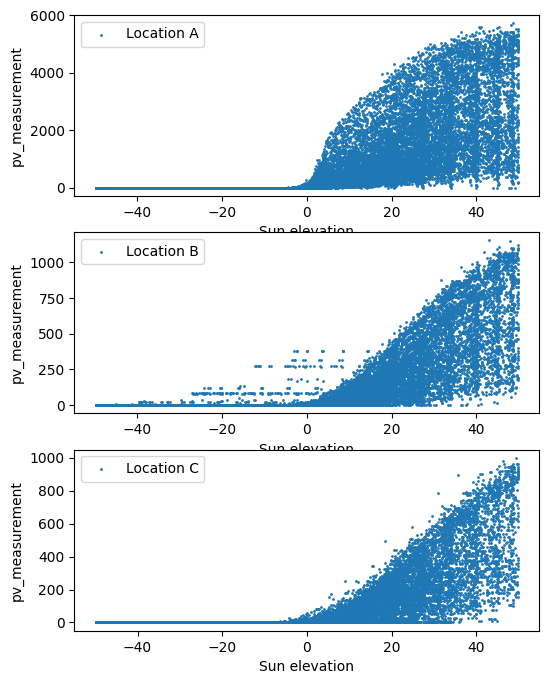

In [ ]:
# Plot of the pv_measurement against the sun_elevation for each location
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(6, 8))
ax1.scatter(X_train_a['sun_elevation:d'], X_train_a['pv_measurement'], s = 1, label = 'Location A')
ax1.set_xlabel('Sun elevation')
ax1.set_ylabel('pv_measurement')
ax1.legend()

ax2.scatter(X_train_b['sun_elevation:d'], X_train_b['pv_measurement'], s = 1, label = 'Location B')
ax2.set_xlabel('Sun elevation')
ax2.set_ylabel('pv_measurement')
ax2.legend()

ax3.scatter(X_train_c['sun_elevation:d'], X_train_c['pv_measurement'], s = 1, label = 'Location C')
ax3.set_xlabel('Sun elevation')
ax3.set_ylabel('pv_measurement')
ax3.legend()

The first step is to delete the data when the pv_measurement is not null when it is night time. They are colored here in orange.

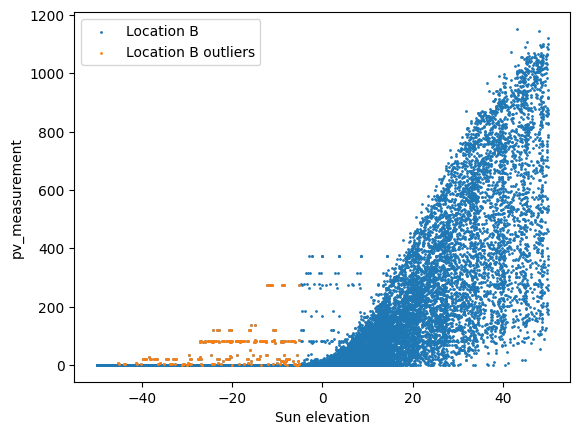

In [ ]:
plt.scatter(X_train_b['sun_elevation:d'], X_train_b['pv_measurement'], s = 1, label = 'Location B')
plt.scatter(X_train_b[(X_train_b['sun_elevation:d']< -5) & (X_train_b['pv_measurement'] >0)]['sun_elevation:d'], X_train_b[(X_train_b['sun_elevation:d']< -5) & (X_train_b['pv_measurement'] >0)].pv_measurement, s = 1, label = 'Location B outliers')
plt.xlabel('Sun elevation')
plt.ylabel('pv_measurement')
plt.legend()

In [ ]:
X_train_b.drop(X_train_b[(X_train_b['sun_elevation:d']< -5) & (X_train_b['pv_measurement'] >0)].index, inplace=True)

The next step is to delete those that aren't following the distribution (in comparison with station A and C). We delete those data points also.

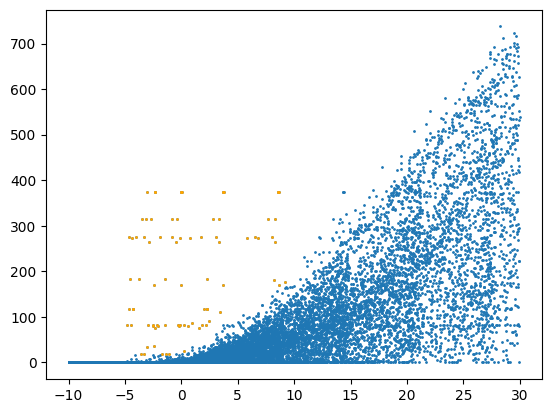

In [ ]:
date = (X_train_b['sun_elevation:d']>-5)& (X_train_b['sun_elevation:d']<10)
mask = (X_train_b[date]['pv_measurement']> X_train_b[date]['sun_elevation:d']*17+20)&(X_train_b[date]['pv_measurement']>X_train_b[date]['sun_elevation:d']+20)
cond = (X_train_b['sun_elevation:d']>-10)& (X_train_b['sun_elevation:d']<30)

plt.scatter(X_train_b[cond]['sun_elevation:d'], X_train_b[cond]['pv_measurement'], s=1)
plt.scatter(X_train_b[cond & mask]['sun_elevation:d'], X_train_b[cond & mask]['pv_measurement'], s=1, color='orange')

In [ ]:
out_b = X_train_b[cond & mask].index
X_train_b.drop(out_b, inplace=True)

We also noticed (after many submissions !) that there were also abnormal values in C. To spot them, we plotted the standart deviation of the pv_measurement daily. If the pv_measurement remained completely constant throughout the whole day (ie if the standart deviation is 0), then we remove the unusual values.

<Axes: >

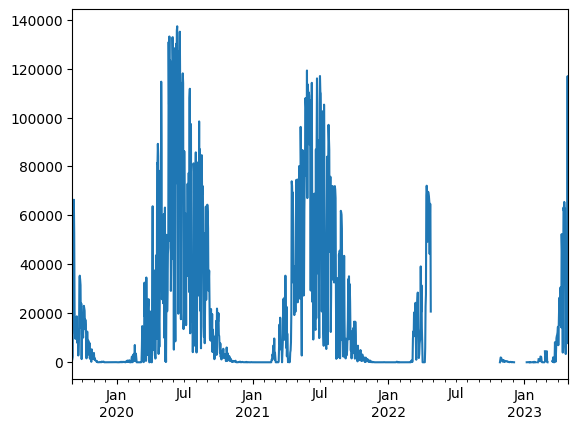

In [ ]:
X_train_c.pv_measurement.resample('D').var().plot()

By comparing with location A, we can see that those very long periods of time with no variance in the pv_measurement are abnormal.

<Axes: >

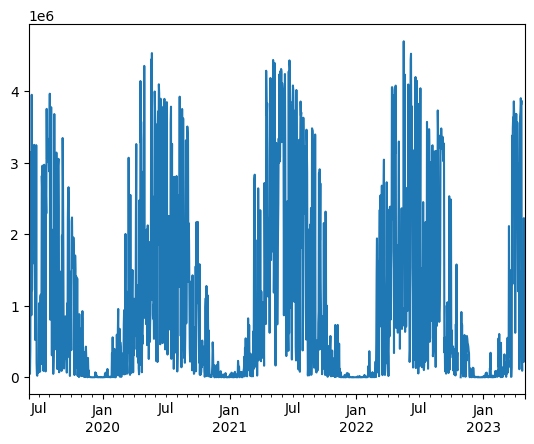

In [ ]:
X_train_a.pv_measurement.resample('D').var().plot()

Therefore, we removed them !

In [ ]:
old = X_train_c.resample('D').var()[X_train_c.pv_measurement.resample('D').var()==0.].pv_measurement.index

hourly_dates = []
for date in old:
    hourly_values = pd.date_range(start=date, periods=24, freq='H')
    hourly_dates.extend(hourly_values)

c_index_drop = set(np.array(hourly_dates))& set(X_train_c.index)
X_train_c[X_train_c.index.isin(c_index_drop)==False]

X_train_c = X_train_c[X_train_c.index.isin(c_index_drop)==False]

### Is the data intuitive ?

We can check how the pv_measurement is affected by several physical features. We can easily guess that the ones with the most effect on pv_measurement will be related the sun radiation, or the lack of sun.

We can see that the pv_measurement level is very linked to the level of direct_rad most of the time. However, we can see that it is not the only feature that seems to have an important influence on the pv_measurement : on June 4th, we can see that the level of direct_rad is relatively low, but the pv_measurement remains high...

Other features definitely play an important part in those unusual days, like those related to clouds for instance...

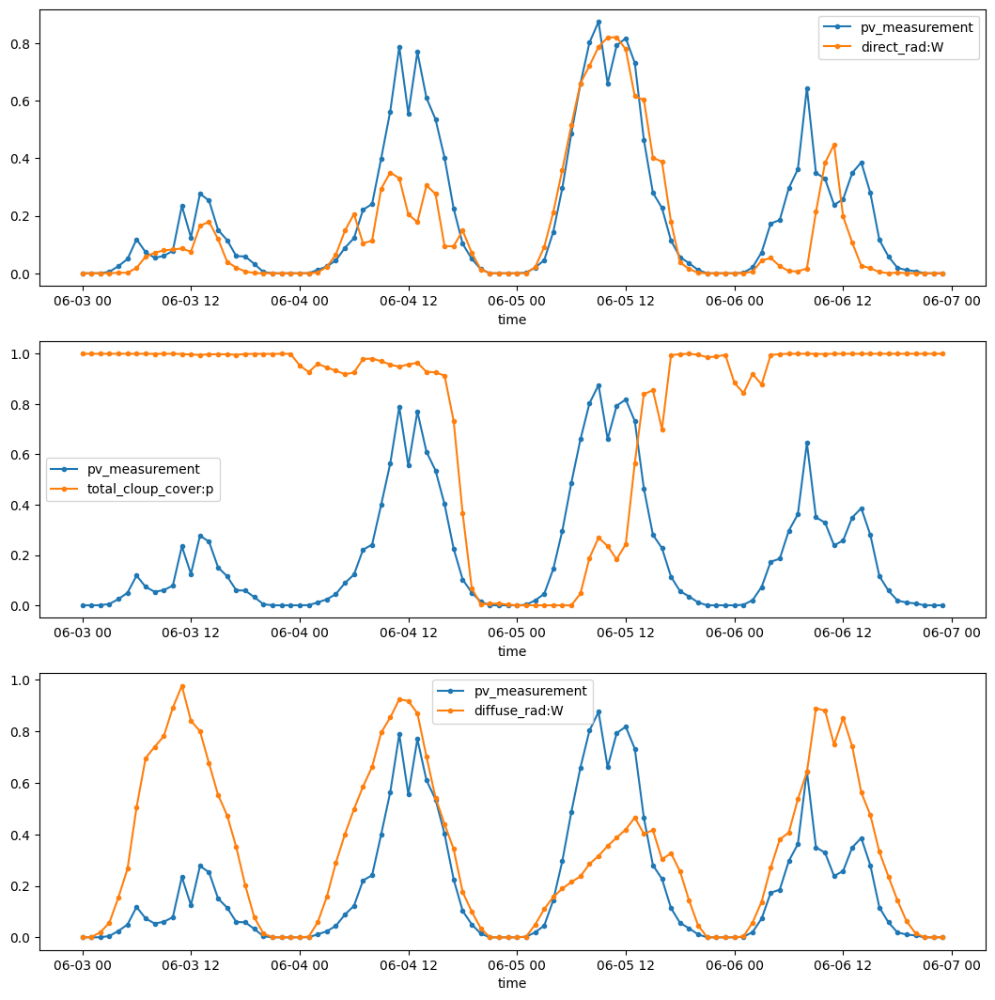

In [ ]:
train_a_normalized = train_a.copy()
train_a_normalized['pv_measurement'] = train_a_normalized['pv_measurement'] / max(train_a_normalized['pv_measurement'])
direct_rad_normalized = X_train_observed_a['direct_rad:W'] / max(X_train_observed_a['direct_rad:W'])
diffuse_rad_normalized = X_train_observed_a['diffuse_rad:W'] / max(X_train_observed_a['diffuse_rad:W'])
total_cloud_cover_normalized = X_train_observed_a['total_cloud_cover:p'] / max(X_train_observed_a['total_cloud_cover:p'])
ceiling_height_agl_normalized = X_train_observed_a['ceiling_height_agl:m'] / max(X_train_observed_a['ceiling_height_agl:m'])


fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(13, 13))
ax1.plot(train_a_normalized['2020-6-3':'2020-6-6'].index, train_a_normalized['2020-6-3':'2020-6-6'].pv_measurement, marker = '.', label = 'pv_measurement')
ax1.plot(direct_rad_normalized['2020-6-3':'2020-6-6'].index, direct_rad_normalized['2020-6-3':'2020-6-6'].values, marker = '.', label = 'direct_rad:W')
ax1.set_xlabel('time')
ax1.legend()

ax2.plot(train_a_normalized['2020-6-3':'2020-6-6'].index, train_a_normalized['2020-6-3':'2020-6-6'].pv_measurement, marker = '.', label = 'pv_measurement')
ax2.plot(total_cloud_cover_normalized['2020-6-3':'2020-6-6'].index, total_cloud_cover_normalized['2020-6-3':'2020-6-6'].values, marker = '.', label = 'total_cloup_cover:p')
ax2.set_xlabel('time')
ax2.legend()

ax3.plot(train_a_normalized['2020-6-3':'2020-6-6'].index, train_a_normalized['2020-6-3':'2020-6-6'].pv_measurement, marker = '.', label = 'pv_measurement')
ax3.plot(diffuse_rad_normalized['2020-6-3':'2020-6-6'].index, diffuse_rad_normalized['2020-6-3':'2020-6-6'].values, marker = '.', label = 'diffuse_rad:W')
ax3.set_xlabel('time')
ax3.legend()

## Difference between estimated and observed features

The dataset is divided between some observed and estimated features. One thing that we wanted to explore, was how different those features were, and how those differences could impact the model.

Therefore, we tried to compare the distributions between the observed and estimated features to try and quantify those differences.

In [ ]:
A_index19 = X_train_observed_a.loc['2019-05-01 00:00:00':'2019-07-03 23:45:00'].index
A_index20 = X_train_observed_a.loc['2020-05-01 00:00:00':'2020-07-03 23:45:00'].index
A_index21 = X_train_observed_a.loc['2021-05-01 00:00:00':'2021-07-03 23:45:00'].index
A_index22 = X_train_observed_a.loc['2022-05-01 00:00:00':'2022-07-03 23:45:00'].index

B_index19 = X_train_observed_b.loc['2019-05-01 00:00:00':'2019-07-03 23:45:00'].index
B_index20 = X_train_observed_b.loc['2020-05-01 00:00:00':'2020-07-03 23:45:00'].index
B_index21 = X_train_observed_b.loc['2021-05-01 00:00:00':'2021-07-03 23:45:00'].index
#B_index22 = X_train_observed_b.loc['2022-05-01 00:00:00':'2022-07-03 23:45:00'].index

#C_index19 = X_train_observed_c.loc['2019-05-01 00:00:00':'2019-07-03 23:45:00'].index
C_index20 = X_train_observed_c.loc['2020-05-01 00:00:00':'2020-07-03 23:45:00'].index
C_index21 = X_train_observed_c.loc['2021-05-01 00:00:00':'2021-07-03 23:45:00'].index
#C_index22 = X_train_observed_c.loc['2022-05-01 00:00:00':'2022-07-03 23:45:00'].index

In [ ]:
A_index_spring = A_index20.union(A_index21).union(A_index22)
B_index_spring = B_index19.union(B_index20).union(B_index21)#.union(B_index22)
C_index_spring = C_index20.union(C_index21) #C_index19.union(C_index20).union(C_index21).union(C_index22)

In [ ]:
X_train_observed_a_spring = X_train_observed_a.loc[A_index_spring]
X_train_observed_b_spring = X_train_observed_b.loc[B_index_spring]
X_train_observed_c_spring = X_train_observed_c.loc[C_index_spring]

Here, we plotted the distributions of the estimated and observed features together :

MEAN  X_obs_spring 7.835991859436035       X_test_shift 8.205903053283691
VAR X_obs_spring 5.240535736083984       X_test_shift 4.745533466339111


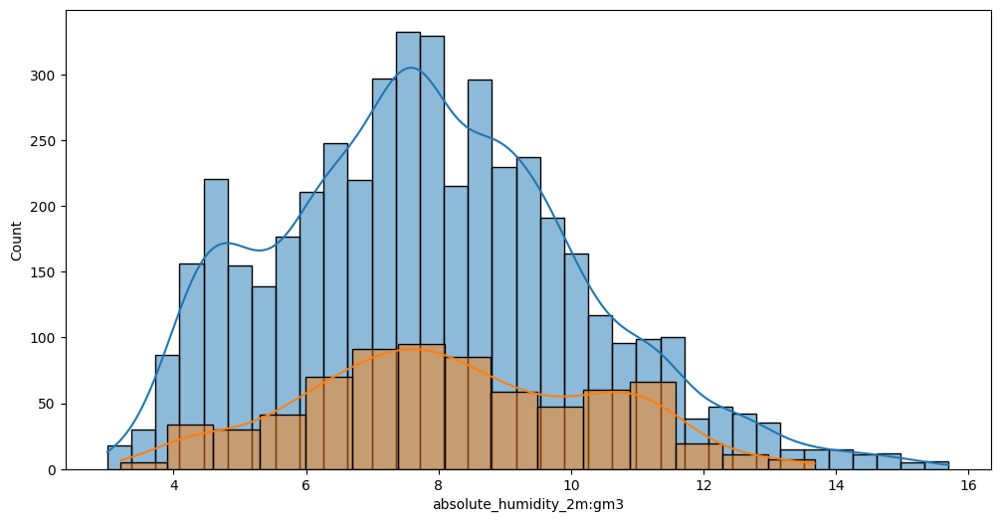

In [ ]:
i = 0

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))

sns.histplot(data=X_train_observed_a_spring.iloc[:,i], kde=True)
sns.histplot(data=X_test_estimated_a.iloc[:,i], kde=True)

print(f'MEAN  X_obs_spring {X_train_observed_a_spring.iloc[:,i].mean()} \
      X_test_shift {X_test_estimated_a.iloc[:,i].mean()}')

print(f'VAR X_obs_spring {X_train_observed_a_spring.iloc[:,i].var()} \
      X_test_shift {X_test_estimated_a.iloc[:,i].var()}')

We now have two options :

*   Try to transform the estimated data, to turn them into "observed" data
*   Keep the estimated data the way it is. It is a possibility because as we saw before, the variance and the mean of the estimated and observed data, on a similar time period as the test data, are very close. We could therefore make the assumption that estimated = observed.

We ended up trying both options.

For the first option, in particular, we wrote a function to match both distributions, based on the following reasoning :

If we considere the large set of data point, denoted $(X_i)_{1 \le i \le N}$ as independant, then the Centrale Theorem Limit states that:
$$ \cfrac{\sum_{i=1}^N X_i - \mu}{\frac{\sigma}{\sqrt{N}}}  \xrightarrow{\mathcal{L}} X   \sim \mathcal{N}(0,1)$$

This means that when we look at the distribution (the histogram) of a feature, it should be normally distributed $\sim \mathcal{N}(\mu, \sigma^2)$.

Our assumption is the following: the estimated data is biaised, and the distribution should be corrected in order to fit as much as possible the observed one. This is the purpose of the function ```shift```. Nevertheless, we should not consider the distribution over the whole year for the observed data, but rather on the same period (months) as train_estimated ans test_estimated.

Let $(X_e)$ be a estimated data point, $X_e \sim \mathcal{N}(\mu_e,\sigma_e^2)$. And the observed data point for the same period time  $X_o \sim \mathcal{N}(\mu_o,\sigma_o^2)$.

We transform $X_e^{new} ← \mu_e+\frac{X_e-\mu_e}{\sigma_e}\sigma_o$.






In [ ]:
def shift(X_obs, X_est):
    mu_obs, sd_obs = X_obs.mean(), np.sqrt(X_obs.var())
    mu_est, sd_est = X_est.mean(), np.sqrt(X_est.var())
    if sd_est>0:
        X_est = (X_est - mu_est) / sd_est
        X_est = (X_est * sd_obs) + mu_obs
        return X_est
    else:
        return X_est

MEAN  X_obs_spring 7.835991859436035       X_test_shift 7.835991859436035
VAR X_obs_spring 5.240535736083984       X_test_shift 5.240534782409668


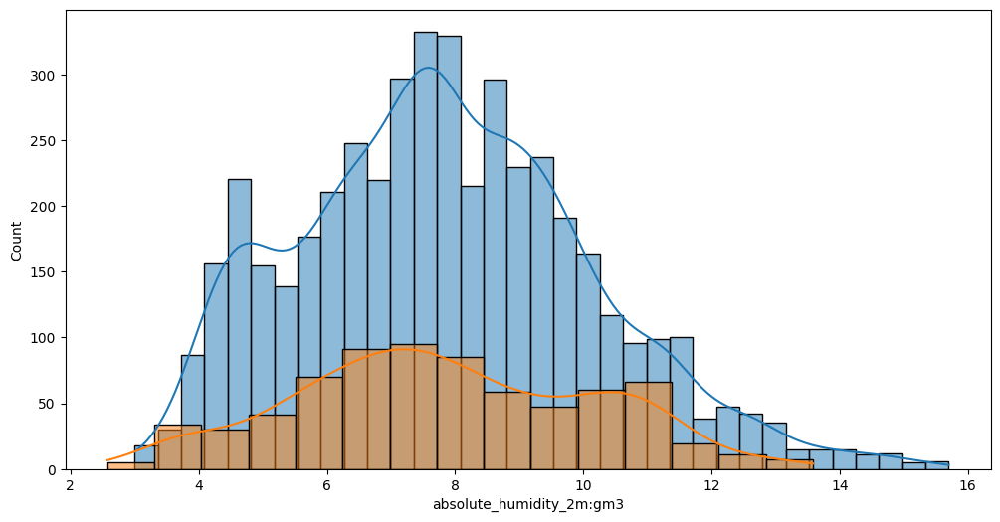

In [ ]:
i = 0

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))

sns.histplot(data=X_train_observed_a_spring.iloc[:,i], kde=True)
sns.histplot(data=shift(X_train_observed_a_spring.iloc[:,i], X_test_estimated_a.iloc[:,i]), kde=True)

print(f'MEAN  X_obs_spring {X_train_observed_a_spring.iloc[:,i].mean()} \
      X_test_shift {shift(X_train_observed_a_spring.iloc[:,i], X_test_estimated_a.iloc[:,i]).mean()}')

print(f'VAR X_obs_spring {X_train_observed_a_spring.iloc[:,i].var()} \
      X_test_shift {shift(X_train_observed_a_spring.iloc[:,i], X_test_estimated_a.iloc[:,i]).var()}')

We can see that with this function, both estimated and observed distributions have the same mean and variance.

Unfortunatly, this idea didn't improve our score. We decided to forget about this idea, and instead add a new feature to take into account the difference between observed and estimated data points. We will discuss it in the section *Preprocessing the data>Feature engineering>Other new feature*.

# Preprocessing the data

## Resampling the dataset

The training and testing set do not have the same sampling as the target variable. We have one pv_measurement per hour, but one measurement per 15 minutes for the weather features...
We had multiple ideas for that :


1.   Simply averaging the weather features for a whole hour
2.   Use other functions such as minimum or maximum, standart deviation etc. instead of averaging the  values.
3.   Make 4 different models, one with the first values from the hour, one with the values from every quarter of an hour, one with the values from every half an hour, and one with the values from every quarter to an hour. Then we average the predictions together in the end.




In [ ]:
# We distinguish here the categorical features, to make sure that the values remain integers even after the mean
feature_idx = ['dew_or_rime:idx','is_day:idx','is_in_shadow:idx','precip_type_5min:idx','snow_drift:idx']
for feature in feature_idx:
    X_train_observed_a[feature] = X_train_observed_a[feature].resample('H').mean().round()
    X_train_observed_b[feature] = X_train_observed_b[feature].resample('H').mean().round()
    X_train_observed_c[feature] = X_train_observed_c[feature].resample('H').mean().round()

    X_train_estimated_a[feature] = X_train_estimated_a[feature].resample('H').mean().round()
    X_train_estimated_b[feature] = X_train_estimated_b[feature].resample('H').mean().round()
    X_train_estimated_c[feature] = X_train_estimated_c[feature].resample('H').mean().round()

    X_test_estimated_a[feature] = X_test_estimated_a[feature].resample('H').mean().round()
    X_test_estimated_b[feature] = X_test_estimated_b[feature].resample('H').mean().round()
    X_test_estimated_c[feature] = X_test_estimated_c[feature].resample('H').mean().round()

In [ ]:
# We simply average the non-categorical features
features_no_idx = X_train_observed_a.columns[X_train_observed_a.columns.isin(feature_idx)==False].tolist()
for feature in features_no_idx:
    X_train_observed_a[feature] = X_train_observed_a[feature].resample('H').mean()
    X_train_observed_b[feature] = X_train_observed_b[feature].resample('H').mean()
    X_train_observed_c[feature] = X_train_observed_c[feature].resample('H').mean()

    X_train_estimated_a[feature] = X_train_estimated_a[feature].resample('H').mean()
    X_train_estimated_b[feature] = X_train_estimated_b[feature].resample('H').mean()
    X_train_estimated_c[feature] = X_train_estimated_c[feature].resample('H').mean()

    X_test_estimated_a[feature] = X_test_estimated_a[feature].resample('H').mean()
    X_test_estimated_b[feature] = X_test_estimated_b[feature].resample('H').mean()
    X_test_estimated_c[feature] = X_test_estimated_c[feature].resample('H').mean()

In [ ]:
# We select the first value of each hour, which corresponds to the averages we calculated before
X_train_estimated_a = X_train_estimated_a.loc[X_train_estimated_a.index[::4]]
X_train_observed_a = X_train_observed_a.loc[X_train_observed_a.index[::4]]
X_test_estimated_a = X_test_estimated_a.loc[X_test_estimated_a.index[::4]]

X_train_estimated_b = X_train_estimated_b.loc[X_train_estimated_b.index[::4]]
X_train_observed_b = X_train_observed_b.loc[X_train_observed_b.index[::4]]
X_test_estimated_b = X_test_estimated_b.loc[X_test_estimated_b.index[::4]]

X_train_estimated_c = X_train_estimated_c.loc[X_train_estimated_c.index[::4]]
X_train_observed_c = X_train_observed_c.loc[X_train_observed_c.index[::4]]
X_test_estimated_c = X_test_estimated_c.loc[X_test_estimated_c.index[::4]]

# We match the dates between the training dataset and the target variables (some hours were missing between the training set and the target measurements)
intersection_index_estimated_a = X_train_estimated_a.index.intersection(train_a.index)
intersection_index_estimated_b = X_train_estimated_b.index.intersection(train_b.index)
intersection_index_estimated_c = X_train_estimated_c.index.intersection(train_c.index)

intersection_index_observed_a = X_train_observed_a.index.intersection(train_a.index)
intersection_index_observed_b = X_train_observed_b.index.intersection(train_b.index)
intersection_index_observed_c = X_train_observed_c.index.intersection(train_c.index)

X_train_estimated_a = X_train_estimated_a.loc[intersection_index_estimated_a]
X_train_estimated_b = X_train_estimated_b.loc[intersection_index_estimated_b]
X_train_estimated_c = X_train_estimated_c.loc[intersection_index_estimated_c]

X_train_observed_a = X_train_observed_a.loc[intersection_index_observed_a]
X_train_observed_b = X_train_observed_b.loc[intersection_index_observed_b]
X_train_observed_c = X_train_observed_c.loc[intersection_index_observed_c]

train_a_estimated = train_a.loc[intersection_index_estimated_a]
train_b_estimated = train_b.loc[intersection_index_estimated_b]
train_c_estimated = train_c.loc[intersection_index_estimated_c]

train_a_observed = train_a.loc[intersection_index_observed_a]
train_b_observed = train_b.loc[intersection_index_observed_b]
train_c_observed = train_c.loc[intersection_index_observed_c]

## Missing Values

We only dealt with the missing values from ```ceiling_height_agl:m``` and ```cloud_base_agl:m``` and not ```snow_density:kgm3``` (it is dropped by most of the models on their own).

We explored multiple things for the missing values. We tried :

*   **Replacing** the missing values from ```ceiling_height_agl:m``` with the mean of the feature, and -999 for the missing values of ```cloud_base_agl:m``` (with the assumption that a missing value in ```cloud_base_agl:m``` means that there is no cloud)
*   Simply **dropping them** all. The problem is that there is a lot of missing values and we lose a lot of points in the dataset... We didn't have good results like that.
*   Doing a **rolling mean** : we replace the missing value with the mean on a 24h window, of the feature. For the missing values that do not have access to a 24h measurement or less, of the feature, we replace the missing value with the value from one of the previous years, if possible. If not (which was quite rare), we drop them.




In [ ]:
X_train_c.isna().sum()

absolute_humidity_2m:gm3              0
air_density_2m:kgm3                   0
ceiling_height_agl:m               5134
clear_sky_energy_1h:J                 0
clear_sky_rad:W                       0
cloud_base_agl:m                   2204
dew_or_rime:idx                       0
dew_point_2m:K                        0
diffuse_rad:W                         0
diffuse_rad_1h:J                      0
direct_rad:W                          0
direct_rad_1h:J                       0
effective_cloud_cover:p               0
elevation:m                           0
fresh_snow_12h:cm                     0
fresh_snow_1h:cm                      0
fresh_snow_24h:cm                     0
fresh_snow_3h:cm                      0
fresh_snow_6h:cm                      0
is_day:idx                            0
is_in_shadow:idx                      0
msl_pressure:hPa                      0
precip_5min:mm                        0
precip_type_5min:idx                  0
pressure_100m:hPa                     0


In [ ]:
#rolling mean + we replace by the other years otherwise
window_size = 24
for df in [X_train_a, X_test_estimated_a,\
          X_train_b, X_test_estimated_b,\
          X_train_c, X_test_estimated_c]:

    for feature in ['ceiling_height_agl:m', 'cloud_base_agl:m'] :
        df[feature] = df[feature].fillna(df[feature].rolling(window=window_size, min_periods=1).mean())

        for date in df[df[feature].isna() == True].index:
            replaced = False

            date_2019 = date.replace(year = 2019)
            date_2020 = date.replace(year = 2020)
            date_2021 = date.replace(year = 2021)

            if date_2019 in df.index :
                value_2019 = df[feature].loc[date.replace(year = 2019)]
                if np.isnan(np.array(value_2019)).any() == False:
                    df[feature].loc[date] = value_2019
                    replaced = True

            if date_2020 in df.index and replaced == False :
                value_2020 = df[feature].loc[date.replace(year = 2020)]
                if np.isnan(np.array(value_2020)).any() == False:
                    df[feature].loc[date] = value_2020
                    replaced = True

            if date_2021 in df.index and replaced == False :
                value_2021 = df[feature].loc[date.replace(year = 2021)]
                if np.isnan(np.array(value_2021)).any() == False:
                    df[feature].loc[date] = value_2021
                    replaced = True

<ipython-input-27-2d6daa3741b2>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[feature].loc[date] = value_2020
<ipython-input-27-2d6daa3741b2>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[feature].loc[date] = value_2021
<ipython-input-27-2d6daa3741b2>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[feature].loc[date] = value_2019


In [ ]:
#we drop the last remaining missing values
X_train_a.dropna(subset = ['ceiling_height_agl:m'], inplace = True)
X_train_b.dropna(subset = ['ceiling_height_agl:m'], inplace = True)
X_train_c.dropna(subset = ['ceiling_height_agl:m'], inplace = True)

In [ ]:
X_train_b.isna().sum()

absolute_humidity_2m:gm3              0
air_density_2m:kgm3                   0
ceiling_height_agl:m                  0
clear_sky_energy_1h:J                 0
clear_sky_rad:W                       0
cloud_base_agl:m                      0
dew_or_rime:idx                       0
dew_point_2m:K                        0
diffuse_rad:W                         0
diffuse_rad_1h:J                      0
direct_rad:W                          0
direct_rad_1h:J                       0
effective_cloud_cover:p               0
elevation:m                           0
fresh_snow_12h:cm                     0
fresh_snow_1h:cm                      0
fresh_snow_24h:cm                     0
fresh_snow_3h:cm                      0
fresh_snow_6h:cm                      0
is_day:idx                            0
is_in_shadow:idx                      0
msl_pressure:hPa                      0
precip_5min:mm                        0
precip_type_5min:idx                  0
pressure_100m:hPa                     0


## Feature engineering

We have 45 raw features in the data set. We tried to add new relevent features, so that the model could be more precise.

### Time related Feature Engineering

We decided to tackle this time series forecasting problem as a regression problem. For that matter, we needed to incorporate some features to describe the dependance of our features with the time.

Therefore, we added some time related features to incorporate the seasonality of the data into our dataset.
- $x_{T,cos}(t)=\cos \left(\frac{2 \pi }{T} t\right)$

Where $T$ is the period (the day or the year in seconds), and $t$ the current time in seconds. **We can also include the month period (or not)**

In [ ]:
#We change the Time that is a string, to a variable in seconds
timestamp_s_observed_a = X_train_observed_a.index.map(pd.Timestamp.timestamp)
timestamp_s_observed_b = X_train_observed_b.index.map(pd.Timestamp.timestamp)
timestamp_s_observed_c = X_train_observed_c.index.map(pd.Timestamp.timestamp)

timestamp_s_estimated_a = X_train_estimated_a.index.map(pd.Timestamp.timestamp)
timestamp_s_estimated_b = X_train_estimated_b.index.map(pd.Timestamp.timestamp)
timestamp_s_estimated_c = X_train_estimated_c.index.map(pd.Timestamp.timestamp)

timestamp_s_test_a = X_test_estimated_a.index.map(pd.Timestamp.timestamp)
timestamp_s_test_b = X_test_estimated_b.index.map(pd.Timestamp.timestamp)
timestamp_s_test_c = X_test_estimated_c.index.map(pd.Timestamp.timestamp)

#Then, we incorporate the periodicity with sinuses and cosinuses
day = 24*60*60
year = (365.2425)*day

X_train_observed_a['Day sin'] = np.sin(timestamp_s_observed_a * (2 * np.pi / day))
X_train_observed_a['Day cos'] = np.cos(timestamp_s_observed_a * (2 * np.pi / day))
X_train_observed_a['Year sin'] = np.sin(timestamp_s_observed_a * (2 * np.pi / year))
X_train_observed_a['Year cos'] = np.cos(timestamp_s_observed_a * (2 * np.pi / year))

X_train_observed_b['Day sin'] = np.sin(timestamp_s_observed_b * (2 * np.pi / day))
X_train_observed_b['Day cos'] = np.cos(timestamp_s_observed_b * (2 * np.pi / day))
X_train_observed_b['Year sin'] = np.sin(timestamp_s_observed_b * (2 * np.pi / year))
X_train_observed_b['Year cos'] = np.cos(timestamp_s_observed_b * (2 * np.pi / year))

X_train_observed_c['Day sin'] = np.sin(timestamp_s_observed_c * (2 * np.pi / day))
X_train_observed_c['Day cos'] = np.cos(timestamp_s_observed_c * (2 * np.pi / day))
X_train_observed_c['Year sin'] = np.sin(timestamp_s_observed_c * (2 * np.pi / year))
X_train_observed_c['Year cos'] = np.cos(timestamp_s_observed_c * (2 * np.pi / year))


X_train_estimated_a['Day sin'] = np.sin(timestamp_s_estimated_a * (2 * np.pi / day))
X_train_estimated_a['Day cos'] = np.cos(timestamp_s_estimated_a * (2 * np.pi / day))
X_train_estimated_a['Year sin'] = np.sin(timestamp_s_estimated_a * (2 * np.pi / year))
X_train_estimated_a['Year cos'] = np.cos(timestamp_s_estimated_a * (2 * np.pi / year))

X_train_estimated_b['Day sin'] = np.sin(timestamp_s_estimated_b * (2 * np.pi / day))
X_train_estimated_b['Day cos'] = np.cos(timestamp_s_estimated_b * (2 * np.pi / day))
X_train_estimated_b['Year sin'] = np.sin(timestamp_s_estimated_b * (2 * np.pi / year))
X_train_estimated_b['Year cos'] = np.cos(timestamp_s_estimated_b * (2 * np.pi / year))

X_train_estimated_c['Day sin'] = np.sin(timestamp_s_estimated_c * (2 * np.pi / day))
X_train_estimated_c['Day cos'] = np.cos(timestamp_s_estimated_c * (2 * np.pi / day))
X_train_estimated_c['Year sin'] = np.sin(timestamp_s_estimated_c * (2 * np.pi / year))
X_train_estimated_c['Year cos'] = np.cos(timestamp_s_estimated_c * (2 * np.pi / year))


X_test_estimated_a['Day sin'] = np.sin(timestamp_s_test_a * (2 * np.pi / day))
X_test_estimated_a['Day cos'] = np.cos(timestamp_s_test_a * (2 * np.pi / day))
X_test_estimated_a['Year sin'] = np.sin(timestamp_s_test_a * (2 * np.pi / year))
X_test_estimated_a['Year cos'] = np.cos(timestamp_s_test_a * (2 * np.pi / year))

X_test_estimated_b['Day sin'] = np.sin(timestamp_s_test_b * (2 * np.pi / day))
X_test_estimated_b['Day cos'] = np.cos(timestamp_s_test_b * (2 * np.pi / day))
X_test_estimated_b['Year sin'] = np.sin(timestamp_s_test_b * (2 * np.pi / year))
X_test_estimated_b['Year cos'] = np.cos(timestamp_s_test_b * (2 * np.pi / year))

X_test_estimated_c['Day sin'] = np.sin(timestamp_s_test_c * (2 * np.pi / day))
X_test_estimated_c['Day cos'] = np.cos(timestamp_s_test_c * (2 * np.pi / day))
X_test_estimated_c['Year sin'] = np.sin(timestamp_s_test_c * (2 * np.pi / year))
X_test_estimated_c['Year cos'] = np.cos(timestamp_s_test_c * (2 * np.pi / year))


### New physical features


After looking carefully at the data, we decided to add new features based on the raw features to catch more information that might be relevant for the regressor model. Basically, we tried to understand the physical meaning of each feature to create new ones usefull to predict the target pv_measurement.

Here are some features that we added :
- ```rad:W ``` is the sum of the direct and diffuse radiation (called total radiation)
- ```ratio_rad:W ``` is the ratio of the direct radiation and diffuse radiation
- ```rad_T:WK``` As the temperature might impact the solar energy production yield, we multiplied it by the total radiation.
- We might also consider $\Delta x$, the variation of a feature over an hour.




In [ ]:
X_train_a['rad:W'] = X_train_a[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]+x[1], axis=1)
X_train_b['rad:W'] = X_train_b[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]+x[1], axis=1)
X_train_c['rad:W'] = X_train_c[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]+x[1], axis=1)

X_test_estimated_a['rad:W'] = X_test_estimated_a[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]+x[1], axis=1)
X_test_estimated_b['rad:W'] = X_test_estimated_b[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]+x[1], axis=1)
X_test_estimated_c['rad:W'] = X_test_estimated_c[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]+x[1], axis=1)

In [ ]:
X_train_a['ratio_rad:W'] = X_train_a[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]/(x[0]+x[1]) if x[0]+x[1] !=0 else 0, axis=1)
X_train_b['ratio_rad:W'] = X_train_b[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]/(x[0]+x[1]) if x[0]+x[1] !=0 else 0, axis=1)
X_train_c['ratio_rad:W'] = X_train_c[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]/(x[0]+x[1]) if x[0]+x[1] !=0 else 0, axis=1)

X_test_estimated_a['ratio_rad:W'] = X_test_estimated_a[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]/(x[0]+x[1]) if x[0]+x[1] !=0 else 0, axis=1)
X_test_estimated_b['ratio_rad:W'] = X_test_estimated_b[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]/(x[0]+x[1]) if x[0]+x[1] !=0 else 0, axis=1)
X_test_estimated_c['ratio_rad:W'] = X_test_estimated_c[['direct_rad:W', 'diffuse_rad:W']].apply(lambda x: x[0]/(x[0]+x[1]) if x[0]+x[1] !=0 else 0, axis=1)

In [ ]:
X_train_a['rad_T:WK'] = X_train_a[['t_1000hPa:K', 'rad:W']].apply(lambda x: x[0]*x[1], axis=1)
X_train_b['rad_T:WK'] = X_train_b[['t_1000hPa:K', 'rad:W']].apply(lambda x: x[0]*x[1], axis=1)
X_train_c['rad_T:WK'] = X_train_c[['t_1000hPa:K', 'rad:W']].apply(lambda x: x[0]*x[1], axis=1)

X_test_estimated_a['rad_T:WK'] = X_test_estimated_a[['t_1000hPa:K', 'rad:W']].apply(lambda x: x[0]*x[1], axis=1)
X_test_estimated_b['rad_T:WK'] = X_test_estimated_b[['t_1000hPa:K', 'rad:W']].apply(lambda x: x[0]*x[1], axis=1)
X_test_estimated_c['rad_T:WK'] = X_test_estimated_c[['t_1000hPa:K', 'rad:W']].apply(lambda x: x[0]*x[1], axis=1)

### Polynomial features

Here we raised to the square some features according to their correlation with the target.

In [ ]:
# We choose some features to raise some features to the square
to_square = [ 'clear_sky_rad:W',
       'cloud_base_agl:m',
       'dew_point_2m:K',
       'diffuse_rad:W',
       'direct_rad:W',
       'effective_cloud_cover:p',
       'fresh_snow_6h:cm',
       'msl_pressure:hPa',
       'precip_5min:mm',
       'pressure_50m:hPa',
       'rain_water:kgm2',
       'sfc_pressure:hPa',
       't_1000hPa:K',
       'wind_speed_10m:ms']

In [ ]:
#We create the new features
for feature in to_square:
    X_train_a[f'{feature}^2'] = X_train_a[feature].apply(lambda x: x**2)
    X_train_b[f'{feature}^2'] = X_train_b[feature].apply(lambda x: x**2)
    X_train_c[f'{feature}^2'] = X_train_c[feature].apply(lambda x: x**2)

    X_test_estimated_a[f'{feature}^2'] = X_test_estimated_a[feature].apply(lambda x: x**2)
    X_test_estimated_b[f'{feature}^2'] = X_test_estimated_b[feature].apply(lambda x: x**2)
    X_test_estimated_c[f'{feature}^2'] = X_test_estimated_c[feature].apply(lambda x: x**2)

In [ ]:
X_train_a['air_density_2m:kgm3_rad:W'] = X_train_a['air_density_2m:kgm3'] * X_train_a['rad:W']
X_train_a['msl_pressure:hPa^2_rad:W'] = X_train_a['msl_pressure:hPa^2'] * X_train_a['rad:W']
X_train_a['sfc_pressure:hPa^2_rad:W'] = X_train_a['sfc_pressure:hPa^2'] * X_train_a['rad:W']
X_train_a['pressure_50m:hPa^2_rad:W'] = X_train_a['pressure_50m:hPa^2'] * X_train_a['rad:W']
X_train_a['msl_pressure:hPa_rad:W'] = X_train_a['msl_pressure:hPa'] * X_train_a['rad:W']
X_train_a['sfc_pressure:hPa_rad:W'] = X_train_a['sfc_pressure:hPa'] * X_train_a['rad:W']
X_train_a['pressure_50m:hPa_rad:W'] = X_train_a['pressure_50m:hPa'] * X_train_a['rad:W']
X_train_a['pressure_100m:hPa_rad:W'] = X_train_a['pressure_100m:hPa'] * X_train_a['rad:W']
X_train_a['air_density_2m:kgm3_rad_T:WK'] = X_train_a['air_density_2m:kgm3'] * X_train_a['rad_T:WK']
X_train_a['is_day:idx_rad:W'] = X_train_a['is_day:idx'] * X_train_a['rad:W']
X_train_a['total_cloud_cover:p_rad:W'] = X_train_a['total_cloud_cover:p'] * X_train_a['rad:W']

In [ ]:
X_train_b['air_density_2m:kgm3_rad:W'] = X_train_b['air_density_2m:kgm3'] * X_train_b['rad:W']
X_train_b['msl_pressure:hPa^2_rad:W'] = X_train_b['msl_pressure:hPa^2'] * X_train_b['rad:W']
X_train_b['sfc_pressure:hPa^2_rad:W'] = X_train_b['sfc_pressure:hPa^2'] * X_train_b['rad:W']
X_train_b['pressure_50m:hPa^2_rad:W'] = X_train_b['pressure_50m:hPa^2'] * X_train_b['rad:W']
X_train_b['msl_pressure:hPa_rad:W'] = X_train_b['msl_pressure:hPa'] * X_train_b['rad:W']
X_train_b['sfc_pressure:hPa_rad:W'] = X_train_b['sfc_pressure:hPa'] * X_train_b['rad:W']
X_train_b['pressure_50m:hPa_rad:W'] = X_train_b['pressure_50m:hPa'] * X_train_b['rad:W']
X_train_b['pressure_100m:hPa_rad:W'] = X_train_b['pressure_100m:hPa'] * X_train_b['rad:W']
X_train_b['air_density_2m:kgm3_rad_T:WK'] = X_train_b['air_density_2m:kgm3'] * X_train_b['rad_T:WK']
X_train_b['is_day:idx_rad:W'] = X_train_b['is_day:idx'] * X_train_b['rad:W']
X_train_b['total_cloud_cover:p_rad:W'] = X_train_b['total_cloud_cover:p'] * X_train_b['rad:W']

In [ ]:
X_train_c['air_density_2m:kgm3_rad:W'] = X_train_c['air_density_2m:kgm3'] * X_train_c['rad:W']
X_train_c['msl_pressure:hPa^2_rad:W'] = X_train_c['msl_pressure:hPa^2'] * X_train_c['rad:W']
X_train_c['sfc_pressure:hPa^2_rad:W'] = X_train_c['sfc_pressure:hPa^2'] * X_train_c['rad:W']
X_train_c['pressure_50m:hPa^2_rad:W'] = X_train_c['pressure_50m:hPa^2'] * X_train_c['rad:W']
X_train_c['msl_pressure:hPa_rad:W'] = X_train_c['msl_pressure:hPa'] * X_train_c['rad:W']
X_train_c['sfc_pressure:hPa_rad:W'] = X_train_c['sfc_pressure:hPa'] * X_train_c['rad:W']
X_train_c['pressure_50m:hPa_rad:W'] = X_train_c['pressure_50m:hPa'] * X_train_c['rad:W']
X_train_c['pressure_100m:hPa_rad:W'] = X_train_c['pressure_100m:hPa'] * X_train_c['rad:W']
X_train_c['air_density_2m:kgm3_rad_T:WK'] = X_train_c['air_density_2m:kgm3'] * X_train_c['rad_T:WK']
X_train_c['is_day:idx_rad:W'] = X_train_c['is_day:idx'] * X_train_c['rad:W']
X_train_c['total_cloud_cover:p_rad:W'] = X_train_c['total_cloud_cover:p'] * X_train_c['rad:W']

In [ ]:
X_test_estimated_a['air_density_2m:kgm3_rad:W'] = X_test_estimated_a['air_density_2m:kgm3'] * X_test_estimated_a['rad:W']
X_test_estimated_a['msl_pressure:hPa^2_rad:W'] = X_test_estimated_a['msl_pressure:hPa^2'] * X_test_estimated_a['rad:W']
X_test_estimated_a['sfc_pressure:hPa^2_rad:W'] = X_test_estimated_a['sfc_pressure:hPa^2'] * X_test_estimated_a['rad:W']
X_test_estimated_a['pressure_50m:hPa^2_rad:W'] = X_test_estimated_a['pressure_50m:hPa^2'] * X_test_estimated_a['rad:W']
X_test_estimated_a['msl_pressure:hPa_rad:W'] = X_test_estimated_a['msl_pressure:hPa'] * X_test_estimated_a['rad:W']
X_test_estimated_a['sfc_pressure:hPa_rad:W'] = X_test_estimated_a['sfc_pressure:hPa'] * X_test_estimated_a['rad:W']
X_test_estimated_a['pressure_50m:hPa_rad:W'] = X_test_estimated_a['pressure_50m:hPa'] * X_test_estimated_a['rad:W']
X_test_estimated_a['pressure_100m:hPa_rad:W'] = X_test_estimated_a['pressure_100m:hPa'] * X_test_estimated_a['rad:W']
X_test_estimated_a['air_density_2m:kgm3_rad_T:WK'] = X_test_estimated_a['air_density_2m:kgm3'] * X_test_estimated_a['rad_T:WK']
X_test_estimated_a['is_day:idx_rad:W'] = X_test_estimated_a['is_day:idx'] * X_test_estimated_a['rad:W']
X_test_estimated_a['total_cloud_cover:p_rad:W'] = X_test_estimated_a['total_cloud_cover:p'] * X_test_estimated_a['rad:W']

In [ ]:
X_test_estimated_b['air_density_2m:kgm3_rad:W'] = X_test_estimated_b['air_density_2m:kgm3'] * X_test_estimated_b['rad:W']
X_test_estimated_b['msl_pressure:hPa^2_rad:W'] = X_test_estimated_b['msl_pressure:hPa^2'] * X_test_estimated_b['rad:W']
X_test_estimated_b['sfc_pressure:hPa^2_rad:W'] = X_test_estimated_b['sfc_pressure:hPa^2'] * X_test_estimated_b['rad:W']
X_test_estimated_b['pressure_50m:hPa^2_rad:W'] = X_test_estimated_b['pressure_50m:hPa^2'] * X_test_estimated_b['rad:W']
X_test_estimated_b['msl_pressure:hPa_rad:W'] = X_test_estimated_b['msl_pressure:hPa'] * X_test_estimated_b['rad:W']
X_test_estimated_b['sfc_pressure:hPa_rad:W'] = X_test_estimated_b['sfc_pressure:hPa'] * X_test_estimated_b['rad:W']
X_test_estimated_b['pressure_50m:hPa_rad:W'] = X_test_estimated_b['pressure_50m:hPa'] * X_test_estimated_b['rad:W']
X_test_estimated_b['pressure_100m:hPa_rad:W'] = X_test_estimated_b['pressure_100m:hPa'] * X_test_estimated_b['rad:W']
X_test_estimated_b['air_density_2m:kgm3_rad_T:WK'] = X_test_estimated_b['air_density_2m:kgm3'] * X_test_estimated_b['rad_T:WK']
X_test_estimated_b['is_day:idx_rad:W'] = X_test_estimated_b['is_day:idx'] * X_test_estimated_b['rad:W']
X_test_estimated_b['total_cloud_cover:p_rad:W'] = X_test_estimated_b['total_cloud_cover:p'] * X_test_estimated_b['rad:W']

In [ ]:
X_test_estimated_c['air_density_2m:kgm3_rad:W'] = X_test_estimated_c['air_density_2m:kgm3'] * X_test_estimated_c['rad:W']
X_test_estimated_c['msl_pressure:hPa^2_rad:W'] = X_test_estimated_c['msl_pressure:hPa^2'] * X_test_estimated_c['rad:W']
X_test_estimated_c['sfc_pressure:hPa^2_rad:W'] = X_test_estimated_c['sfc_pressure:hPa^2'] * X_test_estimated_c['rad:W']
X_test_estimated_c['pressure_50m:hPa^2_rad:W'] = X_test_estimated_c['pressure_50m:hPa^2'] * X_test_estimated_c['rad:W']
X_test_estimated_c['msl_pressure:hPa_rad:W'] = X_test_estimated_c['msl_pressure:hPa'] * X_test_estimated_c['rad:W']
X_test_estimated_c['sfc_pressure:hPa_rad:W'] = X_test_estimated_c['sfc_pressure:hPa'] * X_test_estimated_c['rad:W']
X_test_estimated_c['pressure_50m:hPa_rad:W'] = X_test_estimated_c['pressure_50m:hPa'] * X_test_estimated_c['rad:W']
X_test_estimated_c['pressure_100m:hPa_rad:W'] = X_test_estimated_c['pressure_100m:hPa'] * X_test_estimated_c['rad:W']
X_test_estimated_c['air_density_2m:kgm3_rad_T:WK'] = X_test_estimated_c['air_density_2m:kgm3'] * X_test_estimated_c['rad_T:WK']
X_test_estimated_c['is_day:idx_rad:W'] = X_test_estimated_c['is_day:idx'] * X_test_estimated_c['rad:W']
X_test_estimated_c['total_cloud_cover:p_rad:W'] = X_test_estimated_c['total_cloud_cover:p'] * X_test_estimated_c['rad:W']

### Other new feature

We also add a new feature (a kind of meta-data) which is not linked to weather data but rather on the type of the data. This feature, called ```is_estimated:idx``` is binary and states if a data point is observed or estimated. It is important to add this information to help our regressors understand the differences between those observed and estimated data.

In [ ]:
X_train_observed_a['is_estimated'] = 0
X_train_observed_b['is_estimated'] = 0
X_train_observed_c['is_estimated'] = 0

X_train_estimated_a['is_estimated'] = 1
X_train_estimated_b['is_estimated'] = 1
X_train_estimated_c['is_estimated'] = 1

X_test_estimated_a['is_estimated'] = 1
X_test_estimated_b['is_estimated'] = 1
X_test_estimated_c['is_estimated'] = 1

## Feature cleaning

In order to only keep the most relevant features, we did a feature selection. We used differents methods:
- *Dimension reduction:* Delete a feature that is highly correlated to another one.
- *Keep correlated features with the pv_measurement:* Looking at the correlation between a feature $x$ and the target $y$, we drop the ones that have a very low coefficient.
- *Keep the most relevent features according to a model:* We also tried to select the features based on the feature importances of a model. To make it easier to choose which ones to delete, we added a new feature that we generated through random noise and we computed the feature importances of the model with it. If a feature has a feature importance that is less important than this particular random one, then we delete it.

Here is an example of features that we dropped in some notebooks because of the feature importances of a model:

In [ ]:
drop_a = ['cloud_base_agl:m^2', 'wind_speed_10m:ms', 'direct_rad_1h:J', 'clear_sky_energy_1h:J',
 'Day sin',  'wind_speed_10m:ms^2', 'pressure_50m:hPa',
 'effective_cloud_cover:p^2',
 't_1000hPa:K^2', 'snow_water:kgm2',
 'fresh_snow_24h:cm',
 'super_cooled_liquid_water:kgm2',
 'precip_5min:mm^2',
 'dew_point_2m:K^2',
 'sfc_pressure:hPa',
 'precip_type_5min:idx',
 'msl_pressure:hPa^2',
 'pressure_50m:hPa^2',
 'rain_water:kgm2',
 'sfc_pressure:hPa^2',
 'fresh_snow_12h:cm',
 'rain_water:kgm2^2',
 'fresh_snow_6h:cm',
 'precip_type_5min:idx',
 'snow_depth:cm',
 'snow_density:kgm3',
 'snow_melt_10min:mm',
 'fresh_snow_3h:cm',
 'snow_density:kgm3',
 'fresh_snow_6h:cm^2',
 'prob_rime:p',
 'is_in_shadow:idx',
 'precip_type_5min:idx',
 'is_in_shadow:idx',
 'dew_or_rime:idx']

## Normalization/Scaling

An important step during the preprocessing is the scaling. We choose to transform both the features and the target.

### Features $X$ scaling

Each feature has a different range of values because of the dimension/measurement. We mostly tried 3 differents way to scale the dataframe $X$:
- Min-Max $x ← \frac{x-\min x}{\max x- \min x}$
- Quantile Scaler
- Robust Scaler

In [ ]:
columns_a = X_train_a.columns.drop('pv_measurement')
columns_b = X_train_b.columns.drop('pv_measurement')
columns_c = X_train_c.columns.drop('pv_measurement')

columns_test_a = X_test_estimated_a.columns
columns_test_b = X_test_estimated_b.columns
columns_test_c = X_test_estimated_c.columns

X_a = X_train_a.copy()
X_a = X_a.drop('pv_measurement', axis = 1)

X_b = X_train_b.copy()
X_b = X_b.drop('pv_measurement', axis = 1)

X_c = X_train_c.copy()
X_c = X_c.drop('pv_measurement', axis = 1)

In [ ]:
#Normalisation
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
scaler_a = RobustScaler()
scaler_a.fit(X_a)
X_a = scaler_a.transform(X_a)
X_test_estimated_a = scaler_a.transform(X_test_estimated_a)

scaler_b = RobustScaler()
scaler_b.fit(X_b)
X_b = scaler_b.transform(X_b)
X_test_estimated_b = scaler_b.transform(X_test_estimated_b)

scaler_c = RobustScaler()
scaler_c.fit(X_c)
X_c = scaler_c.transform(X_c)
X_test_estimated_c = scaler_c.transform(X_test_estimated_c)


In [ ]:
X_a = pd.DataFrame(X_a, columns = columns_a)
X_b = pd.DataFrame(X_b, columns = columns_b)
X_c = pd.DataFrame(X_c, columns = columns_c)

X_test_estimated_a = pd.DataFrame(X_test_estimated_a, columns = columns_test_a)
X_test_estimated_b = pd.DataFrame(X_test_estimated_b, columns = columns_test_b)
X_test_estimated_c = pd.DataFrame(X_test_estimated_c, columns = columns_test_c)

In [ ]:
X_a.set_index(X_train_a.index, inplace = True)
X_b.set_index(X_train_b.index, inplace = True)
X_c.set_index(X_train_c.index, inplace = True)


In [ ]:
X_train_a = pd.concat([X_a, X_train_a['pv_measurement']], axis = 1)
X_train_b = pd.concat([X_b, X_train_b['pv_measurement']], axis = 1)
X_train_c = pd.concat([X_c, X_train_c['pv_measurement']], axis = 1)

In [ ]:
X_train_a

,absolute_humidity_2m:gm3,ceiling_height_agl:m,clear_sky_rad:W,cloud_base_agl:m,diffuse_rad:W,diffuse_rad_1h:J,direct_rad:W,elevation:m,msl_pressure:hPa,relative_humidity_1000hPa:p,snow_drift:idx,sun_azimuth:d,sun_elevation:d,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms,Year sin,Year cos,clear_sky_rad:W^2,direct_rad:W^2,rad:W,rad_T:WK,air_density_2m:kgm3_rad:W,msl_pressure:hPa^2_rad:W,sfc_pressure:hPa^2_rad:W,pressure_50m:hPa^2_rad:W,msl_pressure:hPa_rad:W,sfc_pressure:hPa_rad:W,pressure_50m:hPa_rad:W,pressure_100m:hPa_rad:W,air_density_2m:kgm3_rad_T:WK,is_day:idx_rad:W,total_cloud_cover:p_rad:W,pv_measurement
2019-06-02 22:00:00,0.161677,-0.129861,-0.165870,0.335281,-0.278110,-0.286295,-0.019468,0.0,-0.370788,-0.203641,0.0,0.958617,-0.315590,0.453038,0.165677,0.203394,-1.012048,-0.319149,0.0,0.175834,-0.495173,-0.027513,-0.000379,-0.158701,-0.158544,-0.159378,-0.157537,-0.157613,-0.157640,-0.157932,-0.157978,-0.157917,-0.157847,-0.159050,-0.158701,-0.102304,0.000000
2019-06-02 23:00:00,0.161677,-0.141408,-0.165870,0.311516,-0.278110,-0.286295,-0.019468,0.0,-0.441412,-0.370876,0.0,-0.503466,-0.333513,0.527623,0.165677,-0.014220,-0.957831,0.010638,0.0,0.175453,-0.495510,-0.027513,-0.000379,-0.158701,-0.158544,-0.159378,-0.157537,-0.157613,-0.157640,-0.157932,-0.157978,-0.157917,-0.157847,-0.159050,-0.158701,-0.102304,0.000000
2019-06-03 00:00:00,0.203593,-0.178770,-0.165870,0.234621,-0.278110,-0.286295,-0.019468,0.0,-0.484750,-0.373151,0.0,-0.943399,-0.301303,0.533149,0.165677,-0.677839,-0.861446,0.212766,0.0,0.175071,-0.495846,-0.027513,-0.000379,-0.158701,-0.158544,-0.159378,-0.157537,-0.157613,-0.157640,-0.157932,-0.157978,-0.157917,-0.157847,-0.159050,-0.158701,-0.102304,0.000000
2019-06-03 01:00:00,0.335329,-0.261346,-0.163905,0.064672,-0.274851,-0.284702,-0.019468,0.0,-0.516853,-0.103527,0.0,-0.865198,-0.224847,0.511049,0.165677,-1.048663,-0.777108,0.265957,0.0,0.174689,-0.496183,-0.027509,-0.000379,-0.157207,-0.157028,-0.157909,-0.156071,-0.156147,-0.156174,-0.156453,-0.156499,-0.156438,-0.156369,-0.157559,-0.158701,-0.099873,0.000000
2019-06-03 02:00:00,0.461078,-0.343958,-0.105363,-0.105352,-0.148017,-0.219565,-0.017521,0.0,-0.576246,0.171786,0.0,-0.788871,-0.105760,0.477901,0.148948,-0.742332,-0.716867,0.287234,0.0,0.174307,-0.496518,-0.023852,-0.000375,-0.098332,-0.097329,-0.100026,-0.098417,-0.098470,-0.098485,-0.098219,-0.098255,-0.098201,-0.098139,-0.098839,-0.098332,-0.004813,0.003377
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-30 19:00:00,-0.592814,-0.146019,-0.154803,-0.385239,-0.247420,-0.115665,-0.018170,0.0,0.171749,-0.069397,0.0,0.712529,-0.205111,-0.784529,0.094441,-0.354779,1.006024,0.712766,0.0,0.415830,-0.108464,-0.027390,-0.000377,-0.144137,-0.144366,-0.144372,-0.142942,-0.143015,-0.143044,-0.143359,-0.143405,-0.143348,-0.143283,-0.144434,-0.158701,-0.079384,0.001573
2023-04-30 20:00:00,-0.604790,-0.119989,-0.165870,-0.382991,-0.278110,-0.270971,-0.019468,0.0,0.168539,0.032992,0.0,0.790680,-0.358683,-0.825962,0.047491,-0.431519,0.819277,0.872340,0.0,0.415624,-0.109074,-0.027513,-0.000379,-0.158701,-0.158544,-0.159378,-0.157537,-0.157613,-0.157640,-0.157932,-0.157978,-0.157917,-0.157847,-0.159050,-0.158701,-0.102304,0.000000
2023-04-30 21:00:00,-0.604790,-0.139394,-0.165870,-0.381807,-0.278110,-0.286295,-0.019468,0.0,0.158907,0.073948,0.0,0.871533,-0.474726,-0.839778,0.072315,-0.441109,0.710843,1.000000,0.0,0.415417,-0.109683,-0.027513,-0.000379,-0.158701,-0.158544,-0.159378,-0.157537,-0.157613,-0.157640,-0.157932,-0.157978,-0.157917,-0.157847,-0.159050,-0.158701,-0.102304,0.000000
2023-04-30 22:00:00,-0.604790,-0.240694,-0.165870,-0.394304,-0.278110,-0.286295,-0.019468,0.0,0.149278,0.129693,0.0,0.954855,-0.544895,-0.861875,0.141392,-0.659334,0.614458,0.978723,0.0,0.415209,-0.110293,-0.027513,-0.000379,-0.158701,-0.158544,-0.1

In [ ]:
X_train_a.describe()

,absolute_humidity_2m:gm3,ceiling_height_agl:m,clear_sky_rad:W,cloud_base_agl:m,diffuse_rad:W,diffuse_rad_1h:J,direct_rad:W,elevation:m,msl_pressure:hPa,relative_humidity_1000hPa:p,snow_drift:idx,sun_azimuth:d,sun_elevation:d,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms,Year sin,Year cos,clear_sky_rad:W^2,direct_rad:W^2,rad:W,rad_T:WK,air_density_2m:kgm3_rad:W,msl_pressure:hPa^2_rad:W,sfc_pressure:hPa^2_rad:W,pressure_50m:hPa^2_rad:W,msl_pressure:hPa_rad:W,sfc_pressure:hPa_rad:W,pressure_50m:hPa_rad:W,pressure_100m:hPa_rad:W,air_density_2m:kgm3_rad_T:WK,is_day:idx_rad:W,total_cloud_cover:p_rad:W,pv_measurement
count,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.0,25253.000000,25253.000000,25253.0,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000,25253.000000
mean,0.005398,0.309125,0.368552,0.411073,0.321040,0.314044,0.891035,0.0,-0.064116,-0.125221,0.0,-0.002869,0.008818,-0.052009,-0.400344,-0.098959,0.054849,0.024635,0.000023,-0.082154,0.072389,0.705699,3.640406,0.465178,0.470396,0.457535,0.466374,0.466229,0.466363,0.465638,0.465549,0.465541,0.465536,0.462778,0.464726,0.551205,0.144258
std,0.667940,0.799732,0.669046,1.198530,0.738564,0.730108,1.676866,0.0,0.791848,0.666563,0.0,0.568859,0.677181,0.712031,0.721843,0.565393,0.676799,0.766156,0.001344,0.467911,0.550328,1.216413,9.941482,0.869416,0.883057,0.852962,0.872295,0.872046,0.872354,0.870349,0.870214,0.870159,0.870098,0.865499,0.869735,0.986489,0.224767
min,-1.514970,-0.631894,-0.165870,-0.697879,-0.278110,-0.286295,-0.019468,0.0,-4.345100,-2.477815,0.0,-0.988804,-1.545164,-2.555243,-1.992984,-1.115026,-1.891566,-3.680851,0.000000,-0.730408,-0.617590,-0.027513,-0.000379,-0.158701,-0.158544,-0.159378,-0.157537,-0.157613,-0.157640,-0.157932,-0.157978,-0.157917,-0.157847,-0.159050,-0.158701,-0.102304,0.000000
25%,-0.538922,-0.285907,-0.165870,-0.354645,-0.278110,-0.286295,-0.019468,0.0,-0.534511,-0.580205,0.0,-0.500271,-0.473235,-0.588398,-0.836481,-0.613989,-0.463855,-0.500000,0.000000,-0.609954,-0.462946,-0.027513,-0.000379,-0.158701,-0.158544,-0.159378,-0.157537,-0.157613,-0.157640,-0.157932,-0.157978,-0.157917,-0.157847,-0.159050,-0.158701,-0.102304,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.022524
75%,0.461078,0.714093,0.834130,0.645355,0.721890,0.713705,0.980532,0.0,0.465489,0.419795,0.0,0.499729,0.526765,0.411602,0.163519,0.386011,0.536145,0.500000,0.000000,0.390046,0.537054,0.972487,0.999621,0.841299,0.841456,0.840622,0.842463,0.842387,0.842360,0.842068,0.842022,0.842083,0.842153,0.840950,0.841299,0.897696,0.199570
max,2.473054,2.988387,2.021544,6.375603,3.331613,3.315167,8.850097,0.0,2.046543,1.085324,0.0,0.961185,1.334635,2.334249,0.165677,1.157587,2.548193,3.404255,0.100000,0.488244,1.180874,4.757267,78.668808,3.691312,3.824358,3.604503,3.760547,3.757499,3.760042,3.715477,3.713913,3.714315,3.714601,3.675078,3.691312,5.855017,1.000000


### Target $y$ normalization

We also decided to normalize the target $y$ and to apply a transformation to it. It allows us to make the model predict a much smaller value (between 0 and 1 approximately), and to avoid changing the weights drastically doing the process of optimization. By doing this, we improved our prediction quality, and reduced our MAE.

First, we normalize the pv_measurement by dividing the target by its maximum, for each location :

In [ ]:
max_a = max(X_train_a['pv_measurement'])
X_train_a['pv_measurement'] = X_train_a['pv_measurement']/max_a

max_b = max(X_train_b['pv_measurement'])
X_train_b['pv_measurement'] = X_train_b['pv_measurement']/max_b

max_c = max(X_train_c['pv_measurement'])
X_train_c['pv_measurement'] = X_train_c['pv_measurement']/max_c

In [ ]:
X_train_a['pv_measurement'].describe()

count    25253.000000
mean         0.144258
std          0.224767
min          0.000000
25%          0.000000
50%          0.022524
75%          0.199570
max          1.000000
Name: pv_measurement, dtype: float64

By looking at the distribution of $y$, the target is very unbalanced: 80% of the pv_measurement are null measurements. To help our regressors predict $y$, we tried to find a function $f$ so that the distribution $f(y)$ would be more normally distributed (follows the Central Limit Theorem). Here is what we tested:
- Apply $f(y)=\log(1+y)$ or $f(y)=\log(1+\log(1+y))$. But it didn't improve the score
- We tried to find more efficiently $f$ by searching variance-stabilizing transformations.

We have 3 distributions $y$ for the 3 differents stations. We can compute the variance $\sigma^2$ for each of them. And then we tried to find a relationship with $g(\mathbb E \left[y\right])$ (for $g(x)=x^n, g(x)=x(1-x)$).
Finally, we found (by looking at the $R^2$) that

$$\sigma^2 \propto \mathbb E \left[y\right] (1-\mathbb E \left[y\right])$$

That is why we applied the following function:
$$f(y)= \sin^{-1} \left( \frac{y}{\max y} \right)$$

This function is well defined because $\frac{y}{\max y} \in [0,1]$. We didn't normalize afterwards because $\frac{\pi}{2}$ is already close enough to one. This transformation improved our prediction quality.

In the notebook, we made sure to write the reciprocal function $t$ to obtain the real target *pv_measurement*:
$$t(y):=f^{-1}(y)=\sin(y)^2 \times \max y$$

In [ ]:
X_train_a['pv_measurement'] = X_train_a['pv_measurement'].apply(lambda x: np.arcsin(x**.5))
X_train_b['pv_measurement'] = X_train_b['pv_measurement'].apply(lambda x: np.arcsin(x**.5))
X_train_c['pv_measurement'] = X_train_c['pv_measurement'].apply(lambda x: np.arcsin(x**.5))

In [ ]:
def t(x): return np.sin(x)**2

# Choosing the training set

An important step in the process is the creation of our training-validation set. We use a validation set in order to tune our models and avoid over fitting.

We have 3 different ways to tackle this problem:

## Training on the observed data and validating on the estimated data.
  - This is the simplest way to do it. The train_estimated data is close (time) and has the same type (estimated) as the test_estimated data.


## Validation on May+June and train on everything except the winter parts.
  - We basically train every year between february to october, and validate on the concatenation of May and June values for each year.
  - With this split, we focus our training on relevant data points.
  - The validation set aims to look like the test_estimated set (May and June)
  - But we might lose some information and the model might struggle to generalize well.


In [ ]:
ind_train_a = X_train_a.loc['2022-2':'2022-10'].index.union(X_train_a.loc['2021-2':'2021-10'].index).union(
                                                          X_train_a.loc['2020-2':'2020-10'].index).union(
                                                          X_train_a.loc['2019-2':'2019-10'].index).union(
                                                          X_train_a.loc['2023-2':'2023-10'].index)

You can see here in bleu the part of the dataset that was left out of the training dataset.

<Axes: >

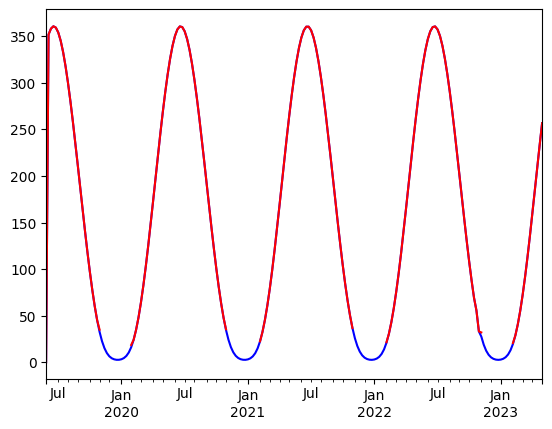

In [ ]:
X_train_a.loc[:]['clear_sky_rad:W'].resample('W').mean().plot(color='b')
X_train_a.loc[ind_train_a]['clear_sky_rad:W'].resample('W').mean().plot(color='r')

In [ ]:
X_train_a = X_train_a.loc[ind_train_a]
X_train_b = X_train_b.loc[ind_train_b]
X_train_c = X_train_c.loc[ind_train_c]


##  Vector similarity approch:
We want to create a validation set that is as close as possible to our test_estimated set. To do so, we tried to encode each data point (a line in our data set) by a vector in $\mathbb R^n$ (embeddings). Instead of using all features and normalize them, we selected only the top 5 most relevant normalized features.
  - We created 2 new data sets : one for the training data $M_{tr} \in \mathbb R^{m \times 5}$ and one for the test data $M_{te} \in \mathbb R^{k \times 5}$ that contains the new embeddings in $\mathbb R^5$.
  - Then we applied cosinus similarity between the 2 matrix.
  $$M := M_{te} M_{tr}^T \in \mathbb R^{k \times m}$$
  - Finally, we selected the top 75% most similar data point to build a new training set, and we took among these 75%, 20% to build the validation set.
  - We also upgraded this method by taking into account more features (not just 5) and weighting them with their correlation with the target $y$. It should have even better results with feature importances but we didn't have time to try it.

In [ ]:
main_feature = ['rad:W', 'clear_sky_rad:W', 'rad_T:WK', 'sun_elevation:d', 'Year sin']
df = pd.concat([X_test_estimated_a[main_feature], X_train_a[main_feature]], axis=0)

In [ ]:
x_test_a = df.loc[X_test_estimated_a.index]
x_train_a = df.loc[X_train_a.index]

x_test_a is the period that we want to predict (spring). We are looking for the most similar examples (lines in x_train_a) in order to train the model on similar data.

In [ ]:
x_train_a

,rad:W,clear_sky_rad:W,rad_T:WK,sun_elevation:d,Year sin
2019-06-02 22:00:00,0.000,0.000,0.000000,-3.77425,0.487287
2019-06-02 23:00:00,0.000,0.000,0.000000,-4.35725,0.486661
2019-06-03 00:00:00,0.000,0.000,0.000000,-3.30950,0.486034
2019-06-03 01:00:00,0.300,0.750,86.025002,-0.82250,0.485408
2019-06-03 02:00:00,12.125,23.100,3473.206299,3.05125,0.484781
...,...,...,...,...,...
2023-04-30 19:00:00,2.925,4.225,804.447998,-0.18050,0.881158
2023-04-30 20:00:00,0.000,0.000,0.000000,-5.17600,0.880819
2023-04-30 21:00:00,0.000,0.000,0.000000,-8.95075,0.880479
2023-04-30 22:00:00,0.000,0.000,0.000000,-11.23325,0.880139


In [ ]:
from sklearn.metrics.pairwise import cosine_similarity as coss
M = coss(x_test_a, x_train_a)

In [ ]:
x_test_a.shape, x_train_a.shape, M.shape

((720, 5), (34061, 5), (720, 34061))

In [ ]:
M = pd.DataFrame(M, index=x_test_a.index)
M = M.T.set_index(x_train_a.index).T
M

,2019-06-02 22:00:00,2019-06-02 23:00:00,2019-06-03 00:00:00,2019-06-03 01:00:00,2019-06-03 02:00:00,2019-06-03 03:00:00,2019-06-03 04:00:00,2019-06-03 05:00:00,2019-06-03 06:00:00,2019-06-03 07:00:00,2019-06-03 08:00:00,2019-06-03 09:00:00,2019-06-03 10:00:00,2019-06-03 11:00:00,2019-06-03 12:00:00,2019-06-03 13:00:00,2019-06-03 14:00:00,2019-06-03 15:00:00,2019-06-03 16:00:00,2019-06-03 17:00:00,2019-06-03 18:00:00,2019-06-03 19:00:00,2019-06-03 20:00:00,2019-06-03 21:00:00,2019-06-03 22:00:00,2019-06-03 23:00:00,2019-06-04 00:00:00,2019-06-04 01:00:00,2019-06-04 02:00:00,2019-06-04 03:00:00,2019-06-04 04:00:00,2019-06-04 05:00:00,2019-06-04 06:00:00,2019-06-04 07:00:00,2019-06-04 08:00:00,2019-06-04 09:00:00,2019-06-04 10:00:00,2019-06-04 11:00:00,2019-06-04 12:00:00,2019-06-04 13:00:00,2019-06-04 14:00:00,2019-06-04 15:00:00,2019-06-04 16:00:00,2019-06-04 17:00:00,2019-06-04 18:00:00,2019-06-04 19:00:00,2019-06-04 20:00:00,2019-06-04 21:00:00,2019-06-04 22:00:00,2019-06-04 23:00:00,2019-06-05 00:00:00,2019-06-05 01:00:00,2019-06-05 02:00:00,2019-06-05 03:00:00,2019-06-05 04:00:00,2019-06-05 05:00:00,2019-06-05 06:00:00,2019-06-05 07:00:00,2019-06-05 08:00:00,2019-06-05 09:00:00,2019-06-05 10:00:00,2019-06-05 11:00:00,2019-06-05 12:00:00,2019-06-05 13:00:00,2019-06-05 14:00:00,2019-06-05 15:00:00,2019-06-05 16:00:00,2019-06-05 17:00:00,2019-06-05 18:00:00,2019-06-05 19:00:00,2019-06-05 20:00:00,2019-06-05 21:00:00,2019-06-05 22:00:00,2019-06-05 23:00:00,2019-06-06 00:00:00,2019-06-06 01:00:00,2019-06-06 02:00:00,2019-06-06 03:00:00,2019-06-06 04:00:00,2019-06-06 05:00:00,2019-06-06 06:00:00,2019-06-06 07:00:00,2019-06-06 08:00:00,2019-06-06 09:00:00,2019-06-06 10:00:00,2019-06-06 11:00:00,2019-06-06 12:00:00,2019-06-06 13:00:00,2019-06-06 14:00:00,2019-06-06 15:00:00,2019-06-06 16:00:00,2019-06-06 17:00:00,2019-06-06 18:00:00,2019-06-06 19:00:00,2019-06-06 20:00:00,2019-06-06 21:00:00,2019-06-06 22:00:00,2019-06-06 23:00:00,2019-06-07 00:00:00,2019-06-07 01:00:00,...,2023-04-26 20:00:00,2023-04-26 21:00:00,2023-04-26 22:00:00,2023-04-26 23:00:00,2023-04-27 00:00:00,2023-04-27 01:00:00,2023-04-27 02:00:00,2023-04-27 03:00:00,2023-04-27 04:00:00,2023-04-27 05:00:00,2023-04-27 06:00:00,2023-04-27 07:00:00,2023-04-27 08:00:00,2023-04-27 09:00:00,2023-04-27 10:00:00,2023-04-27 11:00:00,2023-04-27 12:00:00,2023-04-27 13:00:00,2023-04-27 14:00:00,2023-04-27 15:00:00,2023-04-27 16:00:00,2023-04-27 17:00:00,2023-04-27 18:00:00,2023-04-27 19:00:00,2023-04-27 20:00:00,2023-04-27 21:00:00,2023-04-27 22:00:00,2023-04-27 23:00:00,2023-04-28 00:00:00,2023-04-28 01:00:00,2023-04-28 02:00:00,2023-04-28 03:00:00,2023-04-28 04:00:00,2023-04-28 05:00:00,2023-04-28 06:00:00,2023-04-28 07:00:00,2023-04-28 08:00:00,2023-04-28 09:00:00,2023-04-28 10:00:00,2023-04-28 11:00:00,2023-04-28 12:00:00,2023-04-28 13:00:00,2023-04-28 14:00:00,2023-04-28 15:00:00,2023-04-28 16:00:00,2023-04-28 17:00:00,2023-04-28 18:00:00,2023-04-28 19:00:00,2023-04-28 20:00:00,2023-04-28 21:00:00,2023-04-28 22:00:00,2023-04-28 23:00:00,2023-04-29 00:00:00,2023-04-29 01:00:00,2023-04-29 02:00:00,2023-04-29 03:00:00,2023-04-29 04:00:00,2023-04-29 05:00:00,2023-04-29 06:00:00,2023-04-29 07:00:00,2023-04-29 08:00:00,2023-04-29 09:00:00,2023-04-29 10:00:00,2023-04-29 11:00:00,2023-04-29 12:00:00,2023-04-29 13:00:00,2023-04-29 14:00:00,2023-04-29 15:00:00,2023-04-29 16:00:00,2023-04-29 17:00:00,2023-04-29 18:00:00,2023-04-29 19:00:00,2023-04-29 20:00:00,2023-04-29 21:00:00,2023-04-29 22:00:00,2023-04-29 23:00:00,2023-04-30 00:00:00,2023-04-30 01:00:00,2023-04-30 02:00:00,2023-04-30 03:00:00,2023-04-30 04:00:00,2023-04-30 05:00:00,2023-04-30 06:00:00,2023-04-30 07:00:00,2023-04-30 08:00:00,2023-04-30 09:00:00,2023-04-30 10:00:00,2023-04-30 11:00:00,2023-04-30 12:00:00,2023-04-30 13:00:00,2023-04-30 14:00:00,2023-04-30 15:00:00,2023-04-30 16:00:00,2023-04-30 17:00:00,2023-04-30 18:00:00,2023-04-30 19:00:00,2023-04-30 20:00:00,2023-04-30 21:00:00,2023-04-30 22:00:00,2023-04-30 23:0

The matrix $M$ contains the similarity score between test examples and train examples.

The function train_validation_set select only the best p_data % of the train set. p_val is used for the validation part.

In [ ]:
def train_validation_set(M, p_data=.5, p_val=.2):
  """p_data : how much of the total dataset should we use? 50%? 100%?
     We can compute, how many, for each hour to predict, examples we should have in the union of training dans validation set
     p_val : Among the number of 'examples' for each hour to predict, what pourcentage of them should be in the validation set? 5%, 20%?

     examples with p_data=.5, p_val=.2 we use 10% of the total data for validation, 40% for training and delete 50%
  """
  examples = round(p_data * M.shape[1] / M.shape[0])
  ex_val = round(examples * p_val)
  train, val = [], []
  for ligne in M.index:
    dates = M.loc[ligne].sort_values(ascending=False)[:examples].index.tolist()
    val += dates[:ex_val]
    train += dates[ex_val:]
    M.drop(columns=dates, inplace=True)
  return train, val

We finaly obtain dates for each new sets.

In [ ]:
train_a, val_a = train_validation_set(M, p_data=.75, p_val=.2)

# Postprocessing the prediction

By looking at the data generated $\hat{y}$ , we noticed that:

- Some values are negatives --> we remplace the array by $\hat{y_i} \leftarrow \max(0,\hat{y_i})$
- This first approach was not enough to clean the prediction. There are still some low values that should be equal to zero (especially at night). We noticed (during EDA) that the feature called `sun_elevation:d` was very correlated to the production of solar electricity. In particular, the pv_measurement is always null when the sun elevation is negative. Therefore, we set to zero the prediction if this feature is bellow a threshold and we choose 0 as our threshold. To do so, we saved ```sun_elevation_test_x``` with the raw data before scaling.
- We also noticed that our regressors struggle most of the time to reach $y$ peak. To balance it, we tried to, when $\hat{y}$ is above a threshold $\theta$, remplace $\hat{y}$ by $(1+ ɛ)\hat{y}$
- We observed a delay during the day between $y$ and $\hat{y}$.


## Deal with negative values

In [ ]:
pos = lamdba x: 0 if x<0 else 0

In [ ]:
df_pred_a['prediction'] = df_pred_a['prediction'].apply(lambda x: pos(x))

## Deal with small positive values

In [ ]:
df_pred_a['sun_elevation_a'] = sun_elevation_test_a.values
df_pred_b['sun_elevation_b'] = sun_elevation_test_b.values
df_pred_c['sun_elevation_c'] = sun_elevation_test_c.values

In [ ]:
df_pred_a['prediction'] = df_pred_a[['prediction', 'sun_elevation_a']].apply(lambda x: 0 if x[1]<0 else x[0], axis=1)
df_pred_b['prediction'] = df_pred_b[['prediction', 'sun_elevation_b']].apply(lambda x: 0 if x[1]<0 else x[0], axis=1)
df_pred_c['prediction'] = df_pred_c[['prediction', 'sun_elevation_c']].apply(lambda x: 0 if x[1]<0 else x[0], axis=1)

In [ ]:
df_pred_a.drop('sun_elevation_a', axis=1, inplace=True)
df_pred_b.drop('sun_elevation_b', axis=1, inplace=True)
df_pred_c.drop('sun_elevation_c', axis=1, inplace=True)

In [ ]:
df_pred_a['prediction'] = df_pred_a['prediction'].apply(lambda x: pos(x))
df_pred_b['prediction'] = df_pred_b['prediction'].apply(lambda x: pos(x))
df_pred_c['prediction'] = df_pred_c['prediction'].apply(lambda x: pos(x))

In [ ]:
df_pred_a

,id,time,prediction,location
0,0,0,0.000000,A
1,1,1,0.000000,A
2,2,2,0.000000,A
3,3,3,56.674310,A
4,4,4,316.077724,A
...,...,...,...,...
715,715,715,185.537684,A
716,716,716,63.327810,A
717,717,717,0.000000,A
718,718,718,0.000000,A


## Deal with delay predictions

We also noticed, once we compared our prediction on the validation set, that most of the time, during the day, there is a shift (of $\sim$ 1 hour) between our prediction and the real data. We were thinking about applying a more sophisticated postprocessing in order to correct this delay.


$$\forall a \le t \le b \quad \hat{y}_t ← w\hat{y}_{t-1}+(1-w)\hat{y}_t$$

$a,b$ limit the time period where we apply the shift. $w$ is a weight which gives an indication of how much we will take into account the last value.

We can notice on this figure,

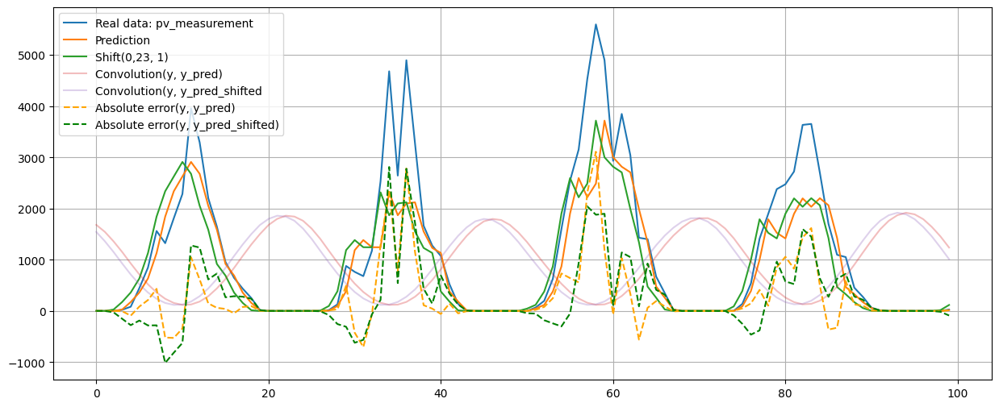

(<matplotlib.legend.Legend at 0x7d2092043730>, None, None)

In [ ]:
plt.figure(figsize=(15,6))
M=100
P=-3
modified_array = np.concatenate((Y_pred[P], [0]))
modified_array = modified_array[1:]
plt.plot(Y[P].values[:M], label='Real data: pv_measurement'),plt.plot(Y_pred[P][:M], label='Prediction'), plt.plot(modified_array[:M], label='Shift(0,23, 1)'), plt.plot(C[P][:100]/10**6, label='Convolution(y, y_pred)', alpha=.3),plt.plot(C_shift[P][:100]/10**6, label='Convolution(y, y_pred_shifted', alpha=.3),
plt.plot(Y[P].values[:M]-Y_pred[P][:M], label='Absolute error(y, y_pred)', color='orange', linestyle='--'), plt.plot(Y[P].values[:M]-Y_shift[P][:M],label='Absolute error(y, y_pred_shifted)',color='green', linestyle='--')
plt.legend(),plt.grid(), plt.show()

In [ ]:
def shift_postprocessing(df_pred, a, b, w):
  df_shift = df_pred.copy()
  df_shift['shift'] = df_shift['pv_measurement'].shift(-1)
  fe = df_shift[(df_shift['hour'] >= a) & (df_shift['hour'] <= b)]
  for i in fe.index:
    df_shift.loc[i, 'pv_measurement'] = w*df_shift.loc[i, 'shift']+(1-w)*df_shift.loc[i, 'pv_measurement']
  return df_shift

To find the right parameters $a,b,w$ we compute all the possibilities, and look at how much MAE score we can gain. On this example, we can improve the MAE score by few points.

In [ ]:
df_data = pd.DataFrame(Y[0])
df_pred = pd.DataFrame(Y[0])
df_pred['pv_measurement'] = Yy
df_pred['hour'] = df_pred.index.hour

for a in tqdm(range(1, 12)):
  for b in (range(12, 23)):
    for w in [.1, .3, .4, .5, .6]:
      df_shift = df_pred.copy()
      df_shift['shift'] = df_shift['pv_measurement'].shift(-1)
      fe = df_shift[(df_shift['hour'] >= a) & (df_shift['hour'] <= b)]
      for i in fe.index:
        df_shift.loc[i, 'pv_measurement'] = w*df_shift.loc[i, 'shift']+(1-w)*df_shift.loc[i, 'pv_measurement']
      new_mae = (df_data.pv_measurement-df_shift.pv_measurement).abs().mean()
      if new_mae < mae -2:
        print(mae-new_mae, a, b, w)


  0%|          | 0/11 [00:00<?, ?it/s]

2.490553123612983 1 12 0.1
2.498579556507707 1 13 0.1
2.011900313134902 1 14 0.1
2.0422716204405447 1 15 0.1


  9%|▉         | 1/11 [00:18<03:01, 18.14s/it]

2.5870529174796957 2 12 0.1
2.5950793503744194 2 13 0.1
2.108400107001671 2 14 0.1
2.138771414307257 2 15 0.1


 18%|█▊        | 2/11 [00:34<02:36, 17.36s/it]

2.6961232211510833 3 12 0.1
2.7041496540456365 3 13 0.1
2.217470410672888 3 14 0.1
2.2478417179786447 3 15 0.1


 27%|██▋       | 3/11 [00:51<02:17, 17.15s/it]

2.5775194926680456 4 12 0.1
2.5855459255627693 4 13 0.1
2.098866682189964 4 14 0.1
2.129237989495607 4 15 0.1


 36%|███▋      | 4/11 [01:07<01:56, 16.70s/it]

2.169830768625957 5 12 0.1
2.1778572015206237 5 13 0.1


100%|██████████| 11/11 [02:37<00:00, 14.36s/it]


# Machine Learning estimators

# **First approach : One regression model**

For our first approach, the idea was to apply one regression model per location, like XGBoost or GBM and try to tune it well.

## Preprocessing

First, let's summarize the main parts of the preprocessing used with this approach.

For this model, we first tried to get rid of any features that would be very correlated to another one in the dataset, because it might be redundant information.

To delete them, we examined the correlation between every feature and set a threshold to detect the pairs of correlated features. Then, we manually chose which one to delete, to make sure that we did not accidently delete both correlated features and lose information.

In [ ]:
X_train_estimated_a.drop(['date_calc', 'date_forecast'], axis = 1).corr()['effective_cloud_cover:p']
#X_train_observed_a.drop(['date_forecast'], axis = 1).corr()
#X_test_estimated_a.drop(['date_calc','date_forecast'], axis = 1).corr()

matrix_corr = X_train_estimated_a.drop(['date_calc', 'date_forecast'], axis = 1).corr()
correlated_variables = {}
for key_1 in X_train_estimated_a.drop(['date_calc', 'date_forecast'], axis = 1).keys():
    for key_2 in X_train_estimated_a.drop(['date_calc', 'date_forecast'], axis = 1).keys():
        if  abs(matrix_corr[key_1][key_2]) > 0.9 and abs(matrix_corr[key_1][key_2]) != 1:
            correlated_variables[(key_1, key_2)] = matrix_corr[key_1][key_2]
print(correlated_variables)

{('absolute_humidity_2m:gm3', 'dew_point_2m:K'): 0.9825923925578672, ('clear_sky_energy_1h:J', 'clear_sky_rad:W'): 0.9905489999326903, ('clear_sky_energy_1h:J', 'diffuse_rad:W'): 0.9045849649349028, ('clear_sky_energy_1h:J', 'diffuse_rad_1h:J'): 0.9175394751229402, ('clear_sky_rad:W', 'clear_sky_energy_1h:J'): 0.9905489999326903, ('clear_sky_rad:W', 'diffuse_rad:W'): 0.9139565352014161, ('clear_sky_rad:W', 'diffuse_rad_1h:J'): 0.9096551329627153, ('dew_point_2m:K', 'absolute_humidity_2m:gm3'): 0.9825923925578672, ('dew_point_2m:K', 't_1000hPa:K'): 0.9002278702322717, ('diffuse_rad:W', 'clear_sky_energy_1h:J'): 0.9045849649349028, ('diffuse_rad:W', 'clear_sky_rad:W'): 0.9139565352014161, ('diffuse_rad:W', 'diffuse_rad_1h:J'): 0.9866227765332353, ('diffuse_rad_1h:J', 'clear_sky_energy_1h:J'): 0.9175394751229402, ('diffuse_rad_1h:J', 'clear_sky_rad:W'): 0.9096551329627153, ('diffuse_rad_1h:J', 'diffuse_rad:W'): 0.9866227765332353, ('direct_rad:W', 'direct_rad_1h:J'): 0.9875649117141303, (

We dropped those correlated features and 3 other features that are constant.

In [ ]:
X_train_estimated_a = pd.read_parquet('A/X_train_estimated.parquet')
X_train_observed_a = pd.read_parquet('A/X_train_observed.parquet')
X_test_estimated_a = pd.read_parquet('A/X_test_estimated.parquet')
train_a = pd.read_parquet('A/train_targets.parquet')

X_train_estimated_b = pd.read_parquet('B/X_train_estimated.parquet')
X_train_observed_b = pd.read_parquet('B/X_train_observed.parquet')
X_test_estimated_b = pd.read_parquet('B/X_test_estimated.parquet')
train_b = pd.read_parquet('B/train_targets.parquet')

X_train_estimated_c = pd.read_parquet('C/X_train_estimated.parquet')
X_train_observed_c = pd.read_parquet('C/X_train_observed.parquet')
X_test_estimated_c = pd.read_parquet('C/X_test_estimated.parquet')
train_c = pd.read_parquet('C/train_targets.parquet')

#Delete features because high correlation between them (>0.9) :
X_train_estimated_a.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J', 'date_calc'], axis = 1, inplace = True)
X_train_observed_a.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J'], axis = 1, inplace = True)
X_test_estimated_a.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J', 'date_calc'], axis = 1, inplace = True)

X_train_estimated_b.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J', 'date_calc'], axis = 1, inplace = True)
X_train_observed_b.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J'], axis = 1, inplace = True)
X_test_estimated_b.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J', 'date_calc'], axis = 1, inplace = True)

X_train_estimated_c.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J', 'date_calc'], axis = 1, inplace = True)
X_train_observed_c.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J'], axis = 1, inplace = True)
X_test_estimated_c.drop(['clear_sky_energy_1h:J', 'dew_point_2m:K', 'diffuse_rad_1h:J',\
                                                'msl_pressure:hPa', 'pressure_50m:hPa', 'sfc_pressure:hPa',\
                                                'direct_rad_1h:J', 'date_calc'], axis = 1, inplace = True)

#Delete because constant values:
X_train_estimated_a.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)
X_train_observed_a.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)
X_test_estimated_a.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)

X_train_estimated_b.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)
X_train_observed_b.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)
X_test_estimated_b.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)

X_train_estimated_c.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)
X_train_observed_c.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)
X_test_estimated_c.drop(['snow_density:kgm3', 'snow_drift:idx', 'wind_speed_w_1000hPa:ms'], axis = 1, inplace = True)


We also did a one-hot encodding for the categorical variables.

In [ ]:
#One Hot encoding
from sklearn.preprocessing import OneHotEncoder

idx = ['dew_or_rime:idx',\
       'is_day:idx',
       'is_in_shadow:idx',
       'precip_type_5min:idx',]

for id in idx:
    concatenated_df = pd.concat([X_train_observed_a_matched[id], X_train_estimated_a_matched[id], X_test_estimated_a[id]])
    one_hot_encoded = pd.get_dummies(concatenated_df, prefix= id)
    df_estimated_encoded = one_hot_encoded.loc[X_train_estimated_a_matched.index]
    df_observed_encoded = one_hot_encoded.loc[X_train_observed_a_matched.index]
    df_test_encoded = one_hot_encoded.loc[X_test_estimated_a.index]
    X_train_observed_a_matched = pd.concat([X_train_observed_a_matched, df_observed_encoded], axis =1)
    X_train_estimated_a_matched = pd.concat([X_train_estimated_a_matched, df_estimated_encoded], axis = 1)
    X_test_estimated_a = pd.concat([X_test_estimated_a, df_test_encoded], axis = 1)
    X_train_observed_a_matched.drop([id], inplace = True, axis=1)
    X_train_estimated_a_matched.drop([id], inplace = True, axis=1)
    X_test_estimated_a.drop([id], inplace = True, axis=1)

for id in idx:
    concatenated_df = pd.concat([X_train_observed_b_matched[id], X_train_estimated_b_matched[id], X_test_estimated_b[id]])
    one_hot_encoded = pd.get_dummies(concatenated_df, prefix= id)
    df_estimated_encoded = one_hot_encoded.loc[X_train_estimated_b_matched.index]
    df_observed_encoded = one_hot_encoded.loc[X_train_observed_b_matched.index]
    df_test_encoded = one_hot_encoded.loc[X_test_estimated_b.index]
    X_train_observed_b_matched = pd.concat([X_train_observed_b_matched, df_observed_encoded], axis =1)
    X_train_estimated_b_matched = pd.concat([X_train_estimated_b_matched, df_estimated_encoded], axis = 1)
    X_test_estimated_b = pd.concat([X_test_estimated_b, df_test_encoded], axis = 1)
    X_train_observed_b_matched.drop([id], inplace = True, axis=1)
    X_train_estimated_b_matched.drop([id], inplace = True, axis=1)
    X_test_estimated_b.drop([id], inplace = True, axis=1)

for id in idx:
    concatenated_df = pd.concat([X_train_observed_c_matched[id], X_train_estimated_c_matched[id], X_test_estimated_c[id]])
    one_hot_encoded = pd.get_dummies(concatenated_df, prefix= id)
    df_estimated_encoded = one_hot_encoded.loc[X_train_estimated_c_matched.index]
    df_observed_encoded = one_hot_encoded.loc[X_train_observed_c_matched.index]
    df_test_encoded = one_hot_encoded.loc[X_test_estimated_c.index]
    X_train_observed_c_matched = pd.concat([X_train_observed_c_matched, df_observed_encoded], axis =1)
    X_train_estimated_c_matched = pd.concat([X_train_estimated_c_matched, df_estimated_encoded], axis = 1)
    X_test_estimated_c = pd.concat([X_test_estimated_c, df_test_encoded], axis = 1)
    X_train_observed_c_matched.drop([id], inplace = True, axis=1)
    X_train_estimated_c_matched.drop([id], inplace = True, axis=1)
    X_test_estimated_c.drop([id], inplace = True, axis=1)


We imputed the missing values with an average :

In [ ]:
#Missing values
X_train_estimated_a_final = X_train_estimated_a_matched.fillna(value={
                'ceiling_height_agl:m' : X_train_estimated_a_matched['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_train_estimated_a_matched['cloud_base_agl:m'].mean()})

X_train_observed_a_final = X_train_observed_a_matched.fillna(value={
               'ceiling_height_agl:m' : X_train_observed_a_matched['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_train_observed_a_matched['cloud_base_agl:m'].mean()})

X_test_estimated_a_final = X_test_estimated_a.fillna(value={
                'ceiling_height_agl:m' : X_test_estimated_a['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_test_estimated_a['cloud_base_agl:m'].mean()})


X_train_estimated_b_final = X_train_estimated_b_matched.fillna(value={
                'ceiling_height_agl:m' : X_train_estimated_b_matched['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_train_estimated_b_matched['cloud_base_agl:m'].mean()})

X_train_observed_b_final = X_train_observed_b_matched.fillna(value={
               'ceiling_height_agl:m' : X_train_observed_b_matched['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_train_observed_b_matched['cloud_base_agl:m'].mean()})

X_test_estimated_b_final = X_test_estimated_b.fillna(value={
                'ceiling_height_agl:m' : X_test_estimated_b['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_test_estimated_b['cloud_base_agl:m'].mean()})


X_train_estimated_c_final = X_train_estimated_c_matched.fillna(value={
                'ceiling_height_agl:m' : X_train_estimated_c_matched['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_train_estimated_c_matched['cloud_base_agl:m'].mean()})

X_train_observed_c_final = X_train_observed_c_matched.fillna(value={
               'ceiling_height_agl:m' : X_train_observed_c_matched['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_train_observed_c_matched['cloud_base_agl:m'].mean()})

X_test_estimated_c_final = X_test_estimated_c.fillna(value={
                'ceiling_height_agl:m' : X_test_estimated_c['ceiling_height_agl:m'].mean(),
                'cloud_base_agl:m' : X_test_estimated_c['cloud_base_agl:m'].mean()})


We normalized the data with a `MinMaxScaler()` and tried a lot of transformations on the data, to try and make the features' distributions more normaly distributed :

In [ ]:
transformations = [['absolute_humidity_2m:gm3', 'f'],
 ['air_density_2m:kgm3', '1/f'],
 ['ceiling_height_agl:m', 'f'],
 ['clear_sky_rad:W', 'f'],
 ['cloud_base_agl:m', 'logfc'],
 ['dew_or_rime:idx', 'hot'],
 ['effective_cloud_cover:p', 'f^2'],
 ['elevation:m', 'constant'],
 ['fresh_snow_12h:cm', 'loglogf ou rien'],
 ['fresh_snow_1h:cm', 'loglogf ou rien'],
 ['fresh_snow_24h:cm', 'loglogf ou rien'],
 ['fresh_snow_3h:cm', 'loglogf ou rien'],
 ['fresh_snow_6h:cm', 'loglogf ou rien'],
 ['is_day:idx', 'hot'],
 ['is_in_shadow:idx', 'hot'],
 ['precip_5min:mm', 'loglogf ou rien'],
 ['precip_type_5min:idx', 'hot'],
 ['pressure_100m:hPa', 'rien'],
 ['prob_rime:p', 'loglogf ou rien'],
 ['rain_water:kgm2', 'one hot à faire !'],
 ['relative_humidity_1000hPa:p', ''],
 ['snow_density:kgm3', 'constant'],
 ['snow_depth:cm', 'loglogf ou rien'],
 ['snow_drift:idx', 'hot'],
 ['snow_melt_10min:mm', 'loglogf ou rien'],
 ['snow_water:kgm2', 'loglogf ou rien'],
 ['sun_azimuth:d', 'f ou f^2'],
 ['sun_elevation:d', 'f ou f^2'],
 ['super_cooled_liquid_water:kgm2', 'loglogf ou rien'],
 ['t_1000hPa:K', 'f^2'],
 ['total_cloud_cover:p', 'f^2 ou rien'],
 ['visibility:m', 'f'],
 ['wind_speed_10m:ms', 'f ou logfc'],
 ['wind_speed_u_10m:ms', 'f ou logfc'],
 ['wind_speed_v_10m:ms', 'f'],
 ['wind_speed_w_1000hPa:ms', 'hot']]

In [ ]:
for X in [X_train_estimated_a_final, X_train_observed_a_final, X_test_estimated_a_final,\
         X_train_estimated_b_final, X_train_observed_b_final, X_test_estimated_b_final,\
         X_train_estimated_c_final, X_train_observed_c_final, X_test_estimated_c_final] :
    for feature, function in transformations:
        if function == '1/f':
            X[feature] = 1/(X[feature]+.5)
        if function == 'logfc':
            X[feature] = np.log(X[feature] + (X[feature].quantile(.25)/X[feature].quantile(.75))**2 )
        if function == 'f^2':
            X[feature] = (X[feature])**2
        if function == 'logf':
            X[feature] = np.log(X[feature]+.001)
        if function == 'loglogf':
            X[feature] = np.log(np.log(X[feature]+1)+1)

Then we concatenated the data to have both the observed and estimated data together.

In [ ]:
X_train_total_a = np.concatenate((X_train_observed_a_scaled, X_train_estimated_a_scaled), axis = 0)
X_train_total_b = np.concatenate((X_train_observed_b_scaled, X_train_estimated_b_scaled), axis = 0)
X_train_total_c = np.concatenate((X_train_observed_c_scaled, X_train_estimated_c_scaled), axis = 0)

## Choosing the model

Then, we decided to try out some models, and evaluate their performance on the estimated training set to choose the best one.

In [ ]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.metrics import mean_absolute_error as mae
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neighbors import LocalOutlierFactor
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
#from lightgbm import LGBMRegressor

In [ ]:
models = [('LR', LinearRegression()),
          ("Ridge", Ridge()),
          ("Lasso", Lasso()),
          ("ElasticNet", ElasticNet()),
          ('CART', DecisionTreeRegressor()),
          ('RF', RandomForestRegressor()),
          ('SVR', SVR()),
          ('GBM', GradientBoostingRegressor()),
          ("XGBoost", XGBRegressor(objective='reg:squarederror'))
          ]

In [ ]:
from sklearn.metrics import mean_absolute_error as mae
for name, regressor in models:
    regressor.fit(X_train_observed_a_scaled, train_a_observed_matched.to_numpy().ravel())
    y_pred = regressor.predict(X_train_estimated_a_scaled)
    y_test = train_a_estimated_matched.to_numpy().ravel()
    error = mae(y_test, y_pred)
    print('MAE for {reg} = {score_mae}'.format(reg=name, score_mae=str(error)))

MAE for LR = 315.32363158957435
MAE for Ridge = 306.73551827036147
MAE for Lasso = 241.78104306824815
MAE for ElasticNet = 569.7302944007286
MAE for CART = 223.19185252617206
MAE for RF = 164.66881888939463
MAE for SVR = 227.94698293509217
MAE for GBM = 158.9276309905677
MAE for XGBoost = 191.92379150401925


It turns out GBM has a pretty good score on the estimated set, for both A, B and C. Therefore, we decided to try with this model.

## Hyperparameter tuning

We tuned the hyperparameters with a GridSearch CV.

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import make_scorer

from sklearn.metrics import make_scorer, mean_absolute_error
mae_scorer = make_scorer(mean_absolute_error, greater_is_better=False)

# A sample parameter
parameters = {    "learning_rate": [0.01, 0.05, 0.1],#, 0.1, 0.15, 0.2],
    #"min_samples_split": np.linspace(0.1, 0.5, 12),
    #"min_samples_leaf": np.linspace(0.1, 0.5, 12),
    "max_depth":[3,5,8],
    #"max_features":["log2","sqrt"],
    #"criterion": ["friedman_mse",  "mae"],
    #"subsample":[0.5, 0.618, 0.8, 0.85, 0.9, 0.95, 1.0],
    "n_estimators":[50, 100, 200]
    }
#passing the scoring function in the GridSearchCV
clf = GridSearchCV(GradientBoostingRegressor(), parameters,scoring=mae_scorer,refit=False,cv=2, n_jobs=-1, verbose = 3)

clf.fit(X_train_total_a, pd.concat([train_a_observed_matched, train_a_estimated_matched]).to_numpy().ravel())
#converting the clf.cv_results to dataframe
df=pd.DataFrame.from_dict(clf.cv_results_)
#here Possible inputs for cross validation is cv=2, there two split split0 and split1

We obtained the following hyperparameters : {'learning_rate': 0.05, 'max_depth': 8, 'n_estimators': 100}

We did the same thing for locations B and C :

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import make_scorer

from sklearn.metrics import make_scorer, mean_absolute_error
mae_scorer = make_scorer(mean_absolute_error, greater_is_better=False)

# A sample parameter
parameters = {    "learning_rate": [0.01, 0.05, 0.1],#, 0.1, 0.15, 0.2],
    #"min_samples_split": np.linspace(0.1, 0.5, 12),
    #"min_samples_leaf": np.linspace(0.1, 0.5, 12),
    "max_depth":[3,5,8],
    #"max_features":["log2","sqrt"],
    #"criterion": ["friedman_mse",  "mae"],
    #"subsample":[0.5, 0.618, 0.8, 0.85, 0.9, 0.95, 1.0],
    "n_estimators":[50, 100, 200]
    }
#passing the scoring function in the GridSearchCV
clf = GridSearchCV(GradientBoostingRegressor(), parameters,scoring=mae_scorer,refit=False,cv=2, n_jobs=-1, verbose = 3)

clf.fit(X_train_total_b, pd.concat([train_b_observed_matched, train_b_estimated_matched]).to_numpy().ravel())
#converting the clf.cv_results to dataframe
df=pd.DataFrame.from_dict(clf.cv_results_)
#here Possible inputs for cross validation is cv=2, there two split split0 and split1

For location B, we obtained the following hyperparameters : {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import make_scorer

from sklearn.metrics import make_scorer, mean_absolute_error
mae_scorer = make_scorer(mean_absolute_error, greater_is_better=False)

# A sample parameter
parameters = {    "learning_rate": [0.01, 0.05, 0.1],#, 0.1, 0.15, 0.2],
    #"min_samples_split": np.linspace(0.1, 0.5, 12),
    #"min_samples_leaf": np.linspace(0.1, 0.5, 12),
    "max_depth":[3,5,8],
    #"max_features":["log2","sqrt"],
    #"criterion": ["friedman_mse",  "mae"],
    #"subsample":[0.5, 0.618, 0.8, 0.85, 0.9, 0.95, 1.0],
    "n_estimators":[50, 100, 200]
    }
#passing the scoring function in the GridSearchCV
clf_c = GridSearchCV(GradientBoostingRegressor(), parameters,scoring=mae_scorer,refit=False,cv=2, n_jobs=-1, verbose = 3)

clf_c.fit(X_train_total_c, pd.concat([train_c_observed_matched, train_c_estimated_matched]).to_numpy().ravel())
#converting the clf.cv_results to dataframe
df=pd.DataFrame.from_dict(clf_c.cv_results_)
#here Possible inputs for cross validation is cv=2, there two split split0 and split1

And for C we obtained the following hyperparameters :  {'learning_rate': 0.05, 'max_depth': 8, 'n_estimators': 200}

## Fitting the model

We fit the GBM model on the whole training set (observed + estimated).

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
model = [('GBM', GradientBoostingRegressor(learning_rate = 0.05, max_depth = 8, n_estimators = 100))]
from sklearn.metrics import mean_absolute_error as mae
for name, regressor in model:
    regressor.fit(X_train_total_a, pd.concat([train_a_observed_matched, train_a_estimated_matched], axis = 0).to_numpy().ravel())
    y_pred = regressor.predict(X_test_estimated_a_scaled)
    df_pred_a = pd.DataFrame({'prediction' : y_pred})
    df_pred_a.set_index(X_test_estimated_a_final.index, inplace = True)

We also used some preprocessing to avoid the predictions of negative values.

In [ ]:
for date in df_pred_a.index :
    if df_pred_a.loc[date]['prediction'] < 0 :
        df_pred_a.loc[date]['prediction'] = 0

Then, we do the same for B and C : fitting, predictions and post processing.




## Results and ameliorations with this model :

This model was our very first approach. Back then, we didn't notice that there were outliers in the location B.

Those first submissions scored at around 195-170 in MAE.
To try and make the scores a bit better, we tried multiple things including doing a binary classification before, to predict if a value is null or not. Theoretically, this should allow the model to focus on non zero values and prevent it from under predicting the high values.

However, it didn't work out really well for us... The score wasn't better so we dropped the idea (but also we hadn't noticed the outliers in the data, so this might have played a part).

Here's a peak of the code that we did for that.

In [ ]:
# We modify Y to have a binary classification : 0 = no production of electricity
train_a_estimated_binary = pd.DataFrame({'pv_measurement' : train_a_estimated_matched['pv_measurement']})
train_a_observed_binary = pd.DataFrame({'pv_measurement' : train_a_observed_matched['pv_measurement']})

train_b_estimated_binary = pd.DataFrame({'pv_measurement' : train_b_estimated_matched['pv_measurement']})
train_b_observed_binary = pd.DataFrame({'pv_measurement' : train_b_observed_matched['pv_measurement']})

train_c_estimated_binary = pd.DataFrame({'pv_measurement' : train_c_estimated_matched['pv_measurement']})
train_c_observed_binary = pd.DataFrame({'pv_measurement' : train_c_observed_matched['pv_measurement']})

for time in train_a_estimated_binary.index:
    if train_a_estimated_binary.loc[time]['pv_measurement'] > 0 :
        train_a_estimated_binary.loc[time] = 1

for time in train_a_observed_binary.index:
    if train_a_observed_binary.loc[time]['pv_measurement'] > 0 :
        train_a_observed_binary.loc[time] = 1

for time in train_b_estimated_binary.index:
    if train_b_estimated_binary.loc[time]['pv_measurement'] > 0 :
        train_b_estimated_binary.loc[time] = 1

for time in train_b_observed_binary.index:
    if train_b_observed_binary.loc[time]['pv_measurement'] > 0 :
        train_b_observed_binary.loc[time] = 1

for time in train_c_estimated_binary.index:
    if train_c_estimated_binary.loc[time]['pv_measurement'] > 0 :
        train_c_estimated_binary.loc[time] = 1

for time in train_c_observed_binary.index:
    if train_c_observed_binary.loc[time]['pv_measurement'] > 0 :
        train_c_observed_binary.loc[time] = 1

In [ ]:
train_a_total_binary = pd.concat([train_a_observed_binary, train_a_estimated_binary], axis = 0)
y_total_a = train_a_total_binary.to_numpy().ravel()
train_b_total_binary = pd.concat([train_b_observed_binary, train_b_estimated_binary], axis = 0)
y_total_b = train_b_total_binary.to_numpy().ravel()
train_c_total_binary = pd.concat([train_c_observed_binary, train_c_estimated_binary], axis = 0)
y_total_c = train_c_total_binary.to_numpy().ravel()

y_observed_a_binary = train_a_observed_binary.to_numpy().ravel()
y_observed_b_binary = train_b_observed_binary.to_numpy().ravel()
y_observed_c_binary = train_c_observed_binary.to_numpy().ravel()

y_estimated_a_binary = train_a_estimated_binary.to_numpy().ravel()
y_estimated_b_binary = train_b_estimated_binary.to_numpy().ravel()
y_estimated_c_binary = train_c_estimated_binary.to_numpy().ravel()

X_train_total_a = np.concatenate((X_train_observed_a_scaled, X_train_estimated_a_scaled), axis = 0)
X_train_total_b = np.concatenate((X_train_observed_b_scaled, X_train_estimated_b_scaled), axis = 0)
X_train_total_c = np.concatenate((X_train_observed_c_scaled, X_train_estimated_c_scaled), axis = 0)

In [ ]:
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import make_scorer

X = X_train_total_a
y = y_total_a

model = LogisticRegression(max_iter = 1000)

#We looked at different scoring metrics
scoring_metrics = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'f1': 'f1'
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=0)

scores = cross_val_score(model, X, y, cv=cv, scoring=make_scorer(f1_score))

for i, score in enumerate(scores, 1):
    print(f'Fold {i} - Accuracy: {score}')

print(f'Mean Accuracy: {scores.mean()}')


In [ ]:
#Apply the Logistic Regression to determine whether the electricity production is null or not

X_train = X_train_total_a
y_train = y_total_a

model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

y_pred = model.predict(X_test_estimated_a_scaled)

#We select the indexes with a positive or negative prediction
df_pred_a = pd.DataFrame({'prediction' : y_pred})
df_pred_a.set_index(X_test_estimated_a_final.index, inplace = True)
indexes = df_pred_a.index[df_pred_a['prediction']==1]
null_indexes = df_pred_a.index[df_pred_a['prediction']==0]

X_to_apply_model = X_test_estimated_a_final.loc[indexes]
scaler = MinMaxScaler()
X_to_apply_model_scaled = scaler.fit_transform(X_to_apply_model)
print(indexes)
print(df_pred_a['2023-05-01 00:00:00' : '2023-05-02 00:00:00'])


In [ ]:
models = [('GBM', GradientBoostingRegressor())]
from sklearn.metrics import mean_absolute_error as mae
for name, regressor in models:
    regressor.fit(X_train_total_a, pd.concat([train_a_observed_matched, train_a_estimated_matched], axis = 0))
    y_pred = regressor.predict(X_to_apply_model_scaled)
    df_pred_a.loc[indexes, 'prediction'] = y_pred

    for date in null_indexes :
        df_pred_a.loc[date] = 0

    #y_test = train_b_estimated_matched
    #error = mae(y_test, df_pred_a)
    #print('MAE for {reg} = {score_mae}'.format(reg=name, score_mae=str(error)))

df_pred_a[0:24]

We also tried to look at the feature importance in order to delete some unnecessary variables :

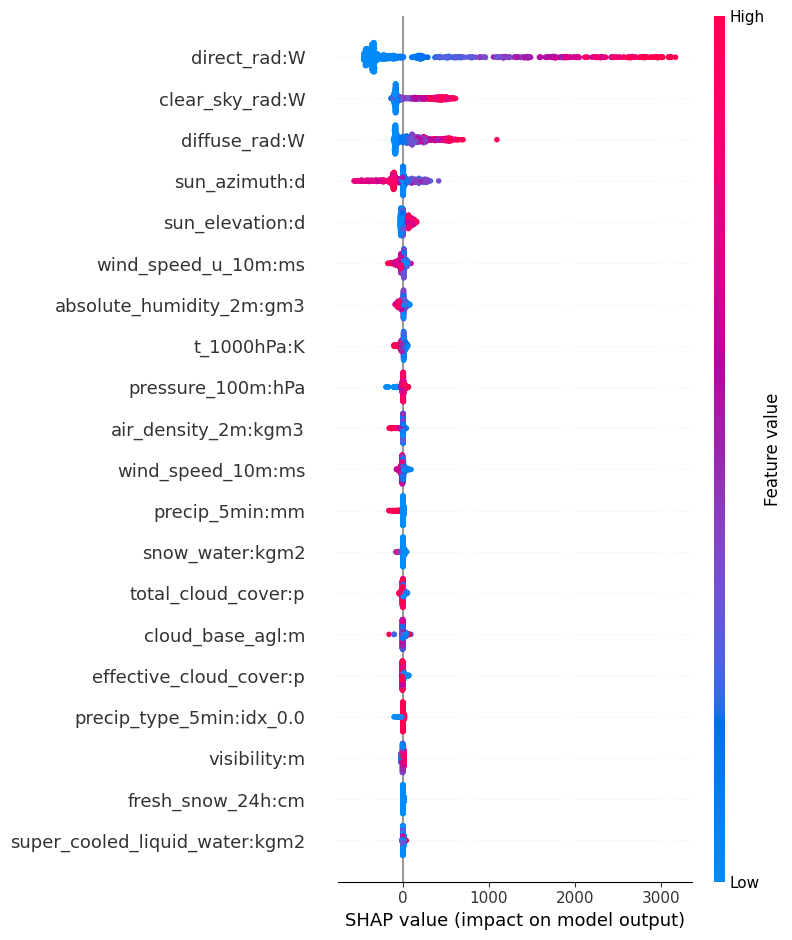

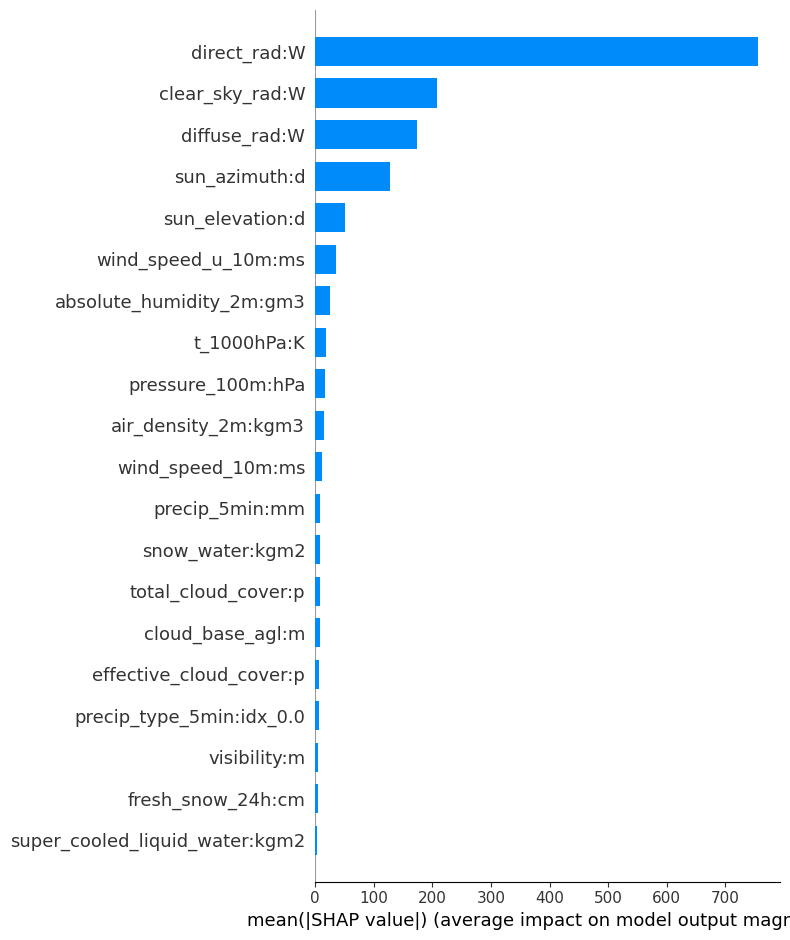

In [ ]:
import shap
explainer = shap.TreeExplainer(regressor)
shap_values = explainer.shap_values(X_test_estimated_a_scaled)
shap.summary_plot(shap_values, X_test_estimated_a_scaled)
shap.summary_plot(shap_values, X_test_estimated_a_scaled, plot_type='bar')

Therefore we can see that for this GBM Regressor, some features have a feature importance of pretty much 0 : `super_cooled_liquid_water:kgm2`, `fresh_snow_24h:cm`, `precip_type_5_min:idx_0.0` can be deleted for instance

That is why, for one variation of this model, we decided to drop the following features from the datasets :

In [ ]:
list_to_delete = ['precip_type_5min:idx_6.0',
                    'dew_or_rime:idx_-1.0',
                    'is_day:idx_1.0',
                    'is_in_shadow:idx_0.0',
                    'precip_type_5min:idx_5.0',
                    'snow_melt_10min:mm',
                    'snow_depth:cm',
                    'dew_or_rime:idx_0.0',
                    'is_in_shadow:idx_1.0',
                    'fresh_snow_6h:cm',
                    'fresh_snow_3h:cm',
                    'prob_rime:p',
                    'fresh_snow_1h:cm',
                    'precip_type_5min:idx_2.0',
                    'elevation:m',
                    'precip_type_5min:idx_3.0',
                    'dew_or_rime:idx_1.0',
                    'fresh_snow_12h:cm',
                    'is_day:idx_0.0',
                    'super_cooled_liquid_water:kgm2']

Finally, we tried to change the preprocessing, and add the shift between the estimated and observed distribution and also to train only on spring data as we explained in the beginning of this notebook.

# **Second approach : Deep Learning**

## Simple Neural Network

After this first approach with regression model, we wanted to give deep learning a try.

First, here is a summary of the preprocessing that we did for this approach :

*   Deleted the correlated or constant features
*   Added time related features (Day sin, Day cos, Year sin, Year cos)
*   Sampled the data to keep one measurement per hour for every feature (the value at the hour o' clock)
*   Coded a one hot encoding for the following features : idx =[`dew_or_rime:idx`, `is_day:idx`, `is_in_shadow:idx`, `precip_type_5min:idx`]
*   Delt with the missing values of `ceiling_height_agl:m `and `cloud_base_agl:m`, with the median value.
*   Normalized the data with a `MinMaxScaler()`



We started with a quite simple neural network, that we repeated for all 3 locations.

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

In [ ]:
class MyNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.hidden1 = nn.Linear(49, 64)
        self.act1 = nn.ReLU()
        self.hidden2 = nn.Linear(64, 32)
        self.act2 = nn.ReLU()
        self.hidden3 = nn.Linear(32, 16)
        self.act3 = nn.ReLU()
        self.hidden4 = nn.Linear(16, 8)
        self.act4 = nn.ReLU()
        self.output = nn.Linear(8, 1)
        self.act_output = nn.Linear(1,1)

    def forward(self, x):
        x = self.act1(self.hidden1(x))
        x = self.act2(self.hidden2(x))
        x = self.act3(self.hidden3(x))
        x = self.act4(self.hidden4(x))
        x = self.act_output(self.output(x))
        return x

In [ ]:
model_a = MyNN()
print(model_a)

loss_fn = nn.L1Loss()  # MAE
optimizer = optim.Adam(model_a.parameters(), lr=0.001)

In [ ]:
X = torch.tensor(X_train_total_a, dtype=torch.float32)
y = torch.tensor(pd.concat([train_a_observed_matched, train_a_estimated_matched], axis = 0).to_numpy(), dtype=torch.float32).reshape(-1, 1)

n_epochs = 50
batch_size = 10

for epoch in range(n_epochs):
    for i in range(0, len(X), batch_size):
        Xbatch = X[i:i+batch_size]
        y_pred = model_a(Xbatch)
        ybatch = y[i:i+batch_size]
        loss = loss_fn(y_pred, ybatch)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    print(f'Finished epoch {epoch}, latest loss {loss}')

X_test = torch.tensor(X_test_estimated_a_scaled, dtype=torch.float32)

with torch.no_grad():
    y_pred_a = model_a(X_test)

However, this approach was very long to compute, and scored quite badly on Kaggle (198).

## LSTM

We decided to test one last thing for the Deep learning approach, which was to code a LSTM. We thought that it might be a good idea to try and predict the production for each hour based on the last 48 hours, as there is a sort of continuity in the weather data.

The tricky part about it was that the timesteps can be different because we have a lot of missing days in the test dataset. We had to code a LSTM with varying timesteps.

For this model, we used the same preprocessing as for the simple previous neural network.

In [ ]:
def split_sequences(sequences, n_steps_in, n_steps_out):
    X, y = list(), list()
    for i in range(len(sequences)):
    # find the end of this pattern
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out-1
    # check if we are beyond the dataset
        if out_end_ix > len(sequences):
            break
    # gather input and output parts of the pattern
        seq_x, seq_y = sequences[i:end_ix, :-1], sequences[end_ix-1:out_end_ix, -1]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

In [ ]:
# choose a number of time steps
n_steps_in, n_steps_out = 48, 1
# covert into input/output
X, y = split_sequences(train_X_Y_a, n_steps_in, n_steps_out)
print(X.shape, y.shape)
# summarize the data

In [ ]:
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dense

n_features = X.shape[2]
model = Sequential()
model.add(LSTM(100, activation='relu', return_sequences=True, input_shape=(n_steps_in, n_features)))
model.add(LSTM(100, activation='relu'))
model.add(Dense(n_steps_out))
model.compile(optimizer='adam', loss='mse')

In [ ]:
model.fit(X, y, epochs=10, verbose=3)

In [ ]:
def split_sequences_X(sequences, n_steps_in, n_steps_out):
    X = list()
    for i in range(len(sequences)):
    # find the end of this pattern
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out-1
    # check if we are beyond the dataset
        if out_end_ix > len(sequences):
            break
    # gather input and output parts of the pattern
        seq_x = sequences[i:end_ix, :]
        X.append(seq_x)
    return np.array(X)

In [ ]:
X_input = split_sequences_X(np.concatenate((X_train_estimated_a_scaled[-47:, :], X_test_estimated_a_scaled), axis = 0), 48, 1)

X_input has a shape of (720, 48, 49).

In [ ]:
y_pred_a = (model.predict(X_input, verbose=3))

And we repeat the same thing for B and C !

However, this model scored even worse than the previous (281)... **So we decided to drop the idea of using deep learning for this problem.**

# **Third approach : AutoML**

After dropping the idea of deep learning, we briefly went back to our first idea and tested other ameliorations of our first approach (same thing but with XGBoost, normalizing y etc.).

Finally, we decided to test some AutoML models with H2o and AutoGluon.

## H2o

For our first attempt at H2o, we did no preprocessing. We simply kept one measurement per hour for each feature and were careful to tell H2o which feature is categorical.

In [ ]:
!pip install h2o

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.3/265.3 MB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for h2o: filename=h2o-3.44.0.2-py2.py3-none-any.whl size=265363806 sha256=2da4557426329c145ea93b94de646926d625844af149fbc9e372a9087c1562ea
  Stored in directory: /root/.cache/pip/wheels/e9/ea/ab/889709967692e30c57c46137edd2cae6b2768bb65ec7cb8aa5
Successfully built h2o


In [ ]:
# Import and init h2o lib. Running on java
import h2o
from h2o.automl import H2OAutoML
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.20.1" 2023-08-24; OpenJDK Runtime Environment (build 11.0.20.1+1-post-Ubuntu-0ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.20.1+1-post-Ubuntu-0ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmp1dety19a
  JVM stdout: /tmp/tmp1dety19a/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmp1dety19a/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,05 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.2
H2O_cluster_version_age:,3 days
H2O_cluster_name:,H2O_from_python_unknownUser_xiuvmv
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [ ]:
# Reading csv to h2o dataframe file
df_train_a = h2o.H2OFrame(X_train_a)
df_test_a = h2o.H2OFrame(X_test_estimated_a)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
# Setting features as factor
df_train_a['dew_or_rime:idx'] = df_train_a['dew_or_rime:idx'].asfactor()
df_train_a['is_day:idx'] = df_train_a['is_day:idx'].asfactor()
df_train_a['is_in_shadow:idx'] = df_train_a['is_in_shadow:idx'].asfactor()
df_train_a['precip_type_5min:idx'] = df_train_a['precip_type_5min:idx'].asfactor()
df_train_a['snow_drift:idx'] = df_train_a['snow_drift:idx'].asfactor()

In [ ]:
df_test_a['dew_or_rime:idx'] = df_test_a['dew_or_rime:idx'].asfactor()
df_test_a['is_day:idx'] = df_test_a['is_day:idx'].asfactor()
df_test_a['is_in_shadow:idx'] = df_test_a['is_in_shadow:idx'].asfactor()
df_test_a['precip_type_5min:idx'] = df_test_a['precip_type_5min:idx'].asfactor()
df_test_a['snow_drift:idx'] = df_test_a['snow_drift:idx'].asfactor()

In [ ]:
# Removing labels from train set
y = "pv_measurement"
x = df_train_a.columns
x.remove(y)

In [ ]:
# Running fit/training on train set with cross validation n=5
aml = H2OAutoML(max_models = 10, seed = 1)
aml.train(x = x, y = y, training_frame = df_train_a)

AutoML progress: |
10:17:34.178: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

██
10:20:06.765: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

██████████████
10:20:25.963: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

██████████
10:23:40.511: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

███████████
10:25:45.410: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█████████████
10:30:58.812: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█
10:32:25.581: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█
10:33:50.516: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█
10:35:40.535: _train param, Dropping bad and constant columns: [snow_drift:idx, elevation:m]

█
10:36:16.759: _train param, Dropping bad and constant columns: [snow_dri

key,value
Stacking strategy,cross_validation
Number of base models (used / total),7/10
# GBM base models (used / total),3/4
# XGBoost base models (used / total),2/3
# DRF base models (used / total),2/2
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


In [ ]:
lb = aml.leaderboard

In [ ]:
# Showing best perforimg models
lb.head()

model_id,rmse,mse,mae,rmsle,mean_residual_deviance
StackedEnsemble_AllModels_1_AutoML_1_20231111_101733,401.824,161463,180.138,nan,161463
StackedEnsemble_BestOfFamily_1_AutoML_1_20231111_101733,404.516,163634,182.739,nan,163634
GBM_4_AutoML_1_20231111_101733,405.684,164579,181.901,nan,164579
GBM_3_AutoML_1_20231111_101733,413.487,170972,186.485,nan,170972
GBM_2_AutoML_1_20231111_101733,415.827,172912,188.412,nan,172912
DRF_1_AutoML_1_20231111_101733,417.261,174107,188.001,0.648278,174107
XRT_1_AutoML_1_20231111_101733,418.293,174969,188.393,0.654164,174969
GBM_1_AutoML_1_20231111_101733,421.748,177871,190.525,nan,177871
XGBoost_3_AutoML_1_20231111_101733,437.096,191053,202.443,nan,191053
XGBoost_2_AutoML_1_20231111_101733,443.868,197019,198.289,nan,197019


In [ ]:
df_pred_a = aml.predict(df_test_a)

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


In [ ]:
df_pred_a = h2o.as_list(df_pred_a)

In [ ]:
df_pred_a['time'] = X_test_estimated_a.index
df_pred_a['location'] = ['A' for i in df_pred_a.index]
df_pred_a.reset_index(inplace = True)
df_pred_a = df_pred_a[['index', 'time', 'predict', 'location']]
df_pred_a.columns = ['id', 'time', 'prediction', 'location']
df_pred_a

,id,time,prediction,location
0,0,2023-05-01 00:00:00,-3.134151,A
1,1,2023-05-01 01:00:00,-3.152189,A
2,2,2023-05-01 02:00:00,-2.800891,A
3,3,2023-05-01 03:00:00,47.675861,A
4,4,2023-05-01 04:00:00,314.589081,A
...,...,...,...,...
715,715,2023-07-03 19:00:00,210.908495,A
716,716,2023-07-03 20:00:00,118.994831,A
717,717,2023-07-03 21:00:00,-0.978470,A
718,718,2023-07-03 22:00:00,-4.788404,A


In [ ]:
def pos(x):
    if  x < 0:
        return 0
    else:
        return x

In [ ]:
df_pred_a['prediction'] = df_pred_a['prediction'].apply(lambda x: pos(x))

In [ ]:
df_pred_a

,id,time,prediction,location
0,0,2023-05-01 00:00:00,0.000000,A
1,1,2023-05-01 01:00:00,0.000000,A
2,2,2023-05-01 02:00:00,0.000000,A
3,3,2023-05-01 03:00:00,47.675861,A
4,4,2023-05-01 04:00:00,314.589081,A
...,...,...,...,...
715,715,2023-07-03 19:00:00,210.908495,A
716,716,2023-07-03 20:00:00,118.994831,A
717,717,2023-07-03 21:00:00,0.000000,A
718,718,2023-07-03 22:00:00,0.000000,A


### Results and Ameliorations with this model

H2o actually gave us some very good results (at the time). We first score 164.5 at the time, which was pretty good for us !

We tried a couple of things to have better results with this model. Mainly, we tried the following :
*   First, we tried to do the exact same thing, but to train the data only on the spring data. It was not a good idea at all as our score completely dropped at 210.
*   Then, we tried to add some feature engineering both time related and squared features, and it got us to 163.4.
*   Then, we finally realized that there were outliers in station B, so we did the same submission but dropped B's outliers, and got from 163.5 to 160.
*   Then, we added our post processing based on the `sun_elevation:d` feature (cf post processing part), with a threshold of 0. It worked really well and made us score 159.
*   We dropped some more B outliers that we had not seen, and used another training set, based on the 75% most similar days compared to our test set (cf 'Choosing the training set' part), and added some polynomial features to the preprocessing. It got us to 151 !

## AutoGluon

After H2o, we tried AutoGluon, which is also a module of AutoML.
In terms of preprocessing, we did the following steps :

*   We added a categorical feature `is_estimated`, to indicate wheter the data comes from the observed or estimated dataset.
*   We averaged the features from one hour.
*   We delete the outliers of B.
*   We added the time related features Day sin, Day cos, Year sin, Year cos.
*   We raised the 'most important' features to the square (cf. the feature engineering part)
*   We added some physical features (cf. the feature engineering part)
*   We added some polynomial features.

In [ ]:
pip install -q AutoGluon

In [ ]:
from autogluon.tabular import TabularDataset, TabularPredictor

In [ ]:
train_data = TabularDataset(X_train_a)
test_data = TabularDataset(X_test_estimated_a)
label = 'pv_measurement'
metric = 'mean_absolute_error'
time_limit = 60 * 25
predictor = TabularPredictor(label=label, eval_metric=metric).fit(train_data,
                                                                  time_limit=time_limit,
                                                                  presets='best_quality')


No path specified. Models will be saved in: "AutogluonModels/ag-20231107_101614/"
Presets specified: ['best_quality']
Stack configuration (auto_stack=True): num_stack_levels=1, num_bag_folds=8, num_bag_sets=20
Beginning AutoGluon training ... Time limit = 1500s
AutoGluon will save models to "AutogluonModels/ag-20231107_101614/"
AutoGluon Version:  0.8.2
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP Wed Aug 30 11:19:59 UTC 2023
Disk Space Avail:   74.57 GB / 115.66 GB (64.5%)
Train Data Rows:    34061
Train Data Columns: 78
Label Column: pv_measurement
Preprocessing data ...
AutoGluon infers your prediction problem is: 'regression' (because dtype of label-column == float and many unique label-values observed).
	Label info (max, min, mean, stddev): (5733.42, 0.0, 631.01116, 1166.20607)
	If 'regression' is not the correct problem_type, please manually specify the problem_type parameter during predictor init (You may specify pro

In [ ]:
results = predictor.fit_summary(show_plot=True)

*** Summary of fit() ***
Estimated performance of each model:
                    model   score_val  pred_time_val     fit_time  pred_time_val_marginal  fit_time_marginal  stack_level  can_infer  fit_order
0     WeightedEnsemble_L3 -151.107440     124.915957  1712.323484                0.000758           0.223167            3       True         10
1     WeightedEnsemble_L2 -151.882833      96.924342   909.298662                0.001254           0.493277            2       True          6
2  RandomForestMSE_BAG_L2 -152.104897     123.451972  1625.225493                1.760126         407.014551            2       True          9
3         LightGBM_BAG_L2 -152.459748     122.180309  1255.928300                0.488463          37.717358            2       True          8
4       LightGBMXT_BAG_L1 -152.908938      63.320197   466.956588               63.320197         466.956588            1       True          3
5       LightGBMXT_BAG_L2 -155.150982     122.666610  1267.368408         

In [ ]:
print("AutoGluon infers problem type is: ", predictor.problem_type)
print("AutoGluon identified the following types of features:")
print(predictor.feature_metadata)

AutoGluon infers problem type is:  regression
AutoGluon identified the following types of features:
('float', [])     : 72 | ['absolute_humidity_2m:gm3', 'air_density_2m:kgm3', 'ceiling_height_agl:m', 'clear_sky_energy_1h:J', 'clear_sky_rad:W', ...]
('int', ['bool']) :  4 | ['is_day:idx', 'is_in_shadow:idx', 'snow_density:kgm3', 'is_estimated']


In [ ]:
predictions_a = predictor.predict(test_data)

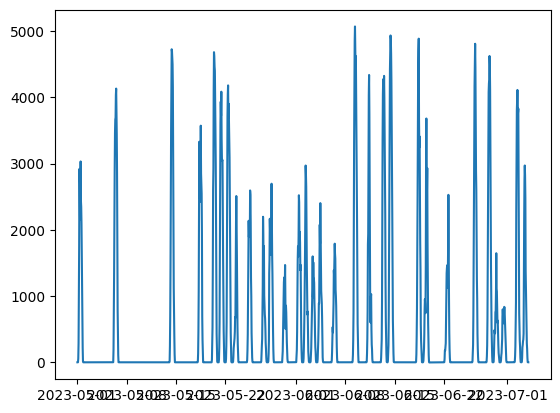

In [ ]:
plt.plot(predictions_a)

### Results and ameliorations with this model

This model got us pretty good results very easily. The main axis of amelioration was the run time limit that we set for the models to run.

We decided to raise that runtime limit and had indeed a better score (148).

## AutoML MLJar

After those two interesting AutoML models, we decided to try one last time AutoML but with AutoML MLJar, that we read to be one of the best AutoML models.

We did exactly the same preprocessing steps as for AutoGLuon, and let it run for 1 hour, for each location.

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from supervised.automl import AutoML

y_train = X_train_a['pv_measurement']
X_train = X_train_a.drop('pv_measurement', axis = 1)

automl = AutoML(mode = 'Compete',
    train_ensemble=True,
    stack_models = True,
    total_time_limit=60*60,
)
automl.fit(X_train, y_train)

predictions = automl.predict(X_test_estimated_a)

Linear algorithm was disabled.
AutoML directory: AutoML_9
The task is regression with evaluation metric rmse
AutoML will use algorithms: ['Decision Tree', 'Random Forest', 'Extra Trees', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network', 'Nearest Neighbors']
AutoML will stack models
AutoML will ensemble available models
AutoML steps: ['adjust_validation', 'simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'kmeans_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'boost_on_errors', 'ensemble', 'stack', 'ensemble_stacked']
* Step adjust_validation will try to check up to 1 model


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

1_DecisionTree rmse 497.737343 trained in 1.49 seconds
Adjust validation. Remove: 1_DecisionTree
Validation strategy: 10-fold CV Shuffle
* Step simple_algorithms will try to check up to 3 models


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

1_DecisionTree rmse 503.098886 trained in 24.01 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

2_DecisionTree rmse 492.763203 trained in 25.86 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

3_DecisionTree rmse 492.763203 trained in 12.63 seconds
* Step default_algorithms will try to check up to 7 models


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

4_Default_LightGBM rmse 358.692098 trained in 357.93 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

5_Default_Xgboost rmse 372.663623 trained in 381.19 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

6_Default_CatBoost rmse 376.161523 trained in 378.12 seconds
* Step not_so_random will try to check up to 63 models


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

16_LightGBM rmse 371.691544 trained in 242.23 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

7_Xgboost rmse 368.711205 trained in 693.49 seconds
Skip golden_features because of the time limit.
Skip kmeans_features because of the time limit.
Not enough time to perform features selection. Skip
Time needed for features selection ~ 718.0 seconds
Please increase total_time_limit to at least (7241 seconds) to have features selection
Skip insert_random_feature because no parameters were generated.
Skip features_selection because no parameters were generated.
* Step hill_climbing_1 will try to check up to 11 models


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

17_LightGBM rmse 360.918436 trained in 291.4 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

18_LightGBM rmse 357.043994 trained in 616.41 seconds
Skip hill_climbing_2 because of the time limit.
Skip boost_on_errors because of the time limit.
* Step ensemble will try to check up to 1 model


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

Ensemble rmse 354.51117 trained in 1.33 seconds
* Step stack will try to check up to 7 models


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

18_LightGBM_Stacked rmse 363.503411 trained in 48.39 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

7_Xgboost_Stacked rmse 363.754034 trained in 70.99 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

6_Default_CatBoost_Stacked rmse 356.730999 trained in 53.05 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

4_Default_LightGBM_Stacked rmse 362.057342 trained in 38.81 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

5_Default_Xgboost_Stacked rmse 358.503049 trained in 48.04 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

17_LightGBM_Stacked rmse 358.17193 trained in 35.1 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

16_LightGBM_Stacked rmse 356.114309 trained in 27.97 seconds
* Step ensemble_stacked will try to check up to 1 model


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

Ensemble_Stacked rmse 353.978373 trained in 2.24 seconds
AutoML fit time: 3393.77 seconds
AutoML best model: Ensemble_Stacked


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.Spa

In [ ]:
automl.report()

Best model,name,model_type,metric_type,metric_value,train_time
,1_DecisionTree,Decision Tree,rmse,503.099,28.76
,2_DecisionTree,Decision Tree,rmse,492.763,26.67
,3_DecisionTree,Decision Tree,rmse,492.763,13.8
,4_Default_LightGBM,LightGBM,rmse,358.692,359.07
,5_Default_Xgboost,Xgboost,rmse,372.664,382.26
,6_Default_CatBoost,CatBoost,rmse,376.162,379.2
,16_LightGBM,LightGBM,rmse,371.692,244.18
,7_Xgboost,Xgboost,rmse,368.711,695.17
,17_LightGBM,LightGBM,rmse,360.918,292.58
,18_LightGBM,LightGBM,rmse,357.044,617.98


In [ ]:
df_pred_a = pd.DataFrame({'prediction' : predictions})

In [ ]:
df_pred_a

,prediction
0,3.569514
1,4.104093
2,4.558374
3,70.248240
4,310.298859
...,...
715,211.991125
716,69.661219
717,5.492935
718,0.097902


In [ ]:
df_pred_a['sun_elevation_a'] = X_test_estimated_a['sun_elevation:d'].values

In [ ]:
df_pred_a['prediction'] = df_pred_a[['prediction', 'sun_elevation_a']].apply(lambda x: 0 if x[1]<0 else x[0], axis=1)

<ipython-input-46-068511bf6b94>:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


In [ ]:
df_pred_a.drop('sun_elevation_a', axis=1, inplace=True)

In [ ]:
df_pred_a['prediction'] = df_pred_a['prediction'].apply(lambda x: pos(x))

In [ ]:
df_pred_a

,prediction
0,0.000000
1,0.000000
2,0.000000
3,70.248240
4,310.298859
...,...
715,211.991125
716,69.661219
717,0.000000
718,0.000000


<Axes: >

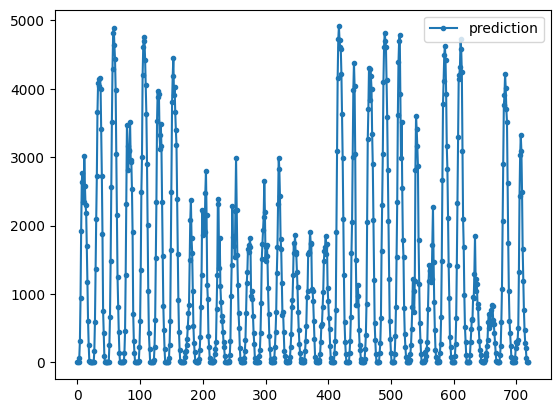

In [ ]:
df_pred_a.plot(marker = '.')

#**Last approach : stacking regression models**

# Final approach

For our last approach, the idea was (as always) to predict pv_measurement independently for each station A, B and C. But this time, we didn't use only one regressor but 3 for each stations: CatBoost, XGBoost and LightGBM.

* For each station, we used 3 differents regressors.
* For each regressor, we trained between 18 (CB) and 27 (XGB and LGBM) combinaisons of hyperparameters on the training set.
  * We evaluated them on the validation set which is an union on previous summers.
  * We select the best ones: those for which the MAE on the validation set is bellow a threshold manually choosen.
  * Then for every selected regressor choosen (1 regressor+hyperparameters), we compute the prediction on test_esimated, and stack (we average them) these predictions.
  * Finally, we average the mean predictions of each type of regressor to obtain the final prediction for each location (for example : df_pred_a = (mean_catboost_a + mean_xgboost_a + mean_lgbm_a)/3)


*Note:* We tried to use a split between train and validation set, but it turns out to be worse with validation set, which we don't really understand why... That's why the validation set (summers) is included in the training set. By averaging prediction, we try to prevent overfitting. The threshold is also not very restrictive (we take a large sample of regressors).


## Preprocessing

First, let's summarize the main parts of the preprocessing used with this approach.

* For this model, we first tried to get rid of any features that would be very correlated to another one in the dataset, because it might be redundant information. To delete them, we examined the correlation between every feature and set a threshold to detect the pairs of correlated features. Then, we manually chose which one to delete, to make sure that we do not accidently delete both correlated features and lose information.

* We used 2 differents data sets: in the first one, we keep NaN values (and then feed CatBoost and XGBoost this data set), and in the second one we impute NaN values (and then feed LightGBM with this data set).
Here are the steps followed during preprocessing :
1. Sampling the data by taking the mean of each feature during an hour.
2. Dropping B and C outliers.
3. Impute NaN with a rolling mean.
4. Add new features:
  - Taking the square of a feature;
  - Multiply 2 features;
5. Scaling
  - Target transformation $y ← \arcsin \left( \frac{y}{\max y} \right)$
  - Apply RobustScaler to the features $X$


  The fact that we have different preprocessing of the missing values for different regressors allows us to add a little bit of diversity into our stacking, which is usually better.

## Prediction for station A
We apply the same steps for B and C (which are not included here).

### Catboost

In [ ]:
X = X_train_a_nan.drop('pv_measurement', axis=1)
y = X_train_a_nan['pv_measurement']

In [ ]:
columns_cleaned = [s.replace(':', '_').replace('^', '_') for s in X.columns]
columns_cleaned_test = [s.replace(':', '_').replace('^', '_') for s in X_test_estimated_a_nan.columns]
columns_cleaned_train = [s.replace(':', '_').replace('^', '_') for s in X_train_a_nan.columns]


X = X.rename(columns=dict(zip(X.columns, columns_cleaned)))
X_test_estimated_a_nan = X_test_estimated_a_nan.rename(columns=dict(zip(X_test_estimated_a_nan, columns_cleaned_test)))
X_train_a_nan = X_train_a_nan.rename(columns=dict(zip(X_train_a_nan, columns_cleaned_train)))

In [ ]:
# Create a list of CatBoostRegressor models for each combination
cb_models = [cb.CatBoostRegressor(n_estimators=n,
                                  learning_rate=lr,
                                  depth=d,
                                  #l2_leaf_reg=l2,
                                  #subsample=subsample,
                                  loss_function=loss) \
             for n, lr, d, loss in all_param_combinations_cb]

In [ ]:
for model in tqdm(cb_models):
  model.fit(X,y, logging_level='Silent')

100%|██████████| 18/18 [30:00<00:00, 100.04s/it]


In [ ]:
mae = lambda y,y_hat: ((y_hat)-y).abs().mean().round()

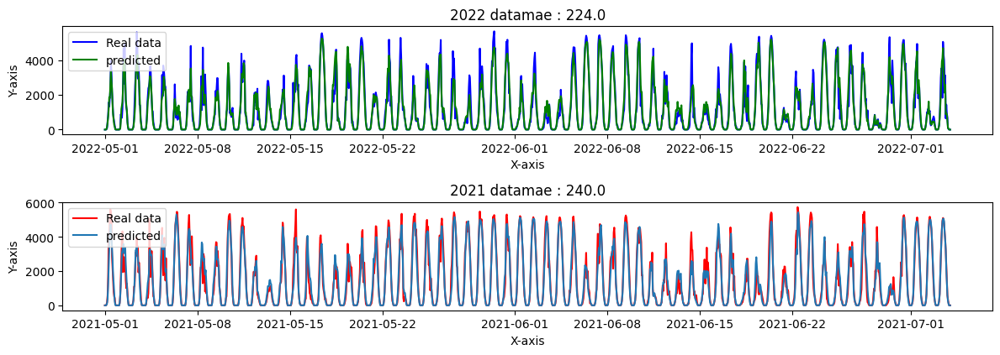

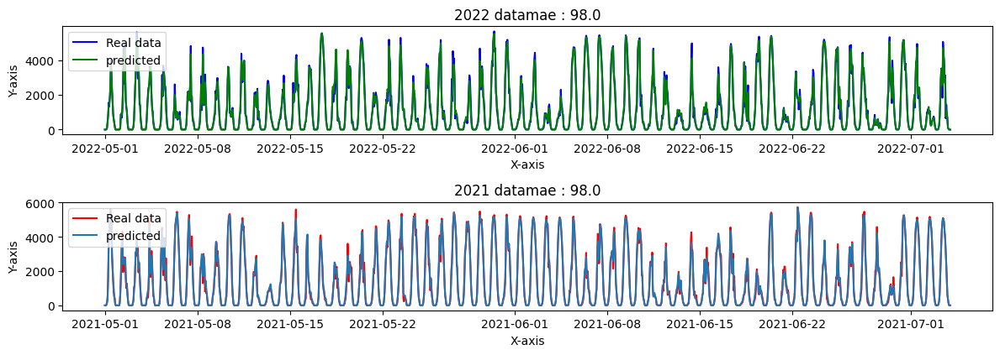

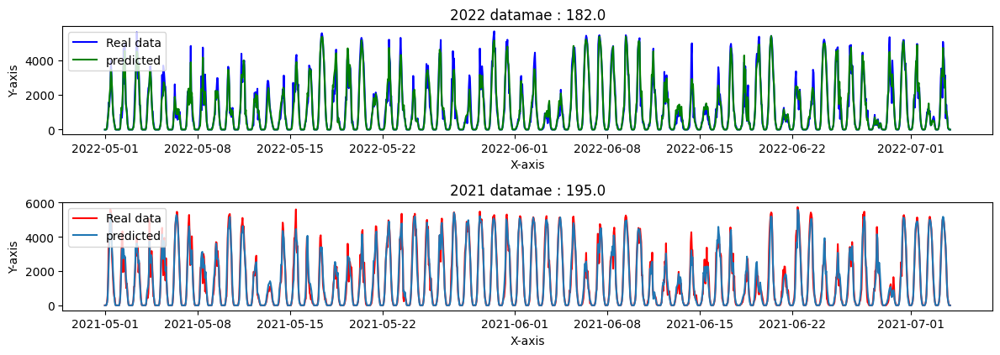

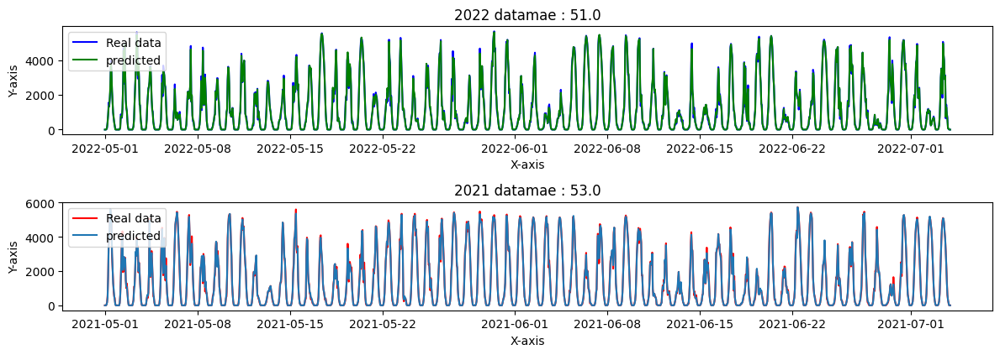

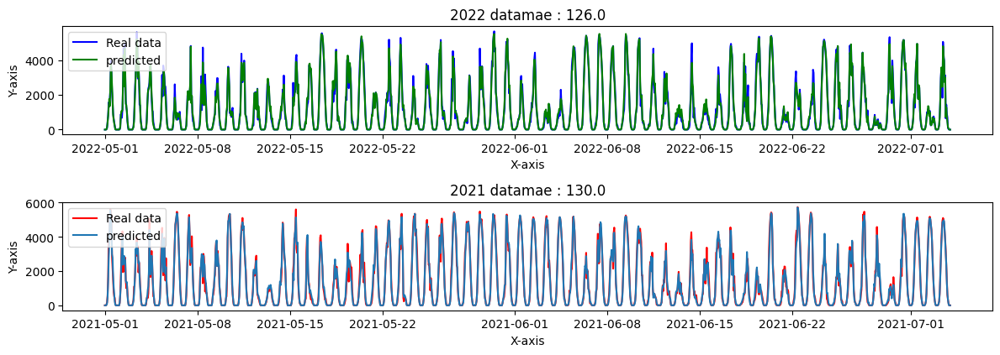

...

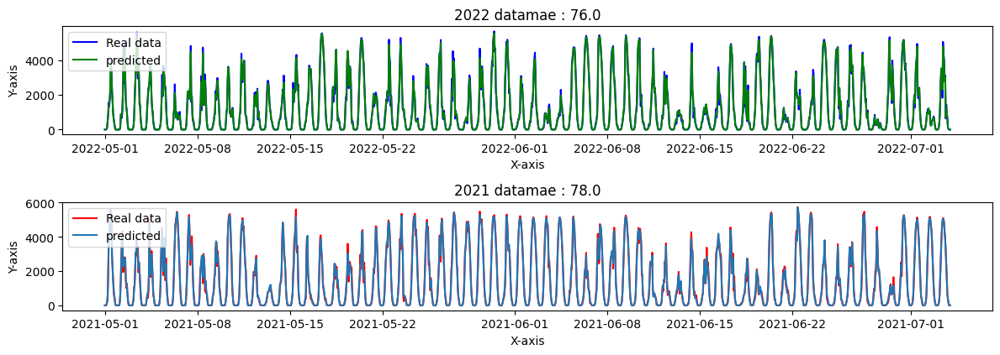

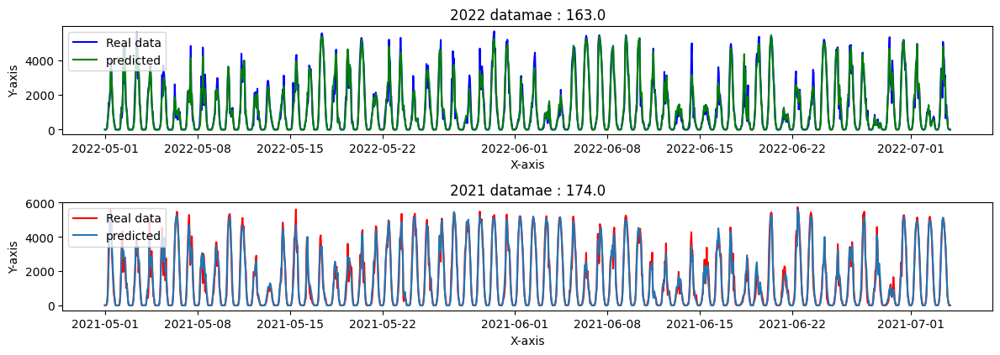

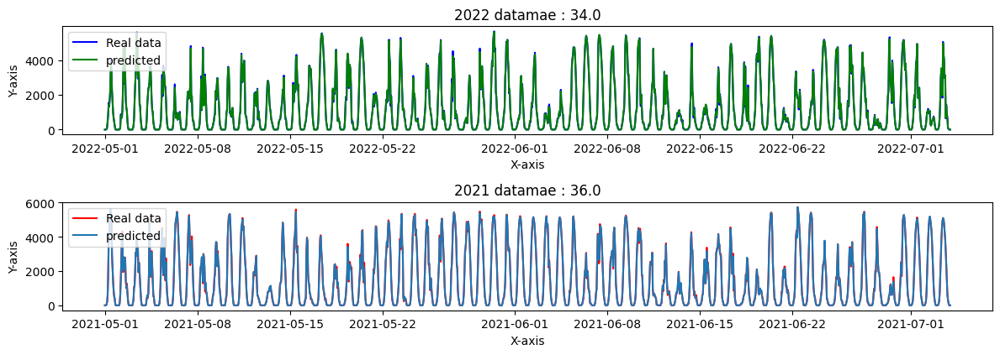

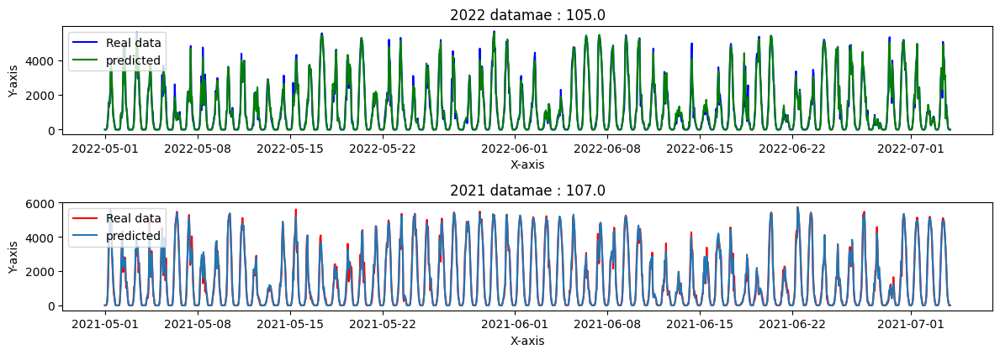

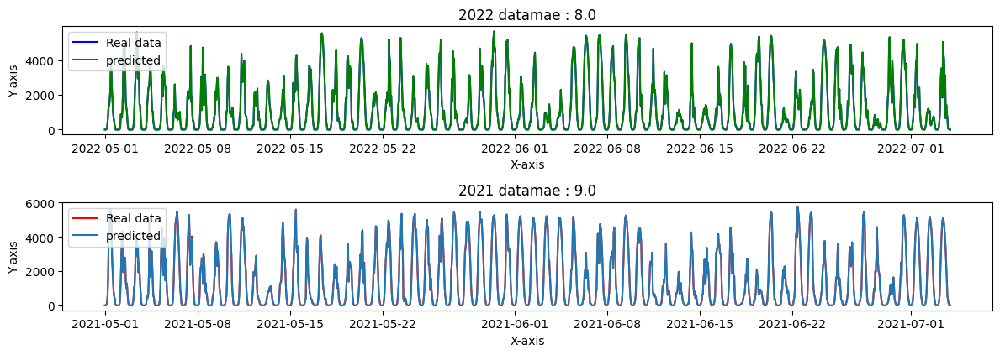

5

In [ ]:
final_cb_models, best_param = [], []
scores = []

for i, model in enumerate(cb_models):
  fig=plt.figure(figsize=(12, 6))
  # Create the first subplot
  plt.subplot(3, 1, 1)  # 1 row, 2 columns, first subplot
  y_2022 = t(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].pv_measurement) * max_a
  y_pred_2022 = t(model.predict(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].drop('pv_measurement', axis = 1))) * max_a

  plt.plot(t(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].pv_measurement) * max_a, label='Real data', color='blue')
  plt.plot(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].index, y_pred_2022,label='predicted', color='green')
  plt.xlabel('X-axis')
  plt.ylabel('Y-axis')
  plt.title('2022 data' + 'mae : ' + str(mae(y_2022, y_pred_2022)))
  plt.legend()


  # Create the second subplot
  plt.subplot(3, 1, 2)  # 1 row, 2 columns, second subplot
  y_2021 = t(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].pv_measurement) * max_a
  y_pred_2021 = t(model.predict(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].drop('pv_measurement', axis = 1))) * max_a

  plt.plot(t(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].pv_measurement) * max_a, label='Real data', color='red')
  plt.plot(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].index , y_pred_2021, label = 'predicted')
  plt.xlabel('X-axis')
  plt.ylabel('Y-axis')
  plt.title('2021 data' + 'mae : ' + str(mae(y_2021, y_pred_2021)))
  plt.legend()

  scores.append((mae(y_2022, y_pred_2022)+ mae(y_2021, y_pred_2021))/2)

  # Adjust layout to prevent overlap
  plt.tight_layout()

  # Show the plots
  plt.show()

summary = {}
q = 43
for i in range(len(scores)):
  if  scores[i] <= q:
    final_cb_models.append(cb_models[i])
    best_param.append(all_param_combinations_cb[i])
    summary[all_param_combinations_cb[i]] = scores[i]
len(final_cb_models)


In [ ]:
summary

{(600, 0.5, 10, 'RMSE'): 14.5,
 (700, 0.2, 10, 'RMSE'): 42.5,
 (700, 0.5, 10, 'RMSE'): 11.0,
 (800, 0.2, 10, 'RMSE'): 35.0,
 (800, 0.5, 10, 'RMSE'): 8.5}

In [ ]:
final_cb_predictions = []
for model in final_cb_models :
  final_cb_predictions.append(t(model.predict(X_test_estimated_a_nan)) * max_a)

mean_cb_prediction_a = np.mean(final_cb_predictions, axis = 0)

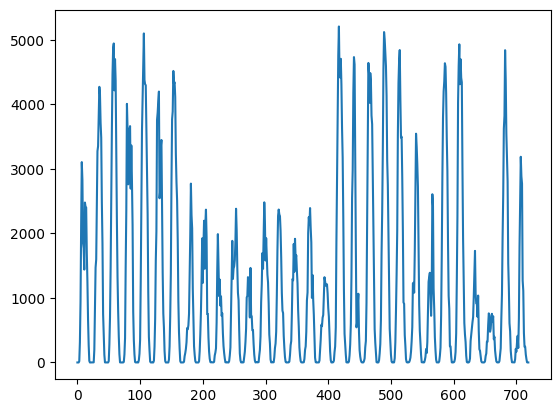

In [ ]:
plt.plot(mean_cb_prediction_a)

### XGB

In [ ]:
X = X_train_a_nan.drop('pv_measurement', axis=1)
y = X_train_a_nan['pv_measurement']

In [ ]:
columns_cleaned = [s.replace(':', '_').replace('^', '_') for s in X.columns]
columns_cleaned_test = [s.replace(':', '_').replace('^', '_') for s in X_test_estimated_a_nan.columns]
columns_cleaned_train = [s.replace(':', '_').replace('^', '_') for s in X_train_a_nan.columns]


X = X.rename(columns=dict(zip(X.columns, columns_cleaned)))
X_test_estimated_a_nan = X_test_estimated_a_nan.rename(columns=dict(zip(X_test_estimated_a_nan, columns_cleaned_test)))
X_train_a_nan = X_train_a_nan.rename(columns=dict(zip(X_train_a_nan, columns_cleaned_train)))

In [ ]:
# Create a list of CatBoostRegressor models for each combination
xgb_models = [xgb.XGBRegressor(learning_rate=lr,
                               max_depth=md,
                               n_estimators=ne
                               ) \
             for lr, md, ne in all_param_combinations_xgb]

In [ ]:
for model in tqdm(xgb_models):
  model.fit(X,y)

100%|██████████| 27/27 [05:48<00:00, 12.89s/it]


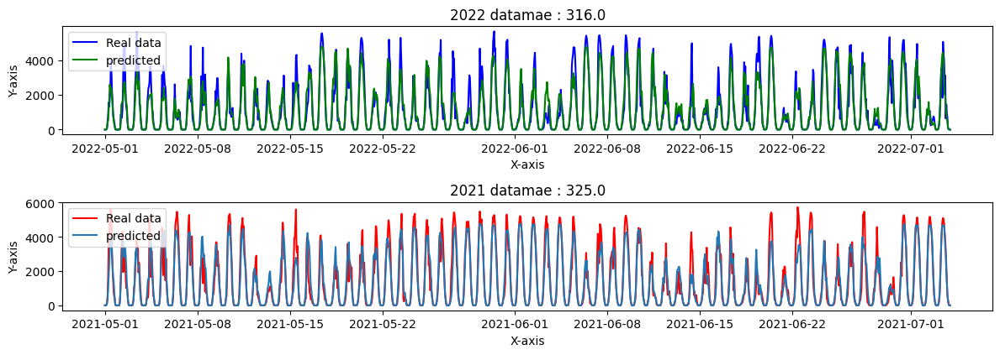

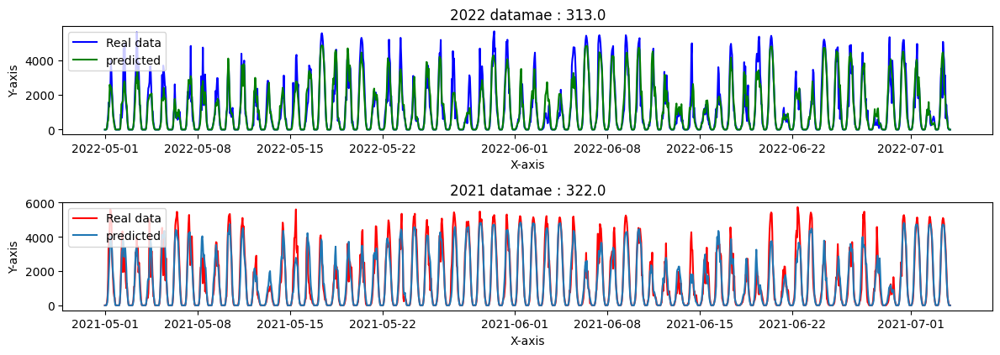

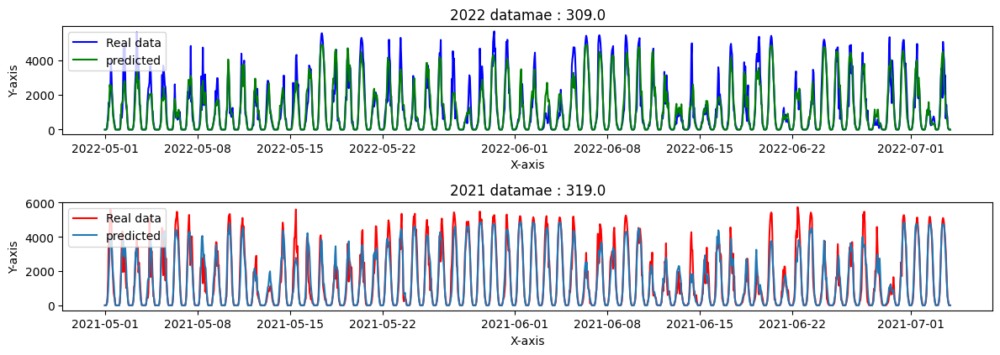

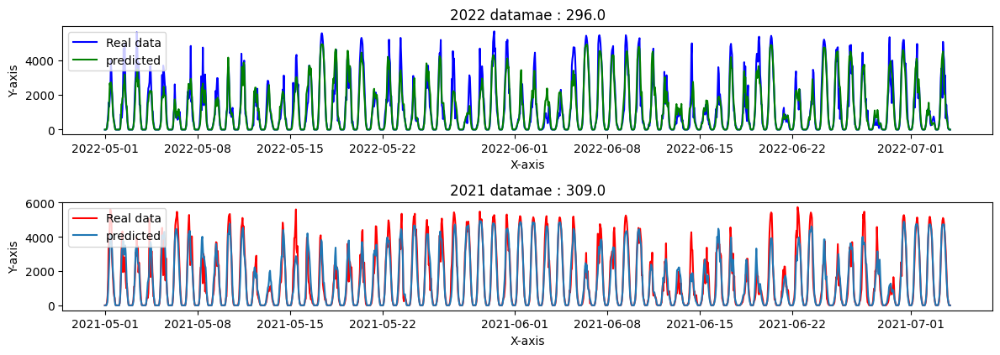

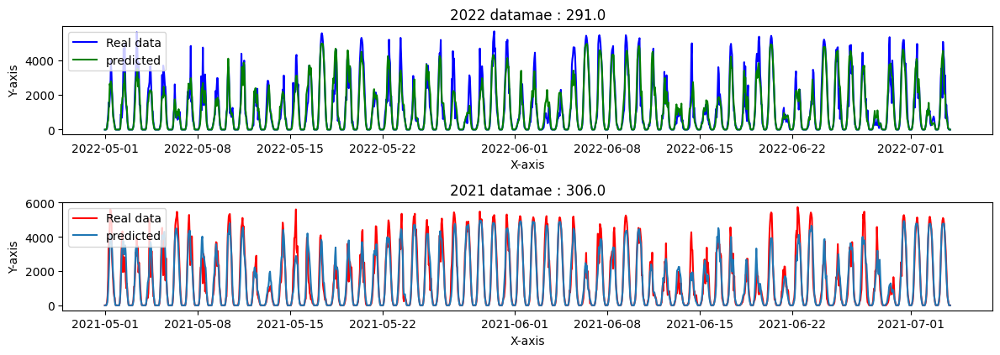

...

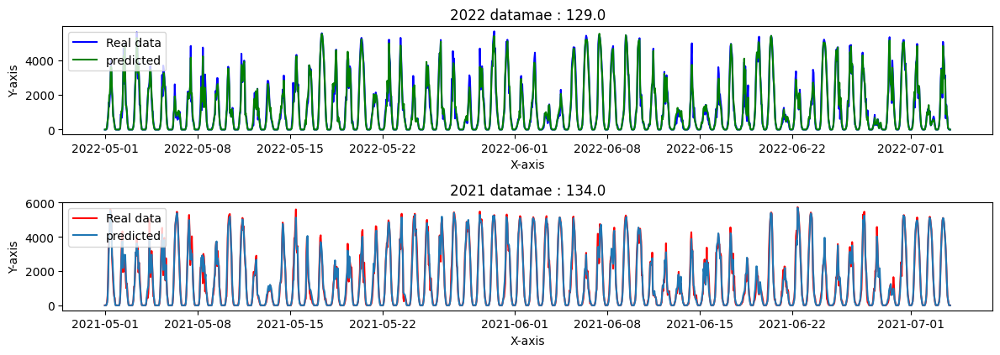

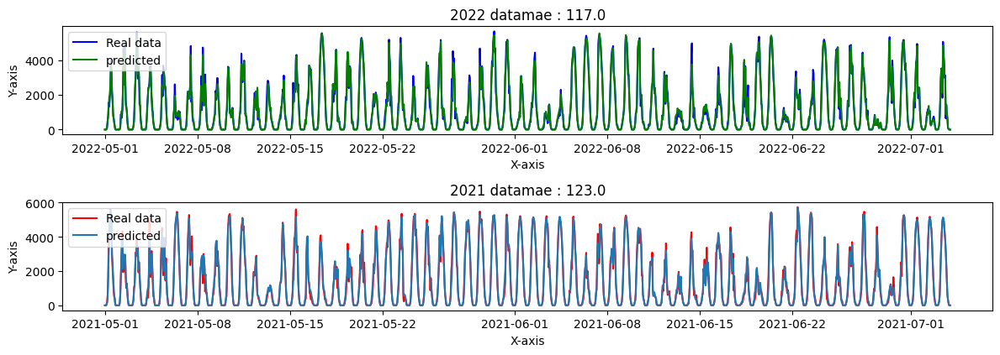

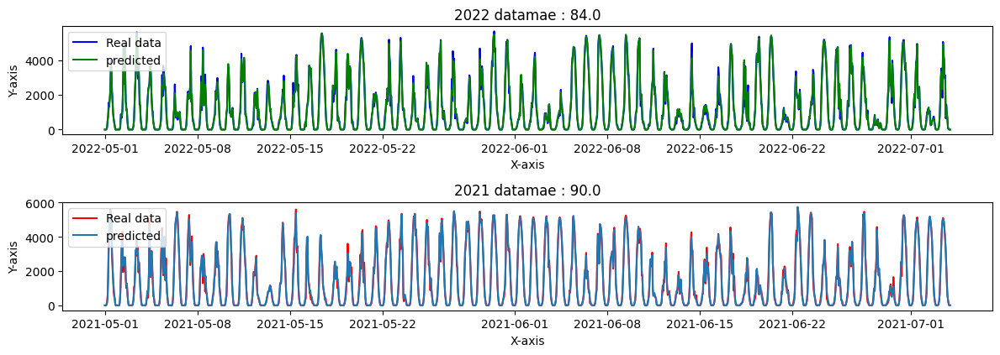

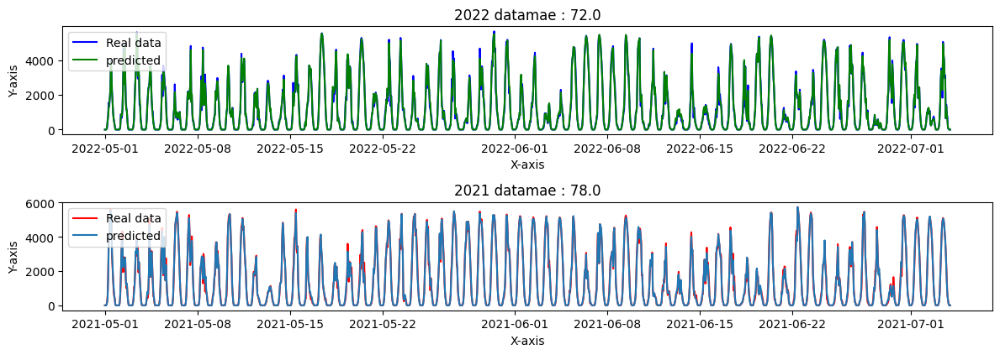

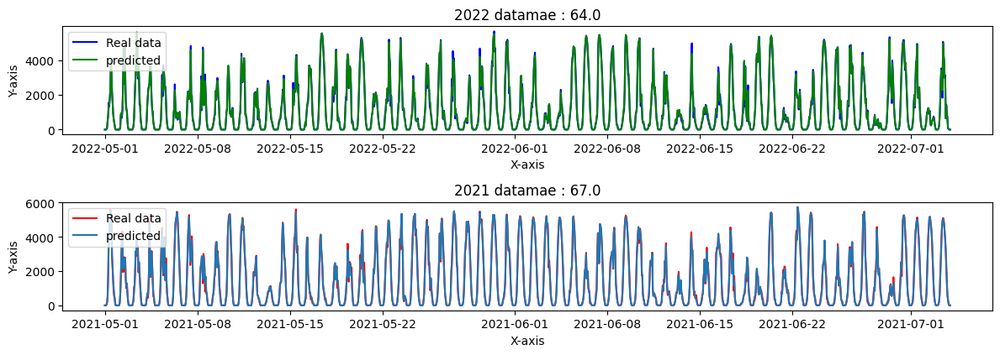

5

In [ ]:
final_xgb_models, best_param = [], []
scores = []

for model in (xgb_models):
  fig=plt.figure(figsize=(12, 6))
  # Create the first subplot
  plt.subplot(3, 1, 1)  # 1 row, 2 columns, first subplot
  y_2022 = t(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].pv_measurement) * max_a
  y_pred_2022 = t(model.predict(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].drop('pv_measurement', axis = 1))) * max_a

  plt.plot(t(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].pv_measurement) * max_a, label='Real data', color='blue')
  plt.plot(X_train_a_nan.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].index, y_pred_2022,label='predicted', color='green')
  plt.xlabel('X-axis')
  plt.ylabel('Y-axis')
  plt.title('2022 data' + 'mae : ' + str(mae(y_2022, y_pred_2022)))
  plt.legend()


  # Create the second subplot
  plt.subplot(3, 1, 2)  # 1 row, 2 columns, second subplot
  y_2021 = t(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].pv_measurement) * max_a
  y_pred_2021 = t(model.predict(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].drop('pv_measurement', axis = 1))) * max_a

  plt.plot(t(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].pv_measurement) * max_a, label='Real data', color='red')
  plt.plot(X_train_a_nan.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].index , y_pred_2021, label = 'predicted')
  plt.xlabel('X-axis')
  plt.ylabel('Y-axis')
  plt.title('2021 data' + 'mae : ' + str(mae(y_2021, y_pred_2021)))
  plt.legend()

  scores.append((mae(y_2022, y_pred_2022)+ mae(y_2021, y_pred_2021))/2)

  # Adjust layout to prevent overlap
  plt.tight_layout()

  # Show the plots
  plt.show()

summary = {}
q = 120
for i in range(len(scores)):
  if  scores[i] <= q:
    final_xgb_models.append(xgb_models[i])
    best_param.append(all_param_combinations_xgb[i])
    summary[all_param_combinations_xgb[i]] = scores[i]
len(final_xgb_models)

In [ ]:
print(len(final_xgb_models))

5


In [ ]:
summary

{(0.1, 5, 800): 117.5,
 (0.2, 4, 800): 120.0,
 (0.2, 5, 600): 87.0,
 (0.2, 5, 700): 75.0,
 (0.2, 5, 800): 65.5}

In [ ]:
final_xgb_predictions = []
for model in final_xgb_models :
  final_xgb_predictions.append(t(model.predict(X_test_estimated_a_nan)) * max_a)

mean_xgb_prediction_a = np.mean(final_xgb_predictions, axis = 0)

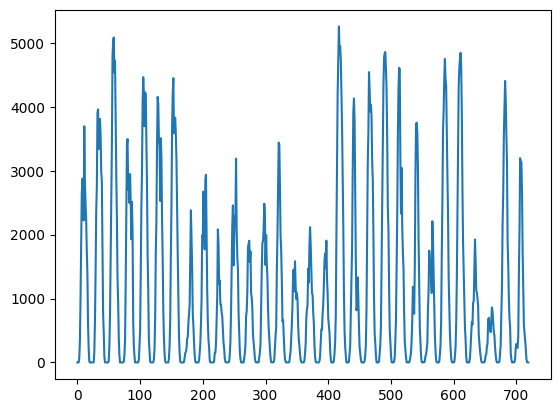

In [ ]:
plt.plot(mean_xgb_prediction_a)

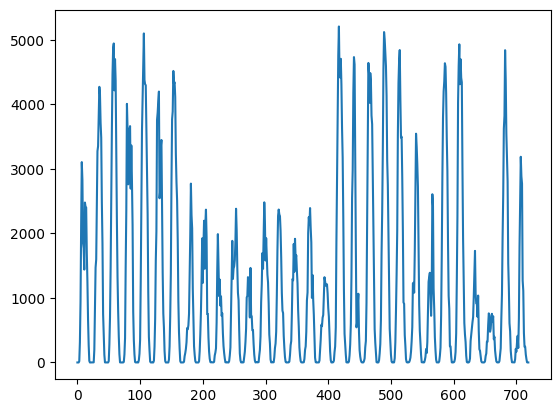

In [ ]:
plt.plot(mean_cb_prediction_a)

### LGB

In [ ]:
X = X_train_a_impute.drop('pv_measurement', axis=1)
y = X_train_a_impute['pv_measurement']

In [ ]:
columns_cleaned = [s.replace(':', '_').replace('^', '_') for s in X.columns]
columns_cleaned_test = [s.replace(':', '_').replace('^', '_') for s in X_test_estimated_a_impute.columns]
columns_cleaned_train = [s.replace(':', '_').replace('^', '_') for s in X_train_a_impute.columns]


X = X.rename(columns=dict(zip(X.columns, columns_cleaned)))
X_test_estimated_a_impute = X_test_estimated_a_impute.rename(columns=dict(zip(X_test_estimated_a_impute, columns_cleaned_test)))
X_train_a_impute = X_train_a_impute.rename(columns=dict(zip(X_train_a_impute, columns_cleaned_train)))

In [ ]:
# Create a list of CatBoostRegressor models for each combination
lgbm_models = [lgb.LGBMRegressor(n_estimators=ne,
                                 max_depth=md,
                                 learning_rate=lr,
                                 #reg_alpha = reg,
                                 verbose=-1) \
             for ne, md, lr in all_param_combinations_lgbm]

In [ ]:
len(lgbm_models)

27

In [ ]:
for model in tqdm(lgbm_models):
  model.fit(X,y)

100%|██████████| 27/27 [03:49<00:00,  8.50s/it]


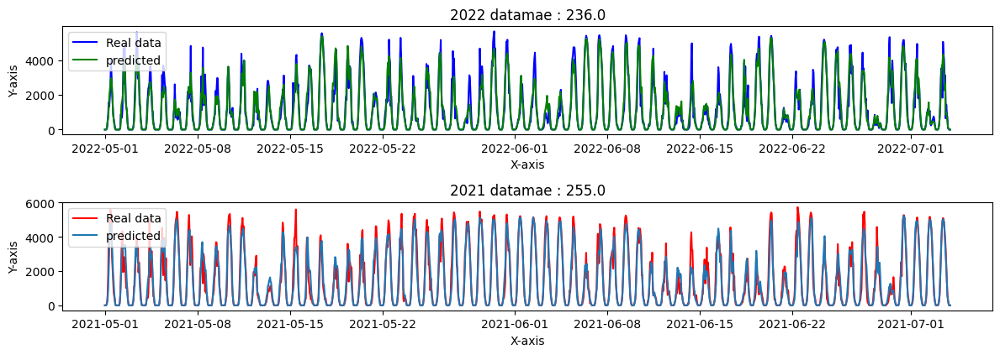

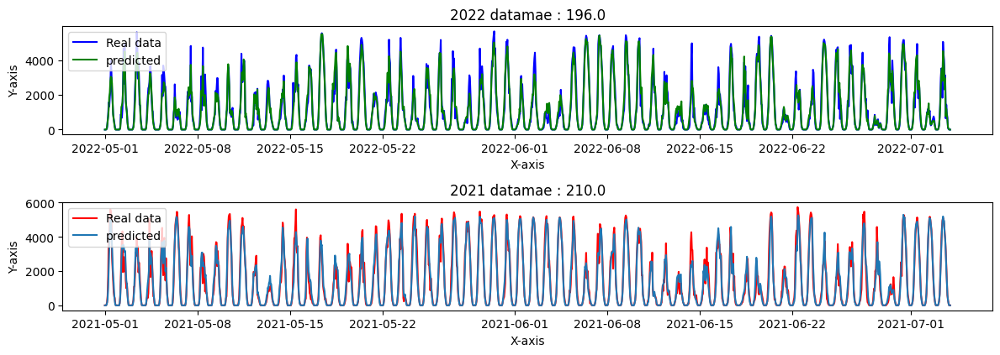

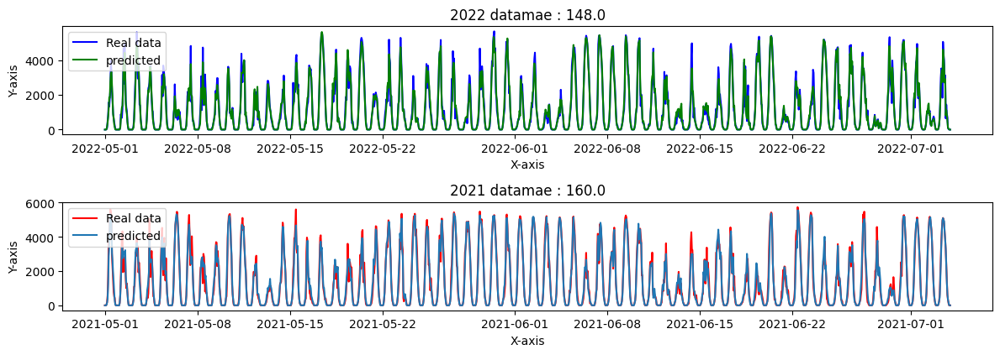

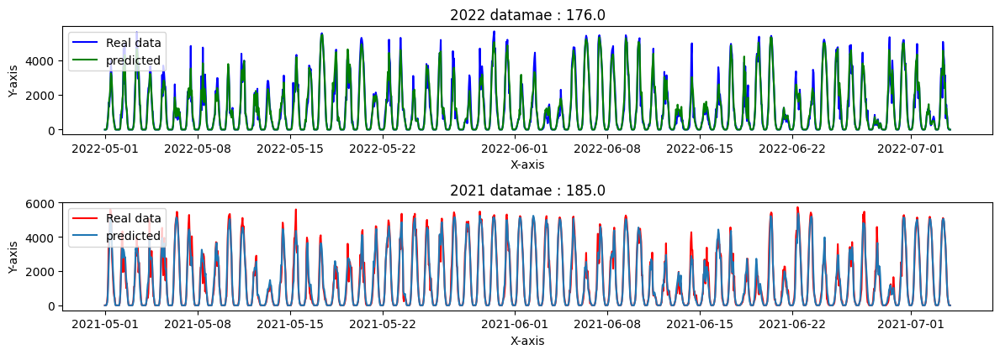

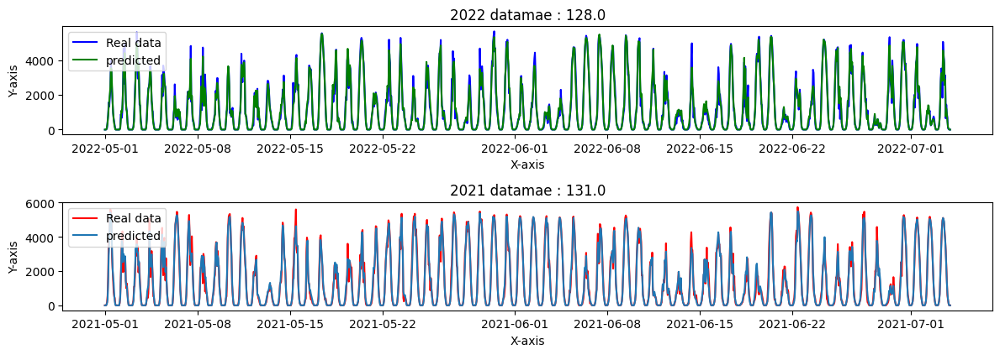

...

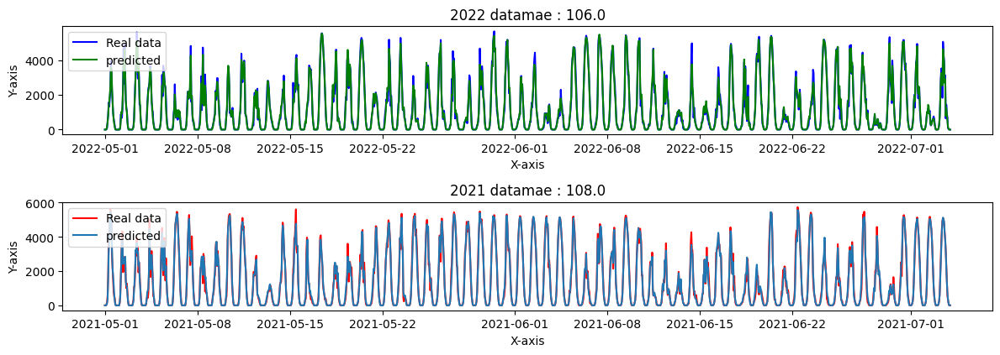

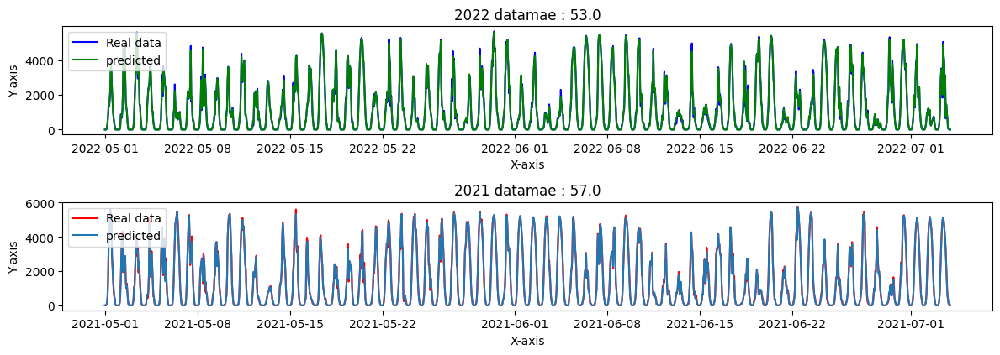

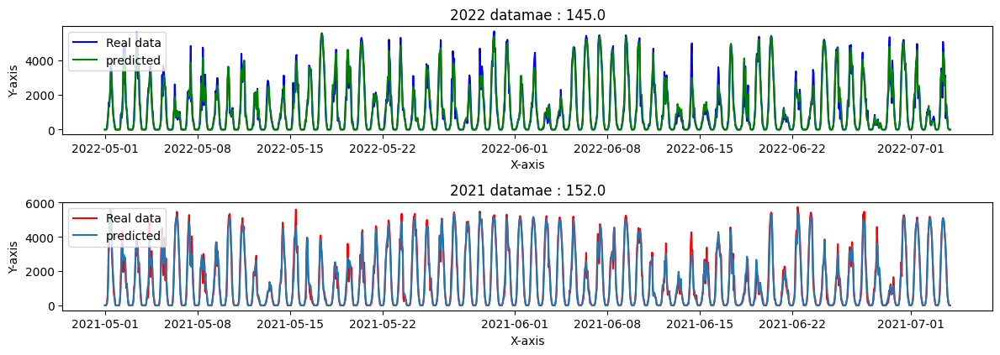

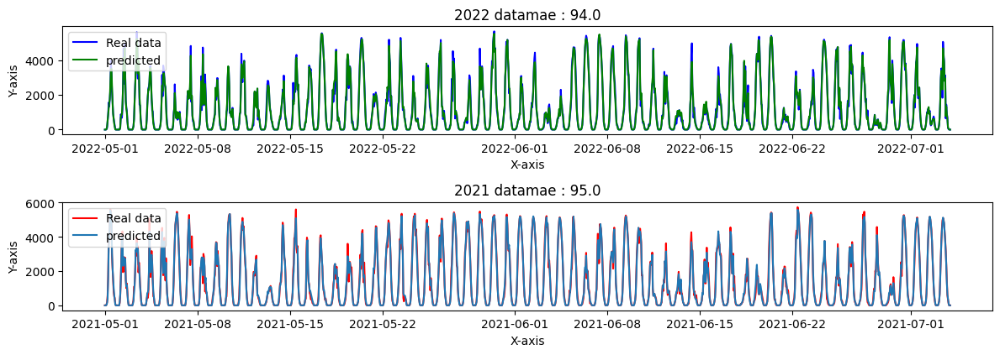

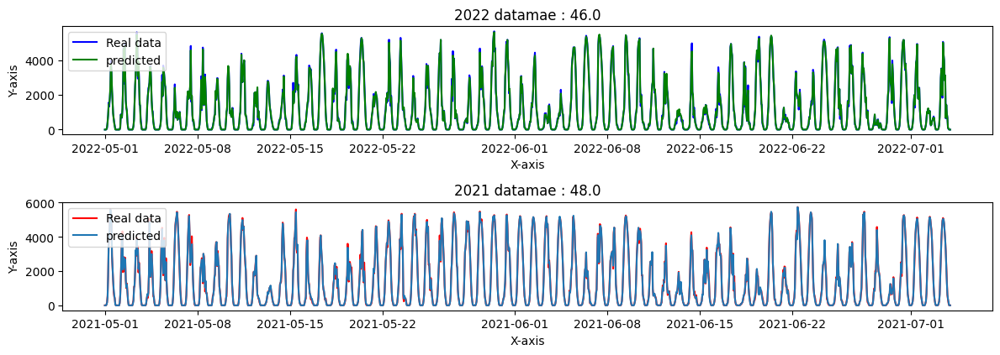

5

In [ ]:
final_lgbm_models, best_param = [], []
scores=[]

for model in lgbm_models :
  fig=plt.figure(figsize=(12, 6))
  # Create the first subplot

  plt.subplot(3, 1, 1)  # 1 row, 2 columns, first subplot
  y_2022 = t(X_train_a_impute.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].pv_measurement) * max_a
  y_pred_2022 = t(model.predict(X_train_a_impute.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].drop('pv_measurement', axis = 1))) * max_a

  plt.plot(t(X_train_a_impute.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].pv_measurement) * max_a, label='Real data', color='blue')
  plt.plot(X_train_a_impute.loc['2022-05-01 00:00:00':'2022-07-03 23:00:00'].index, y_pred_2022,label='predicted', color='green')
  plt.xlabel('X-axis')
  plt.ylabel('Y-axis')
  plt.title('2022 data' + 'mae : ' + str(mae(y_2022, y_pred_2022)))
  plt.legend()


  # Create the second subplot
  plt.subplot(3, 1, 2)  # 1 row, 2 columns, second subplot
  y_2021 = t(X_train_a_impute.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].pv_measurement) * max_a
  y_pred_2021 = t(model.predict(X_train_a_impute.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].drop('pv_measurement', axis = 1))) * max_a

  plt.plot(t(X_train_a_impute.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].pv_measurement) * max_a, label='Real data', color='red')
  plt.plot(X_train_a_impute.loc['2021-05-01 00:00:00':'2021-07-03 23:00:00'].index , y_pred_2021, label = 'predicted')
  plt.xlabel('X-axis')
  plt.ylabel('Y-axis')
  plt.title('2021 data' + 'mae : ' + str(mae(y_2021, y_pred_2021)))
  plt.legend()


  scores.append((mae(y_2022, y_pred_2022) + mae(y_2021, y_pred_2021))/2)


  # Adjust layout to prevent overlap
  plt.tight_layout()

  # Show the plots
  plt.show()

summary = {}
q = 70
for i in range(len(scores)):
  if  scores[i] <= q:
    final_lgbm_models.append(lgbm_models[i])
    best_param.append(all_param_combinations_lgbm[i])
    summary[all_param_combinations_lgbm[i]] = scores[i]
len(final_lgbm_models)

In [ ]:
(len(final_lgbm_models))

5

In [ ]:
summary

{(600, 8, 0.2): 66.5,
 (700, 6, 0.2): 64.0,
 (700, 8, 0.2): 55.0,
 (800, 6, 0.2): 55.0,
 (800, 8, 0.2): 47.0}

In [ ]:
final_lgbm_predictions = []
for model in final_lgbm_models :
  final_lgbm_predictions.append(t(model.predict(X_test_estimated_a_impute)) * max_a)

mean_lgbm_prediction_a = np.mean(final_lgbm_predictions, axis = 0)

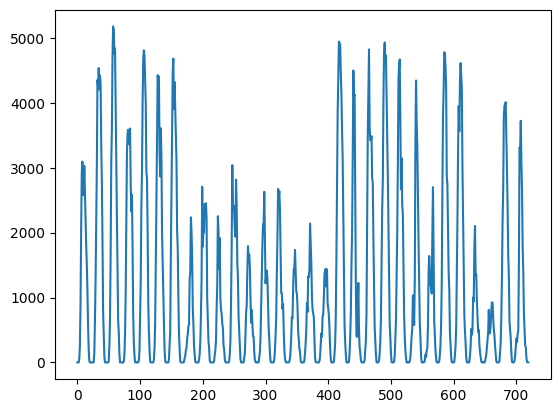

In [ ]:
plt.plot(mean_lgbm_prediction_a)

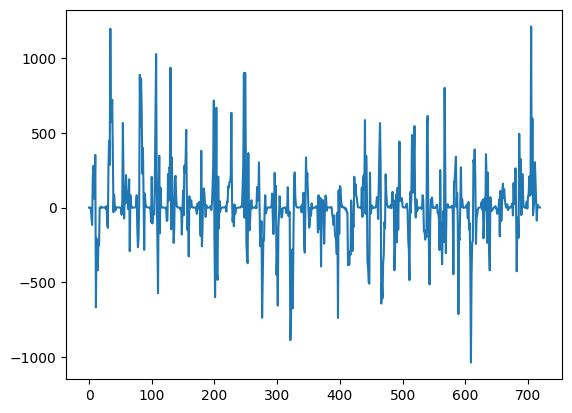

In [ ]:
plt.plot(mean_lgbm_prediction_a - mean_xgb_prediction_a)

### Stack

In [ ]:
pred_a = (mean_cb_prediction_a + mean_lgbm_prediction_a + mean_xgb_prediction_a)/3

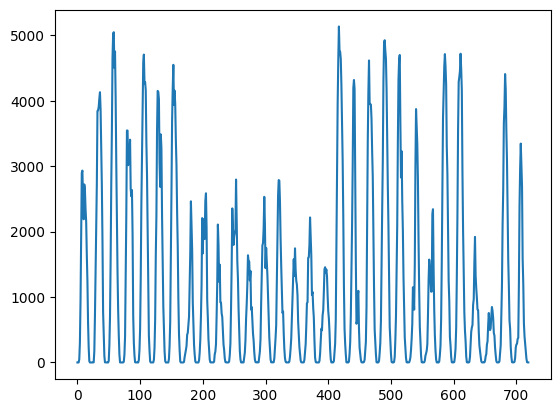

In [ ]:
plt.plot(pred_a)

In [ ]:
df_pred_a = pd.DataFrame({'prediction' : pred_a})
df_pred_a.set_index(X_test_estimated_a.index, inplace = True)

## Features importances

Example of feature importances for one of the Catboost models for Location A

Text(0.5, 1.0, 'Feature Importance')

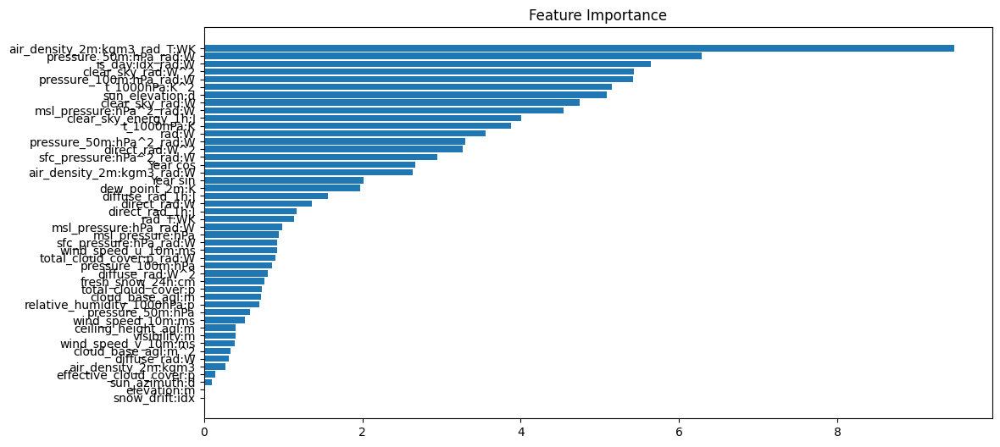

In [ ]:
feature_importance = final_cb_models[0].feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(12, 6))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X_c.columns)[sorted_idx])
plt.title('Feature Importance')


## Post processing and gathering of the predictions

In [ ]:
df_pred_a['sun_elevation_a'] = X_test_estimated_a['sun_elevation:d'].values

In [ ]:
df_pred_a['prediction'] = df_pred_a[['prediction', 'sun_elevation_a']].apply(lambda x: 0 if x[1]<0 else x[0], axis=1)

<ipython-input-46-068511bf6b94>:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


In [ ]:
df_pred_a.drop('sun_elevation_a', axis=1, inplace=True)

In [ ]:
df_pred_a['prediction'] = df_pred_a['prediction'].apply(lambda x: pos(x))

We do the same for B and C and we put alltogether

In [ ]:
df_pred_total = pd.concat([df_pred_a, df_pred_b, df_pred_c], axis = 0)
df_pred_final = pd.DataFrame({'id' : [i for i in range(2160)], 'prediction' : df_pred_total['prediction'].to_numpy()})
#df_pred_total
df_pred_final[:]

,id,prediction
0,0,0.000000
1,1,0.000000
2,2,0.000000
3,3,60.095803
4,4,317.040575
...,...,...
2155,2155,67.317359
2156,2156,31.440282
2157,2157,0.000000
2158,2158,0.000000


In [ ]:
df_pred_final.to_csv('submission_115.csv', index = False)

## Results and ameliorations of the model

This model has worked the best for us. We managed to get a score of 145.6 with this model, with the right hyperparameters.
We tried a lot of different things with this model, but we truly hit a ceiling glass...

One thing that we really tried to work on, is the hyperparameters tuning. The main issue that we faced is that we had completely opposite results between our hyperparameters tuning (with a grid search CV for instance) and our results on Kaggle...

Whenever we tried to choose relevant hyperparameters using well-known tools like RandomSearch CV or Optuna, the parameters returned by those tools would perform really badly on Kaggle. However, when we choose completely opposite hyperparameters from those tools, we would get much better score on Kaggle ! For instance, choosing higher `n_estimators` and higher `learning_rate` would perform a lot more each time...

We are quite worried that we are overfitting... But at the same time we are averaging so many models together and we kept a threshold quite high on the MAE... and nothing else seemed to work, despite our efforts !


A part from that, we tried a lot of other things to improve our score :


*   Used a real validation set to tune the hyperparameters
*   Tried to give more diversity to the stack, by doing different preprocessing to different models. For instance we tried normalizing the data with different scaler : a MinMaxScaler() for Catboost and XGBoost and a RobustScaler() for LightGBM.
*   We also tried to change the way we sample the data, by taking for one model the value at the 45th minute of every hour, taking the mean for another model, and the maximum value of every hour for the last model. Unfortunately, It didn't manage to give us a better score...
*   We also tried to keep more values of the dataset, by adding more features to represent the features every 15 minutes. For example, add a `direct_rad_15_min:W`, `direct_rad_30_min:W` and so on... Because it adds a lot of features, we only did that for the features that have a high feature importance in the models we use. Unfortunately for us, once again, this idea did not improve our score...
*  Finally, we tried to predict better the highest value. To do so, after every mean prediction, we would look at the highest value predicted (with a certain threshold) and try to refit the models without the null values to predict once again those values. Because the models would not be trained on all those zeros, it should allow us not to underestimate the pv_measurement. Unfortunately, we tried various thresholds and every single one of them gave us a worse score...

Here are some parts of the code to obtain the previous bulletpoints.



1.   **A RandomSearchCV to search the right hyperparameters for the 3 models**

We give the example for the Catboost, XGBoost and LGBM models for location A only.




In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint


#Instantiate CatBoostClassifier
cbc = cb.CatBoostRegressor()

# Creating the hyperparameter grid
param_dist = { "learning_rate": np.linspace(0,0.5,5),\
               'depth': randint(3, 10),\
               'n_estimators' : randint(700, 900),\
               'learning_rate' : np.linspace(0.05, 0.5, 5),\
               'loss_function': ['RMSE']}

#Instantiate RandomSearchCV object
rscv = RandomizedSearchCV(cbc , param_dist, scoring='neg_mean_absolute_error', cv =5)

#Fit the model
rscv.fit(X,y)

# Print the tuned parameters and score
print(rscv.best_params_)
print(rscv.best_score_)

In [ ]:
print(rscv.best_params_)

{'depth': 7, 'learning_rate': 0.05, 'loss_function': 'RMSE', 'n_estimators': 884}


In [ ]:
print(rscv.best_score_)

-0.04740104256490881


In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint


#Instantiate CatBoostClassifier
cbc = xgb.XGBRegressor()

# Creating the hyperparameter grid
param_dist = { "learning_rate": np.linspace(0,0.2,5),\
               'max_depth': randint(3, 10),\
               'n_estimators' : randint(100, 900),\
               }

#Instantiate RandomSearchCV object
rscv = RandomizedSearchCV(cbc , param_dist, scoring='neg_mean_absolute_error', cv =5)

#Fit the model
rscv.fit(X,y)

# Print the tuned parameters and score
print(rscv.best_params_)
print(rscv.best_score_)

{'learning_rate': 0.05, 'max_depth': 8, 'n_estimators': 281}
-0.04711470552221344


In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint


#Instantiate CatBoostClassifier
cbc = lgb.LGBMRegressor()

# Creating the hyperparameter grid
param_dist = { "learning_rate": np.linspace(0,0.2,5),\
               'max_depth': randint(3, 10),\
               'n_estimators' : randint(100, 900),\
               }

#Instantiate RandomSearchCV object
rscv = RandomizedSearchCV(cbc , param_dist, scoring='neg_mean_absolute_error', cv =5)

#Fit the model
rscv.fit(X,y)

# Print the tuned parameters and score
print(rscv.best_params_)
print(rscv.best_score_)

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint


#Instantiate CatBoostClassifier
cbc = lgb.LGBMRegressor()

# Creating the hyperparameter grid
param_dist = { "learning_rate": np.linspace(0,0.2,5),\
               'max_depth': randint(3, 10),\
               'n_estimators' : randint(100, 900),\
               }

#Instantiate RandomSearchCV object
rscv = RandomizedSearchCV(cbc , param_dist, scoring='neg_mean_absolute_error', cv =5)

#Fit the model
rscv.fit(X,y)

# Print the tuned parameters and score
print(rscv.best_params_)
print(rscv.best_score_)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014642 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 15418
[LightGBM] [Info] Number of data points in the train set: 27248, number of used features: 75
[LightGBM] [Info] Start training from score 0.223314
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leave

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
25 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/sklearn.py", line 1049, in fit
    super().fit(
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/sklearn.py", line 842, in fit
    self._Booster = train(
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/engine.py", line 255, in train
    boost

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016970 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 15559
[LightGBM] [Info] Number of data points in the train set: 34061, number of used features: 75
[LightGBM] [Info] Start training from score 0.215424
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
{'learning_rate': 0.05, 'max

2. **Using data every 15 minutes.**

Usually, we would use an aggregation function to resample the data from $X$. Instead of taking the mean on each hour for each features, we can also create new features which contain the value of a feature at o'clock, 15", 30" and 45". But that way, we can reach more than 200 features, even 300 (with polynomial feature). The "curse of dimensionality" stands that "As the number of features grows, the amout of data we need to generalize accurately grows exponentially". Hence, we tried to apply feature selection to keep less features. That's why we selected only a few features (in ```old_plus```). This approach is motivated by looking at the variance of some features, within an hour. Those values can vary a lot. Moreover, taking the mean for one hour leads to wasting information.

With the function ```_15_```, we add new columns from ```old_plus```.




<Axes: xlabel='date_forecast'>

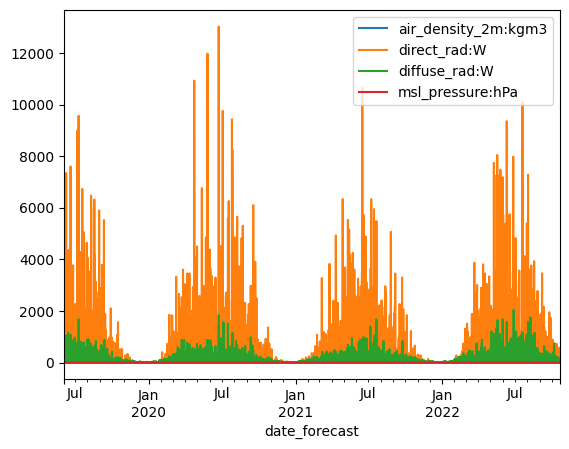

In [ ]:
X_train_observed_a[old_plus].resample('H').var().plot()

In [ ]:
old_plus = ['air_density_2m:kgm3', # air*rad
       'direct_rad:W', #rad,
        'diffuse_rad:W',
       'msl_pressure:hPa',] #msl *rad

In [ ]:
from tqdm import tqdm

In [ ]:
def _15_(X_train_observed_a):
  X_train_observed_a['minute'] = X_train_observed_a.index.minute
  for f in tqdm(old_plus[:]):
    for minute in [0, 15, 30, 45]:
      X_train_observed_a[f'{f}_{minute}'] = X_train_observed_a[[f'{f}', 'minute']].apply(lambda x : x[0] if x[1]==(minute) else None, axis=1)
      fe = X_train_observed_a[f'{f}_{minute}'].resample('1H').max() # or mean ?
      X_train_observed_a[f'{f}_{minute}'] = fe
  X_train_observed_a.drop('minute', axis=1, inplace=True)
  return X_train_observed_a

In [ ]:
X_train_observed_a = _15_(X_train_observed_a)
X_train_observed_b = _15_(X_train_observed_b)
X_train_observed_c = _15_(X_train_observed_c)

X_train_estimated_a = _15_(X_train_estimated_a)
X_train_estimated_b = _15_(X_train_estimated_c)
X_train_estimated_c = _15_(X_train_estimated_c)

X_test_estimated_a = _15_(X_test_estimated_a)
X_test_estimated_b = _15_(X_test_estimated_b)
X_test_estimated_c = _15_(X_test_estimated_c)

100%|██████████| 4/4 [00:00<00:00, 10.71it/s]


In [ ]:
X_train_observed_a[['air_density_2m:kgm3','air_density_2m:kgm3_0','air_density_2m:kgm3_15','air_density_2m:kgm3_30','air_density_2m:kgm3_45']][:10]

,air_density_2m:kgm3,air_density_2m:kgm3_0,air_density_2m:kgm3_15,air_density_2m:kgm3_30,air_density_2m:kgm3_45
date_forecast,,,,,
2019-06-02 22:00:00,1.230,1.230,1.229,1.228,1.226
2019-06-02 22:15:00,1.229,NaN,NaN,NaN,NaN
2019-06-02 22:30:00,1.228,NaN,NaN,NaN,NaN
2019-06-02 22:45:00,1.226,NaN,NaN,NaN,NaN
2019-06-02 23:00:00,1.225,1.225,1.224,1.223,1.222
2019-06-02 23:15:00,1.224,NaN,NaN,NaN,NaN
2019-06-02 23:30:00,1.223,NaN,NaN,NaN,NaN
2019-06-02 23:45:00,1.222,NaN,NaN,NaN,NaN
2019-06-03 00:00:00,1.221,1.221,1.220,1.219,1.219


Make sure that we have the same time-step for X and y: by hour.

In [ ]:
old_plus_min = [f'{f}_{m}' for f in old_plus for m in [0,15,30,45]]

In [ ]:
features_no_idx = X_train_observed_a.columns[X_train_observed_a.columns.isin(feature_idx)==False].tolist()
for feature in features_no_idx:
  if feature not in old_plus_min:
    X_train_observed_a[feature] = X_train_observed_a[feature].resample('H').mean()
    X_train_observed_b[feature] = X_train_observed_b[feature].resample('H').mean()
    X_train_observed_c[feature] = X_train_observed_c[feature].resample('H').mean()

    X_train_estimated_a[feature] = X_train_estimated_a[feature].resample('H').mean()
    X_train_estimated_b[feature] = X_train_estimated_b[feature].resample('H').mean()
    X_train_estimated_c[feature] = X_train_estimated_c[feature].resample('H').mean()

    X_test_estimated_a[feature] = X_test_estimated_a[feature].resample('H').mean()
    X_test_estimated_b[feature] = X_test_estimated_b[feature].resample('H').mean()
    X_test_estimated_c[feature] = X_test_estimated_c[feature].resample('H').mean()

We can cheack feature importances for CB, XGB and LGBM. We noticed that each regressor understand the data in a different way, this phenomena add more diversity to the stack. The new feature seems to be relevant, however this approach didn't improve our score.


Text(0.5, 1.0, 'Feature Importance')

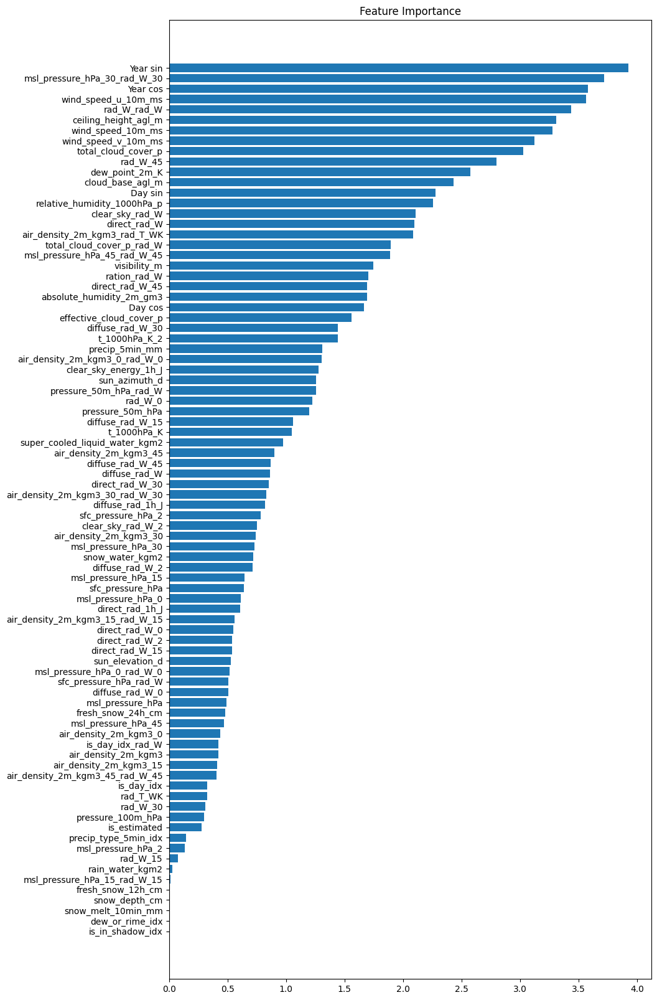

In [ ]:
feature_importance = cb_models[-1].feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(10, 20))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X.columns)[sorted_idx])
plt.title('Feature Importance')


<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

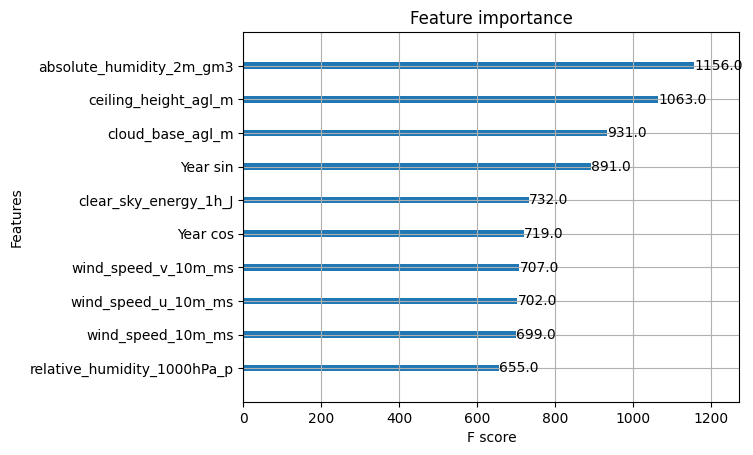

In [ ]:
from xgboost import plot_importance
plot_importance(xgb_models[-1], max_num_features=10)

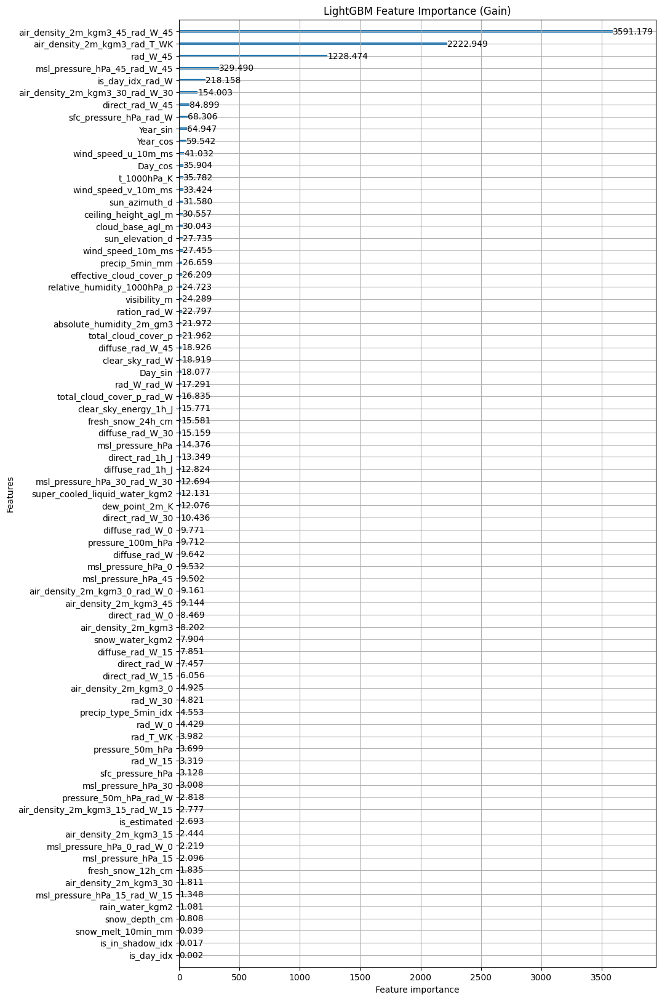

In [ ]:
# Plot feature importance using Gain
lgb.plot_importance(lgbm_models[-1], importance_type="gain", figsize=(10,20), title="LightGBM Feature Importance (Gain)")
plt.show()


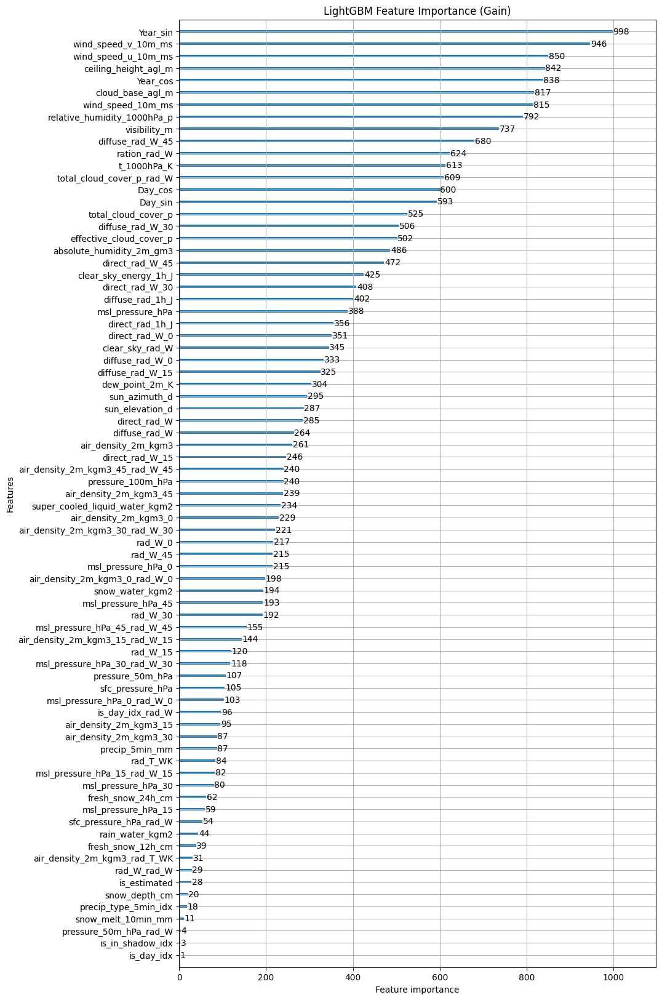

In [ ]:
# Plot feature importance using Gain
lgb.plot_importance(lgbm_models[-1], importance_type="split", figsize=(10,20), title="LightGBM Feature Importance (Gain)")
plt.show()



3.   **Trying to predict again the highest values by re training the models on the non null values of the pv_measurement :**



In [ ]:
dates_to_re_test = []
for date in df_pred_a_cb.index :
  if df_pred_a_cb.loc[date].prediction> 10:
    dates_to_re_test.append(date)

dates_to_re_train = []
for date in y.index :
  if t(y.loc[date])*max_a> 10:
    dates_to_re_train.append(date)

In [ ]:
# Create a list of CatBoostRegressor models for each combination
cb_models = [cb.CatBoostRegressor(n_estimators=n,
                                  learning_rate=lr,
                                  depth=d,
                                  #l2_leaf_reg=l2,
                                  #subsample=subsample,
                                  loss_function=loss) \
             for n, lr, d, loss in all_param_combinations_cb]

In [ ]:
final_cb_models_high = []
for model in tqdm(cb_models):
  model.fit(X.loc[dates_to_re_train], y.loc[dates_to_re_train], logging_level='Silent')
  final_cb_models_high.append(model)

100%|██████████| 18/18 [23:20<00:00, 77.81s/it]


In [ ]:
final_cb_predictions_high = []
for model in final_cb_models_high :
  final_cb_predictions_high.append(t(model.predict(X_test_estimated_a_nan.loc[dates_to_re_test])) * max_a)

mean_cb_prediction_a_high_values = np.mean(final_cb_predictions_high, axis = 0)

In [ ]:
df_pred_a_cb_high = pd.DataFrame({'prediction' : mean_cb_prediction_a_high_values})
df_pred_a_cb_high.set_index(X_test_estimated_a_nan.loc[dates_to_re_test].index, inplace = True)

In [ ]:
df_pred_a_cb_corrected = df_pred_a_cb.copy()
for date in df_pred_a_cb_high.index:
  df_pred_a_cb_corrected.loc[date].prediction = df_pred_a_cb_high.loc[date].prediction